In [1]:
import sys
import torch
import global_variables as gv
import sys
import numpy as np
import matplotlib.pyplot as plt
import configparser
# from FACTS_Modules.Model import model_factory
from FACTS_Modules.util import string2dtype_array
from FACTS_Modules.TADA import MakeGestScore
from facts_visualizations import single_trial_plots, multi_trial_plots
import os 
import pdb
#import seaborn as sns

from sbi.inference import infer, SNPE, prepare_for_sbi, simulate_for_sbi
from sbi import utils as utils
import pickle
import scipy.io

from scipy.interpolate import interp1d
import re


from FACTS_Modules.TaskSFCLaw import TaskSFCLaw_with_noise, TaskSFCLaw
from FACTS_Modules.AcousticSynthesis import AcousticSynthesis
import numpy as np
import pdb

from FACTS_Modules.LWPR_Model.lwpr import LWPR
from abc import ABC, abstractmethod

from FACTS_Modules import util
from FACTS_Modules import seutil

import pandas as pd
import seaborn as sns
from scipy import stats
import math

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
all_eps = []
all_prediction_errors = []
all_P = []
all_Q = []
all_R = []
all_Pobvs = []
all_formant_with_noise = []

def FACTS(theta):
    ini='DesignC_AUKF_onlinepertdelay_SBI_Al.ini'
    # gFile='GesturalScores/KimetalOnlinepert.G'
    gFile='GesturalScores/KimetalOnlinepert2.G'
    config = configparser.ConfigParser()
    config.read(ini)
    # print('DEBUGG')
    # Replace the parameter value from ini file
    #pdb.set_trace()
    # try:
    if theta.dim() > 1:
#             pdb.set_trace()
        #print(theta.numel())
        config['TaskStateEstimator']['Auditory_sensor_scale_est'] = str(theta[0][0].item())
        config['ArticStateEstimator']['Somato_sensor_scale_est'] = str(theta[0][1].item())
        
        config['TaskStateEstimator']['process_scale'] = str(theta[0][2].item())
        config['ArticStateEstimator']['process_scale'] = str(theta[0][3].item())
        
        config['TaskStateEstimator']['Auditory_delay']  = str(theta[0][4].item())
        config['ArticStateEstimator']['Somato_delay']  = str(theta[0][5].item())
        
        config['Gesture']['Spring_constant'] = str(theta[0][6].item())
        
        config['TaskStateEstimator']['artic_to_task_noise_scale'] = str(theta[0][7].item())
        
        config['ArticSFCLaw']['noise_scale'] = str(theta[0][8].item())
        
        
#         config['TaskSFCLaw']['noise_scale'] = str(theta[0][4].item())
        
        
#         config['TaskStateEstimator']['AUKF_gain_for_pert'] = str(theta[0][2].item())
#         config['TaskStateEstimator']['AUKF_eps_window'] = str(theta[0][3].item())
#         config['TaskStateEstimator']['AUKF_gain_attenuation'] = str(theta[0][7].item())
        
        
#         config['TaskStateEstimator']['covariance_scale'] = str(theta[0][2].item())
#         config['ArticStateEstimator']['covariance_scale'] = str(theta[0][3].item())
        
#         if len(theta) > 4:
#             config['TaskStateEstimator']['artic_to_task_noise_scale'] = str(theta[0][5].item())
            #config['ArticKinematics']['plant_scale'] = str(theta[0][5].item())
        
        
#         config['TaskStateEstimator']['covariance_scale'] = str(theta[0][7].item())
#         config['ArticStateEstimator']['covariance_scale'] = str(theta[0][8].item())
        
#         config['SensoryDelay']['Auditory_delay'] = str(theta[0][4].item())
#         config['SensoryDelay']['Somato_delay'] = str(theta[0][5].item())
        
#         config['TaskStateEstimator']['AUKF_Rmult_for_pert'] = str(theta[0][6].item()) # Let these two be the same based on MS and ablation analysis
#         config['TaskStateEstimator']['AUKF_Qmult_for_pert'] = str(theta[0][6].item()) # Let these two be the same based on MS and ablation analysis
#         config['TaskStateEstimator']['AUKF_Pmult_for_pert'] = str(theta[0][7].item())
        
#         config['SensoryDelay']['Somato_delay'] = str(theta[0][7].item())

#         config['TaskStateEstimator']['AUKF_learning_rate_R'] = str(theta[0][8].item()) # Let these two be the same based on MS and ablation analysis
#         config['TaskStateEstimator']['AUKF_learning_rate_Q'] = str(theta[0][8].item()) # Let these two be the same based on MS and ablation analysis
        
#         config['TaskStateEstimator']['AUKF_learning_rate_P'] = str(theta[0][9].item())

#         config['TaskStateEstimator']['sensory_error_threshold'] = str(theta[0][10].item())
        
        
    else:
        #pdb.set_trace()
        config['TaskStateEstimator']['Auditory_sensor_noise_scale_est'] = str(theta[0].item())
        config['ArticStateEstimator']['Somato_sensor_noise_scale_est'] = str(theta[1].item())
        
        config['TaskStateEstimator']['process_scale'] = str(theta[2].item())
        config['ArticStateEstimator']['process_scale'] = str(theta[3].item())
        
        config['TaskStateEstimator']['Auditory_delay']  = str(theta[4].item())
        config['ArticStateEstimator']['Somato_delay']  = str(theta[5].item())
        
        config['Gesture']['Spring_constant'] = str(theta[6].item())
        
        config['TaskStateEstimator']['artic_to_task_noise_scale'] = str(theta[7].item())
        config['ArticSFCLaw']['noise_scale'] = str(theta[8].item())
        
        
#         config['SensoryNoise']['Auditory_sensor_scale'] = str(theta[3].item())
#         config['SensoryNoise']['Somato_sensor_scale'] = str(theta[4].item())
        
#         config['TaskStateEstimator']['artic_to_task_noise_scale'] = str(theta[3].item())
        
#         config['TaskSFCLaw']['noise_scale'] = str(theta[4].item())
        
        
#         config['TaskStateEstimator']['AUKF_gain_for_pert'] = str(theta[2].item())
#         config['TaskStateEstimator']['AUKF_eps_window'] = str(theta[3].item())
#         config['TaskStateEstimator']['AUKF_gain_attenuation'] = str(theta[7].item())
        
#         config['TaskStateEstimator']['covariance_scale'] = str(theta[2].item())
#         config['ArticStateEstimator']['covariance_scale'] = str(theta[3].item())
        

        
#         if len(theta) > 4:
#             config['TaskStateEstimator']['artic_to_task_noise_scale'] = str(theta[4].item())
            #config['ArticKinematics']['plant_scale'] = str(theta[5].item())

#         config['TaskStateEstimator']['covariance_scale'] = str(theta[7].item())
#         config['ArticStateEstimator']['covariance_scale'] = str(theta[8].item())

#         config['SensoryDelay']['Auditory_delay'] = str(theta[4].item())
#         config['SensoryDelay']['Somato_delay'] = str(theta[5].item())
        
#         config['TaskStateEstimator']['AUKF_Rmult_for_pert'] = str(theta[6].item()) # Let these two be the same based on MS and ablation analysis
#         config['TaskStateEstimator']['AUKF_Qmult_for_pert'] = str(theta[6].item()) # Let these two be the same based on MS and ablation analysis
#         config['TaskStateEstimator']['AUKF_Pmult_for_pert'] = str(theta[7].item())

#         config['TaskStateEstimator']['AUKF_learning_rate_R'] = str(theta[8].item()) # Let these two be the same based on MS and ablation analysis
#         config['TaskStateEstimator']['AUKF_learning_rate_Q'] = str(theta[8].item()) # Let these two be the same based on MS and ablation analysis

#         config['TaskStateEstimator']['AUKF_learning_rate_P'] = str(theta[9].item())

#         config['TaskStateEstimator']['sensory_error_threshold'] = str(theta[10].item())
        

        # Note from Alvince, need to pass this in when est delay != actual delay  
        config['SensoryDelay']['Auditory_delay']  = config['TaskStateEstimator']['Auditory_delay'] 
        config['SensoryDelay']['Somato_delay']  = config['ArticStateEstimator']['Somato_delay'] 

#         config['SensoryDelay']['Auditory_delay']  = '165'
#         config['SensoryDelay']['Somato_delay']  = '165'

        # Note from Alvince, need to pass this in  for TSE    
        #config['TaskStateEstimator']['Auditory_delay']  = config['SensoryDelay']['Auditory_delay'] 
        #config['ArticStateEstimator']['Somato_delay']  = config['SensoryDelay']['Auditory_delay'] 

    # except Exception as e:
    #     print(e)
    #     pdb.set_trace()

    model = model_factory(config)
    #pdb.set_trace()
    if 'MultTrials' in config.sections(): 
        ntrials = int(config['MultTrials']['ntrials'])
        target_noise= float(config['MultTrials']['Target_noise'])
    else: 
        ntrials = 1
        target_noise = 0

    #pdb.set_trace()
    #print(config['ArticStateEstimator']['cc_discount_from_delay'])
    gest_name = gFile.split('/')[-1].split('/')[-1]
    np.random.seed(100)
    k = float(config['Gesture']['Spring_constant'])
    GestScore, ART, ms_frm, last_frm = MakeGestScore(gFile,target_noise, k)
    
    # initialize vectors to monitor position at each timestep
    buffer_size_auditory = int(float(config['SensoryDelay']['Auditory_delay']) / 5)  # default used to be 20
    buffer_size_somato = int(float(config['SensoryDelay']['Somato_delay']) / 5)
    buffer_size_auditory_est = int(float(config['TaskStateEstimator']['Auditory_delay']) / 5) 
    buffer_size_somato_est =  int(float(config['ArticStateEstimator']['Somato_delay']) / 5) 
    buffer_size = max(buffer_size_auditory, buffer_size_somato) #, buffer_size_auditory_est, buffer_size_somato_est)
    
    aud_buffer_info = {}
    somato_buffer_info = {}
    aud_buffer_info['est'] = buffer_size_auditory_est
    aud_buffer_info['actual'] = buffer_size_auditory
    somato_buffer_info['est'] = buffer_size_somato_est
    somato_buffer_info['actual'] = buffer_size_somato
    
    x_tilde_delaywindow = np.full([buffer_size,gv.x_dim*2], np.nan) #a new variable that state estimators will have a partial access to
    a_tilde_delaywindow = np.full([buffer_size,gv.a_dim*2], np.nan) #a new variable that state estimators will have a partial access to


    x_tilde_record = np.full([last_frm+buffer_size,gv.x_dim*2], np.nan) #changed
    somato_record = np.full([last_frm+buffer_size,gv.a_dim*2], np.nan) #changed
    formant_record = np.full([last_frm+buffer_size,3], np.nan) #changed
    a_tilde_record = np.full([last_frm+buffer_size,gv.a_dim*2], np.nan) #changed
    formants_produced_record = np.full([last_frm,3], np.nan)

    x_tilde_record_alltrials = np.empty([ntrials,last_frm+buffer_size,gv.x_dim]) #changed
    somato_record_alltrials = np.full([ntrials,last_frm+buffer_size,gv.a_dim*2], np.nan) #changed
    formant_record_alltrials = np.full([ntrials,last_frm+buffer_size,3], np.nan) #changed
    shift_record_alltrials = np.full([ntrials,last_frm+buffer_size,3], np.nan) #changed
    formants_produced_record_alltrials = np.full([ntrials,last_frm,3], np.nan)

    
    a_tilde_record_alltrials = np.empty([ntrials,last_frm+buffer_size,gv.a_dim])
    a_dot_record_alltrials = np.empty([ntrials,last_frm+buffer_size,gv.a_dim])
    a_dotdot_record_alltrials = np.empty([ntrials,last_frm+buffer_size,gv.a_dim])
    predict_formant_record_alltrials = np.empty([ntrials,last_frm+buffer_size,3])

    #pdb.set_trace()
    #Check if catch trials (no perturbation) are specified in the config file
    if 'CatchTrials' in config.keys():
        catch_trials = string2dtype_array(config['CatchTrials']['catch_trials'], dtype='int')
        catch_types = string2dtype_array(config['CatchTrials']['catch_types'], dtype='int')
        if len(catch_trials) != len(catch_types):
            raise Exception("Catch trial and catch type lengths not matching, please check the config file.")
    else: catch_trials = np.array([])

    #Run FACTS for each trial
    for trial in range(ntrials):
        #print("trial:", trial)
        #Gestural score (task)
        k = float(config['Gesture']['Spring_constant'])
        GestScore, ART, ms_frm, last_frm = MakeGestScore(gFile,target_noise, k=k)         #this is similar with MakeGest in the matlab version

        # initial condition
        x_tilde_delaywindow[0] = string2dtype_array(config['InitialCondition']['x_tilde_init'],'float')
        a_tilde_delaywindow[0] = string2dtype_array(config['InitialCondition']['a_tilde_init'],'float')
        x_tilde_record[0] = string2dtype_array(config['InitialCondition']['x_tilde_init'],'float')
        a_tilde_record[0] = string2dtype_array(config['InitialCondition']['a_tilde_init'],'float')
        a_actual = string2dtype_array(config['InitialCondition']['a_tilde_init'],'float')
        model.artic_sfc_law.reset_prejb() #save the initial artic-to-task model.
        all_adotdot = []
        if trial in catch_trials: catch = catch_types[np.where(catch_trials==trial)[0][0]]
        else: catch = False
        #print("catch:", catch)
        
        for i_frm in range(last_frm): #gotta change this hardcoded number to aud delay later
            #model function runs FACTS by each frame
            x_tilde_delaywindow, a_tilde_delaywindow, a_actual, somato_record, formant_record, adotdot, y_hat, formants_produced = model.run_one_timestep(x_tilde_delaywindow, a_tilde_delaywindow, a_actual, somato_record, formant_record, GestScore, ART, ms_frm, i_frm, trial, catch, aud_buffer_info, somato_buffer_info)
            if (formants_produced == -1).all():
                formants_produced_record[i_frm:] = [-1, -1, -1]
                a_tilde_record[i_frm:] = np.tile(-10000, 12)
                x_tilde_record[i_frm:] = np.tile(-10000, 14)
                break
            else:
                a_tilde_record[i_frm+1] = a_tilde_delaywindow[0,:] #0 is always the most recnet current frame
                x_tilde_record[i_frm+1] = x_tilde_delaywindow[0,:] #0 is always the most recnet current frame
                formants_produced_record[i_frm] = formants_produced 
                all_adotdot.append(adotdot)
            


        # x1_pred = np.array(model.task_state_estimator.all_internal_x1_prediction)
        # plt.plot(range(x1_pred.shape[0]), x1_pred)
        #pdb.set_trace()
        #P_over_time = np.array(model.task_state_estimator.all_P)
        #plt.plot(P_over_time)
        #plt.show()

        predict_formant_record_alltrials[trial,] = y_hat
        formants_produced_record_alltrials[trial,] = formants_produced_record
        
        a_tilde_record_alltrials[trial,] = a_tilde_record[:,0:gv.a_dim]
        #a_dot_record[trial, ] = a_tilde[gv.a_dim:]
        x_tilde_record_alltrials[trial,] = x_tilde_record[:,0:gv.x_dim]
        formant_record_alltrials[trial,] = formant_record
        somato_record_alltrials[trial,] = somato_record
        
        model.task_state_estimator.update(catch)

        plot_trial = False 
        if plot_trial:
            plt.figure()
            single_trial_plots('baseline', 
                                    trial, a_tilde_record_alltrials, 
                                    a_tilde_record_alltrials, formant_record_alltrials, 
                                    predict_formant_record_alltrials, x_tilde_record_alltrials, 
                                    [ini, gFile], formants_produced_record_alltrials)
            #pdb.set_trace() # Test if we can print model.
            plt.figure()
            all_Y = np.array(model.task_state_estimator.all_Y)
            plt.plot(all_Y[:,0,:])
            plt.title('Y from TSE Auditory Prediction')

            plt.figure()
            all_y = np.array(model.task_state_estimator.all_y)
            plt.plot(all_y[:,0])
            plt.title('y from TSE Auditory Prediction')
            plt.show()

            #pdb.set_trace()
            a2t_xtilde = np.array(model.task_state_estimator.artic_to_task_xtilde)
            plt.plot(a2t_xtilde)
            plt.title('artic_to_task_xtilde')
            plt.show()

            plt.figure()
            tse_delay_y = np.array(model.task_state_estimator.all_delay_y)
            plt.plot(tse_delay_y[:,0])
            plt.title('tse_delay_y')
            plt.show()

            plt.figure()
            all_formant_with_noise = np.array(model.task_state_estimator.all_formant_with_noise)
            plt.plot(all_formant_with_noise[:,0])
            plt.title('all_formant_with_noise')
            plt.show()


            plt.figure()
            all_X1 = np.array(model.task_state_estimator.all_X1)
            plt.plot(all_X1[:,:,0])
            plt.title('X1 into TSE Aud Predict')
            plt.show()

            plt.figure()
            all_adotdot = np.array(all_adotdot)
            print(all_adotdot.shape)
            plt.plot(all_adotdot)
            plt.title('adotdot')
            plt.show()

            plt.show()

        #print(f"formant_record_alltrials {formant_record_alltrials}")
        #print(f"formants_produced_record_alltrials {formants_produced_record_alltrials}")
        del x_tilde_record
        del a_tilde_record
        del formant_record
        del somato_record
    #pdb.set_trace()
    return torch.from_numpy( formants_produced_record_alltrials[:,:,0].squeeze() )



def find_between( s, first, last ):
    try:
        start = s.index( first ) + len( first )
        end = s.index( last, start )
        return s[start:end]
    except ValueError:
        return ""


# Model.py runs all major FACTS modules. Modules that are 
# carried out in each time step are listed in the method 
# "run_one_timestep." model_factory builds FACTS based on 
# the model architecture specified in config files. 

# Under "Hierarchical_xdotdot," for example, the task 
# state estimator type is defined as lwpr. 

def model_factory(config):
    if 'ModelArchitecture' in config.keys():
        if config['ModelArchitecture']['architecture'] == 'classic': return Model(config)
        if config['ModelArchitecture']['architecture'] == 'hierarchical': return Hierarchical_Model(config)
        if config['ModelArchitecture']['architecture'] == 'hierarchical_articsfcupdate': return Hierarchical_ArticSFCUpdate_Model(config)
        if config['ModelArchitecture']['architecture'] == 'hierarchical_xdotdot': return Hierarchical_xdotdot(config)
        if config['ModelArchitecture']['architecture'] == 'hierarchical_JacUpdateDebug': return Hierarchical_JacUpdateDebug(config)
    return Model(config)


# parent class
class Model():
    def __init__(self,model_configs):
        self.task_sfc_law = TaskSFCLaw()
#         self.task_sfc_law = TaskSFCLaw_with_noise(model_configs['TaskSFCLaw'])
        self.artic_sfc_law = self.artic_sfc_law_factory(model_configs['ArticSFCLaw'])
        self.artic_kinematics = self.artic_kinematics_factory(model_configs)
        self.acoustic_synthesis = AcousticSynthesis(model_configs['AcousticSynthesis'])
        self.auditory_perturbation = self.auditory_perturbation_factory(model_configs)
        self.sensory_system_noise = self.sensory_system_noise_factory(model_configs)
        self.sensory_system_delay = self.sensory_system_delay_factory(model_configs)
        R_Auditory = self.sensory_system_noise.get_R_Auditory()
        R_Somato = self.sensory_system_noise.get_R_Somato()
        self.artic_state_estimator = self.ase_factory(model_configs,R_Auditory,R_Somato)
        self.task_state_estimator = self.tse_factory(model_configs['TaskStateEstimator'],R_Auditory,R_Somato)
        #self.state_estimator = self._state_estimator_factory(model_configs,R_Auditory,R_Somato)
        
    def run_one_timestep(self, prev_x_tilde, prev_a_tilde, prev_a_actual, GestScore, ART, ms_frm,i_frm, trial, catch):
        xdotdot, PROMACT = self.task_sfc_law.run(prev_x_tilde,GestScore,i_frm)
        adotdot = self.artic_sfc_law.run(xdotdot, prev_a_tilde,ART,i_frm,PROMACT,ms_frm)
        a_actual = self.artic_kinematics.run(prev_a_actual,adotdot,ms_frm)
        formants = self.acoustic_synthesis.run(a_actual)
        formants_shifted = self.auditory_perturbation.run(formants,i_frm,trial,catch)
        formants_noise, a_noise = self.sensory_system_noise.run(formants_shifted,a_actual)
        a_tilde, y_hat = self.artic_state_estimator.run(prev_a_tilde,adotdot,formants_noise,a_noise,ms_frm,i_frm,catch)
        x_tilde = self.task_state_estimator.run(a_tilde)

        return x_tilde, a_tilde, a_actual, formants, formants_noise, adotdot, y_hat
        
    # Factory methods
    def artic_sfc_law_factory(self,configs):
        model_type = configs['model_type']
        #print('Artic SFC Law Model Type: ', model_type)
        if model_type == 'lwpr':
#             from FACTS_Modules.ArticSFCLaw import ArticSFCLaw_LWPR_noupdate
#             artic_sfc_law = ArticSFCLaw_LWPR_noupdate(configs)
            from FACTS_Modules.ArticSFCLaw import ArticSFCLaw_LWPR_noupdate_with_noise
            artic_sfc_law = ArticSFCLaw_LWPR_noupdate_with_noise(configs)
        return artic_sfc_law
    
    def artic_kinematics_factory(self,model_configs):
        if 'ArticKinematics' in model_configs.sections():
            from FACTS_Modules.ArticKinematics import ArticKinematics_Noise
#             pdb.set_trace()
            artic_kinematics = ArticKinematics_Noise(model_configs['ArticKinematics'])
#         else:
#             from FACTS_Modules.ArticKinematics import ArticKinematics
#             artic_kinematics = ArticKinematics()
        return artic_kinematics
    
    def sensory_system_noise_factory(self,model_configs):
        if 'SensoryNoise' in model_configs.sections():
            from FACTS_Modules.SensorySystemNoise import SensorySystemNoise
            sensory_system_noise = SensorySystemNoise(model_configs['SensoryNoise'])
        else:
            from FACTS_Modules.SensorySystemNoise import SensorySystemNoise_None
            sensory_system_noise = SensorySystemNoise_None()
        return sensory_system_noise

    def sensory_system_delay_factory(self,model_configs):
        if 'SensoryDelay' in model_configs.sections():
            from FACTS_Modules.SensorySystemDelay import SensorySystemDelay
            sensory_system_delay = SensorySystemDelay(model_configs['SensoryDelay'])
        return sensory_system_delay
    
    def sensory_system_delay_and_noise_factory(self,model_configs):
        from FACTS_Modules.SensorySystemDelay import SensorySystemDelay
        sensory_system_delay = SensorySystemDelayAndNoise(model_configs['SensorySystem'])
        return sensory_system_delay

    def auditory_perturbation_factory(self,model_configs):
        if 'AudPerturbation' in model_configs.sections():
            from FACTS_Modules.AuditoryPerturbation import AuditoryPerturbation
            auditory_perturbation = AuditoryPerturbation(model_configs['AudPerturbation'])
        else:
            from FACTS_Modules.AuditoryPerturbation import AuditoryPerturbation_None
            auditory_perturbation = AuditoryPerturbation_None()
        return auditory_perturbation
    
    def ase_factory(self,model_configs,R_Auditory,R_Somato):
        if 'ArticStateEstimator' in model_configs.sections():
            model_type = model_configs['ArticStateEstimator']['model_type']
            if model_type == 'lwpr':
                from FACTS_Modules.ArticStateEstimator import ASE_UKF_Classic
                artic_state_estimator = ASE_UKF_Classic(model_configs['ArticStateEstimator'],R_Auditory,R_Somato)
        return artic_state_estimator
    
    def tse_factory(self,tse_configs,R_Auditory,R_Somato):
        model_type = tse_configs['model_type']
        #print('Task State Estimator Model Type: ', model_type)
        if model_type == 'lwpr':
            from FACTS_Modules.TaskStateEstimator import TSE_LWPR_Classic
            task_state_estimator = TSE_LWPR_Classic(tse_configs)
        return task_state_estimator
    
class Hierarchical_Model(Model):
    def ase_factory(self,model_configs,R_Auditory,R_Somato):
        if 'ArticStateEstimator' in model_configs.sections():
            model_type = model_configs['ArticStateEstimator']['model_type']
            if model_type == 'lwpr':   
                artic_state_estimator = ASE_UKF_Hier_NoiseEst(model_configs['ArticStateEstimator'],R_Auditory,R_Somato)             
                # if 'Somato_sensor_scale_est' in model_configs['ArticStateEstimator']:
                #     # from FACTS_Modules.ArticStateEstimator import ASE_UKF_Hier_NoiseEst
                #     artic_state_estimator = ASE_UKF_Hier_NoiseEst(model_configs['ArticStateEstimator'],R_Auditory,R_Somato)
                #     #print('got the right ASE')
                # else:    
                #     # from FACTS_Modules.ArticStateEstimator import ASE_UKF_Hier
                #     artic_state_estimator = ASE_UKF_Hier(model_configs['ArticStateEstimator'],R_Auditory,R_Somato)
        return artic_state_estimator
    
    def tse_factory(self,tse_configs,R_Auditory,R_Somato):
        #print('Inside the tse factory')
        model_type = tse_configs['model_type']
        #print('Task State Estimator Model Type: ', model_type)
        if model_type == 'lwpr':
            from FACTS_Modules.TaskStateEstimator import TSE_LWPR_Hier
            task_state_estimator = TSE_LWPR_Hier(tse_configs,R_Auditory,R_Somato)
        return task_state_estimator
    
    def run_one_timestep(self, prev_x_tilde, prev_a_tilde, prev_a_actual, GestScore, ART, ms_frm,i_frm, trial, catch):
        xdotdot, PROMACT = self.task_sfc_law.run(prev_x_tilde,GestScore,i_frm)
        adotdot = self.artic_sfc_law.run(xdotdot, prev_a_tilde,ART,i_frm,PROMACT,ms_frm)
        a_actual = self.artic_kinematics.run(prev_a_actual,adotdot,ms_frm)
        formants = self.acoustic_synthesis.run(a_actual)
        formants_shifted = self.auditory_perturbation.run(formants,i_frm,trial,catch)
        formants_noise, a_noise = self.sensory_system_noise.run(formants_shifted,a_actual)
        a_tilde, a_hat = self.artic_state_estimator.run(prev_a_tilde,adotdot,a_noise,ms_frm,i_frm,catch)
        x_tilde = self.task_state_estimator.run(a_tilde,formants_noise,i_frm,catch)
        
        if i_frm == 32:
            pdb.set_trace()
        return x_tilde, a_tilde, a_actual, formants, formants_noise, adotdot

        

class Hierarchical_xdotdot(Hierarchical_Model):
    def tse_factory(self,tse_configs,R_Auditory,R_Somato):
        model_type = tse_configs['model_type']
        #print('Task State Estimator Model Type: ', model_type)
        if model_type == 'lwpr':
#             task_state_estimator = TSE_LWPR_Hier_xdotdot(tse_configs,R_Auditory,R_Somato)
            # if 'Auditory_sensor_scale_est' in tse_configs:
            #     # from FACTS_Modules.TaskStateEstimator import TSE_LWPR_Hier_NoiseEst
            task_state_estimator = TSE_LWPR_Hier_NoiseEst(tse_configs,R_Auditory,R_Somato)
            #     #print('got the right TSE')
            # else:  
            #     # from FACTS_Modules.TaskStateEstimator import TSE_LWPR_Hier_xdotdot
            #     task_state_estimator = TSE_LWPR_Hier_xdotdot(tse_configs,R_Auditory,R_Somato)
        return task_state_estimator
     
    def run_one_timestep(self, x_tilde_delaywindow, a_tilde_delaywindow, prev_a_actual, somato_record, formant_record, GestScore, ART, ms_frm,i_frm, trial, catch, aud_buffer_info={}, somato_buffer_info={}):
        #pdb.set_trace()
        xdotdot, PROMACT = self.task_sfc_law.run(x_tilde_delaywindow[0],GestScore,i_frm)
        adotdot = self.artic_sfc_law.run(xdotdot, a_tilde_delaywindow[0],ART,i_frm,PROMACT,ms_frm)
        #print(adotdot)
        if type(adotdot) != np.ndarray and any(np.isnan(adotdot)):
            pdb.set_trace()
            formants_produced = np.array([-1, -1, -1], dtype= np.float32)
            a_actual = [-10000,-10000,-10000]
            y_hat = np.array([-1, -1, -1], dtype= np.float32)
            return x_tilde_delaywindow, a_tilde_delaywindow, a_actual, somato_record, formant_record, adotdot, y_hat, formants_produced

        try:
            a_actual = self.artic_kinematics.run(prev_a_actual,adotdot,ms_frm)
            #print("a_actual",a_actual)
            formants = self.acoustic_synthesis.run(a_actual)
            #print("Maeda output",formants)
            formants_shifted = self.auditory_perturbation.run(formants,i_frm,trial,catch)
            formants_noise, somato_noise = self.sensory_system_noise.run(formants_shifted,a_actual)
            formants_noise, somato_noise, formant_record, somato_record = self.sensory_system_delay.run(ms_frm, i_frm,formants_noise,somato_noise,formant_record,somato_record)
            prev_a_tilde = a_tilde_delaywindow[0]

            #print("x_tilde",x_tilde_record[i_frm])
            #print("x_tilde",x_tilde_record[119])
            a_tilde, a_hat = self.artic_state_estimator.run(a_tilde_delaywindow,adotdot,somato_noise,ms_frm,i_frm,catch, somato_buffer_info)
            #pdb.set_trace()
            #print("i_frm",i_frm)
            #print("atilde",a_tilde)
            x_tilde, y_hat = self.task_state_estimator.run(a_tilde_delaywindow,formants_noise,i_frm,catch,xdotdot, aud_buffer_info)
            #print('y_hat', y_hat)

            #print("form_hat",y_hat_record[i_frm+2])
            #a_tilde_record[i_frm+1] = a_tilde 
            #x_tilde_record[i_frm+1] = x_tilde
    #         if i_frm == 32:
    #             pdb.set_trace()
            a_tilde_delaywindow = np.insert(a_tilde_delaywindow[0:-1,:],0,a_tilde,0) #add the most recent frame to 0 and remove the oldest frame.
            x_tilde_delaywindow = np.insert(x_tilde_delaywindow[0:-1,:],0,x_tilde,0)

            # Check to see if est_delay is greater than actual delay
            est_aud_delay_minus_actual = aud_buffer_info['est'] - aud_buffer_info['actual']
            est_soma_delay_minus_actual = somato_buffer_info['est'] - somato_buffer_info['actual']

            # If est delay is greater than actual delay, fill in the extra np.nans
            if i_frm==0 and est_aud_delay_minus_actual > 0:
                shift = int(est_aud_delay_minus_actual)
                x_tilde_delaywindow = np.vstack([
                    np.tile(x_tilde, (shift, 1)),
                    x_tilde_delaywindow[:-shift, :]
                ])
            if i_frm==0 and est_soma_delay_minus_actual > 0:
                shift = int(est_soma_delay_minus_actual)
                a_tilde_delaywindow = np.vstack([
                    np.tile(a_tilde, (shift, 1)),
                    a_tilde_delaywindow[:-shift, :]
                ])
            #pdb.set_trace()
            #print("estimator end----------------------------------------------------------------------------------------------")

            formants_produced = formants
            return x_tilde_delaywindow, a_tilde_delaywindow, a_actual, somato_record, formant_record, adotdot, y_hat, formants_produced
    
        except Exception as e:
            print(e)
            #pdb.set_trace()
            formants_produced = np.array([-1, -1, -1], dtype= np.float32)
            a_actual = [-10000,-10000,-10000]
            y_hat = np.array([-1, -1, -1], dtype= np.float32)
            return x_tilde_delaywindow, a_tilde_delaywindow, a_actual, somato_record, formant_record, adotdot, y_hat, formants_produced

class TaskStateEstimator(ABC):
    def update(self,catch):
        print('TSE Update not implemented')

class TSEClassicInterface():
    @abstractmethod
    def run(self,a_tilde):
        raise NotImplementedError
        
class TSEHierInterface():
    @abstractmethod
    def run(self,a_tilde,formants):
        raise NotImplementedError
        
class TSE_LWPR(TaskStateEstimator):
    def __init__(self,tse_configs):
        self.Taskmodel = LWPR(tse_configs['Task_model_path'])
        self.Taskmodel.init_lambda = float(tse_configs['lwpr_init_lambda'])
        self.Taskmodel.tau_lambda = float(tse_configs['lwpr_tau_lambda'])
        self.Taskmodel.final_lambda = float(tse_configs['lwpr_final_lambda'])
    
#Task Estimator in Parrell et al. (2019)
#which is a simple transformation of the artic state
class TSE_LWPR_Classic(TSE_LWPR,TSEClassicInterface):
    def __init__(self,tse_configs):
        super().__init__(tse_configs)
    def run(self,a_tilde):
        jac = self.Taskmodel.predict_J(a_tilde[0:gv.a_dim])
        x_tilde = np.append(jac[0],np.matmul(jac[1],a_tilde[gv.a_dim:2*gv.a_dim]))
        #pdb.set_trace()
        #print("xtilde", x_tilde)
        return x_tilde

#Task Estimator that receives auditory feedback
#and uses UKF (or AUKF). However, this task
#estimator does not use the task efference copy (xdotdot)
class TSE_LWPR_Hier(TSE_LWPR,TSEHierInterface):
    def __init__(self,tse_configs,R_Auditory,R_Somato):
        super().__init__(tse_configs)
        self.R = np.diag(R_Auditory)

        #these are the parameters used in the paper simulations, read from config file
        process_scale = float(tse_configs['process_scale'])
        covariance_scale = float(tse_configs['covariance_scale'])
        # prepare class data
        t_step = 1
        tempQ_AA = 1*np.eye(gv.x_dim)*t_step**4; #pos-pos covariance
        tempQ_AADOT = 0*np.eye(gv.x_dim)*t_step**3; #pos-vel covariance
        tempQ_ADOTADOT = 1*np.eye(gv.x_dim)*t_step**2 #vel-vel covariance
        self.Q=1e0*process_scale*np.hstack((np.vstack((tempQ_AA,tempQ_AADOT)),np.vstack((tempQ_AADOT,tempQ_ADOTADOT))))# process noise covariance, scaled by plant noise scale factor
        self.feedbackType = tse_configs['feedback_type']

        # create state covariance matrix P
        self.P = covariance_scale*np.eye(gv.x_dim*2);

        #self.nulltaskmodel = LWPR(tse_configs['Task_model_path']) #3/17/22 change
        #Weights and coefficient
        alpha = 1e-3#1e-3
        beta = -1 #-1#-18.2 #-17.6 # - 166000 # - 166668  #default, tunable
        # alpha=1e-3;                                 %default, tunable
        #alpha=[1e-3 1];                                 %tunable
        #alpha=1e-3
        #% alpha=[1 1];                                 %for 3rd order symmetric
        #ki= 3-(gv.x_dim*2)                                #tunable
        ki= -11#-11                              #default, tunable        
        lam=(alpha**2)*((gv.x_dim*2)+ki)-(gv.x_dim*2)                    #scaling factor
        c=(gv.x_dim*2)+lam                                 #scaling factor
        self.Wm=np.append(lam/c,np.zeros(2*(gv.x_dim*2))+0.5/c)           #weights for means
        #Wm=np.array([lam/c 0.5/c+np.zeros(2*L)])           #weights for means
        #Wm=np.array([lam/c 0.5/c+np.zeros(2*L)])           #weights for means
        self.Wc=self.Wm
        self.Wc[0]=self.Wc[0]+(1-alpha**2+beta)         #weights for covariance        
        self.c=np.sqrt(c)
        
        self.senmem = []
        if tse_configs['learn'] == 'True':
            self.learn = True
        else: 
            self.learn = False
        self.taskmem = []
        self.Aud_model = LWPR(tse_configs['Formant_model_path'])
        self.Aud_model.init_lambda = float(tse_configs['lwpr_init_lambda'])
        self.Aud_model.tau_lambda = float(tse_configs['lwpr_tau_lambda'])
        self.Aud_model.final_lambda = float(tse_configs['lwpr_final_lambda'])

        self.defQ = self.Q
        self.defR = self.R
        self.defP = self.P

        self.APET = float(tse_configs['F1_Prediction_Error_Threshold'])
        
        if tse_configs['AUKF'] == 'True':
            self.AUKF = True
            self.AUKFmultFactor = string2dtype_array(tse_configs['AUKFmultFactor'], 'float32')
        else: 
            self.AUKF = False

        # self.artic_to_task_xtilde = []

    def run(self,a_tilde,formant_noise,i_frm,catch):
        
        jac = self.Taskmodel.predict_J(a_tilde[0:gv.a_dim])
        x_tilde = np.append(jac[0],np.matmul(jac[1],a_tilde[gv.a_dim:2*gv.a_dim]))
        self.artic_to_task_xtilde.append(x_tilde)

        X=seutil.sigmas(x_tilde,self.P,self.c) #sigma points around x tilde
        if type(X) != np.ndarray:
            pdb.set_trace()

        x1,X1,P1,X2 = self.TaskStatePredict(X,self.Wm,self.Wc,gv.x_dim*2,self.Q) #transformation of x_tilde (propagation)

        if self.feedbackType == 'nofeedback' or catch or i_frm < 10:
            x = x1
            self.P = P1
        else:
            Y,y=seutil.TaskAuditoryPrediction(self.Aud_model,X1,self.Wm)
            z = formant_noise
            #print("predict: ", y)
            #print("actual: ", z)
            #Y1 = trnasofrmed deviations, P = transformed covariance
            Y1,self.P = seutil.transformedDevandCov(Y,y,self.Wc,self.R)
            #save sensory error 
            #self.senmem = sensoryerrorsave(y,z,self.senmem,x1,i_frm)

            #StateCorrection and Eq 5 and 6
            DeltaX, DeltaCov = seutil.StateCorrection(X2,self.Wc,Y1,self.P,z,y)
             
            #StateUpdate Eq 7, 
            x = x1 + DeltaX
            # print('internal TSE state estimate ', x1)

            # print(f'i_frm= {i_frm}, DeltaX =  {DeltaX}')
            self.P= P1 - DeltaCov #covariance update

            self.senmem, self.taskmem = seutil.auderror(y,z,self.senmem,x1,self.taskmem,x,a_tilde,self.APET)
            if self.learn: # current version has no online compensation during adapt
                x = x1
                self.P = P1

        x_tilde = x
        #x_hat = x1
        return x_tilde
    
    def TaskStatePredict(self,X,Wm,Wc,n,R):
        #Unscented Transformation for process model
        #Input:
        #        X: sigma points
        #       Wm: weights for mean
        #       Wc: weights for covraiance
        #        n: numer of outputs of f
        #        R: additive covariance
        #        u: motor command
        #Output:
        #        y_tmean: transformed mean.
        #        Y: transformed sampling points
        #        P: transformed covariance
        #       Y1: transformed deviations
        
        L=X.shape[1]
        y_tmean=np.zeros(n)
        Y=np.zeros([n,L])
        Y1 = np.zeros([n,L])
        for k in range(L):
            #jac = Taskmodel.predict_J(X[0:gv.a_dim,k])
            #Y[:,k] = np.append(jac[0],np.matmul(jac[1],X[gv.a_dim:2*gv.a_dim,k]))
            Y[:,k] = X[0:gv.x_dim*2,k] # 1 to 1 relationship, because this is just getting unscented transformation.
            y_tmean=y_tmean+Wm[k]*Y[:,k]
            #print(Wm[k])
            #print(Y[:,k])
            #print(Wm[k]*Y[:,k])
        
        Y1,P = seutil.transformedDevandCov(Y,y_tmean,Wc,R)
        return y_tmean,Y,P,Y1 
        
    def update(self,catch):
        if self.learn and not catch == 2:
            #self.Aud_model = seutil.UpdateAuditoryPrediction(self.Aud_model,self.taskmem,self.senmem)
            self.taskmem, self.Taskmodel = seutil.UpdateTaskPrediction(self.Taskmodel,self.taskmem,self.senmem)
            #print(Taskmodel.predict(np.array([0.0631606,-0.13590163,0.0706008,0.04309455,-0.00238945,0.00098181])))
            #print(len(self.senmem))
            #self.senmem, self.Aud_model = seutil.UpdateSensoryPrediction('audOnly',self.Aud_model,0,self.senmem) 
            #print(self.Aud_model.predict(np.array([15.78746351,14.68617247,18.93449447,17.52760635,29.64618912,14.33349587,13.04996568])))     
        
        self.taskmem = []
        self.senmem = []

#Task Estimator from Kim et al. (in review).
#Receives auditory feedback and uses UKF (or AUKF). 
#This task estimator also receives efference copy (xdotdot)

class TSE_LWPR_Hier_xdotdot(TSE_LWPR_Hier):
    def __init__(self,tse_configs,R_Auditory,R_Somato):
        super().__init__(tse_configs,R_Auditory,R_Somato)
        self.TSP = []
        self.all_internal_x1_prediction = []
        self.all_P = []
        self.all_Y = []
        self.all_y = []
        self.all_X1 = []
        self.artic_to_task_xtilde = []
        self.all_formant_with_noise = []
        self.all_delay_y = []
        self.all_eps = []
        self.compensation_adaptive_frame_on = False
        self.compensation_adaptive_frame_i_frm = 0
        self.compensation_adaptive_decay_frame_i_frm = 0
        

        for i in range(gv.x_dim):
            self.TSP.append(LWPR(tse_configs['TSP_model_path']))
            self.TSP[i].init_lambda = float(tse_configs['lwpr_init_lambda'])
            self.TSP[i].tau_lambda = float(tse_configs['lwpr_tau_lambda'])
            self.TSP[i].final_lambda = float(tse_configs['lwpr_final_lambda'])
            

        #self.Aud_delay = int(float(tse_configs['estimated_auditory_delay']) / 5) #20 #later make this separate setting in the config file
        self.Aud_delay = int(float(tse_configs['Auditory_delay']) / 5) 
        #print(f'self.Aud_delay {self.Aud_delay}')
        self.AUKF_Qmult_for_pert = float(tse_configs['AUKF_Qmult_for_pert'])
        self.AUKF_Pmult_for_pert = float(tse_configs['AUKF_Pmult_for_pert'])
#         self.AUKF_gain_for_pert = float(tse_configs['AUKF_gain_for_pert'])
#         self.AUKF_eps_window = int(float(tse_configs['AUKF_eps_window']))
        self.AUKF_gain_attenuation = float(tse_configs['AUKF_gain_attenuation'])
        self.AUKF_Rmult_for_pert = float(tse_configs['AUKF_Rmult_for_pert'])
        
#         self.learning_rate = float(tse_configs['AUKF_learning_rate'])
        self.learning_rate_Q = float(tse_configs['AUKF_learning_rate_Q'])
        self.learning_rate_P = float(tse_configs['AUKF_learning_rate_P'])
        self.learning_rate_R = float(tse_configs['AUKF_learning_rate_R'])
        self.artic_to_task_noise_scale = float(tse_configs['artic_to_task_noise_scale'])
        self.x_tilde_norm = string2dtype_array(tse_configs['x_tilde_norm'], dtype='float')
        print(f'self.artic_to_task_noise_scale {self.artic_to_task_noise_scale}')
        
        self.sensory_error_threshold = float(tse_configs['sensory_error_threshold'])
        
#         self.AUKF_SCmult_for_pert = float(tse_configs['AUKF_SCmult_for_pert'])
#         self.cc_discount_from_delay = float(tse_configs['cc_discount_from_delay'])
#         self.cc_decay = float(tse_configs['cc_decay'])
#         self.cc_discount_minimum = float(tse_configs['cc_discount_minimum'])
        #should be able to be configured differently from the real sensory delay 

        #self.X2_record = np.full([self.Aud_delay,gv.x_dim*2,29],np.nan)
        #self.P1_record = np.full([self.Aud_delay,gv.x_dim*2,gv.x_dim*2],np.nan)
        self.h_delay = np.zeros(self.Aud_delay)
        self.h_delay[-1] = 1

        self.Y_record = np.full([self.Aud_delay,3,29],np.nan) #last comment 10/27 maybe this is a bad idea
        #better idea may be that estimators also get a_record
        # and that they just simply access a_record[i_frm] if i_frm >10 
        # if so you can use a_record[i_frm-10] to make the prediction 
        # which woiuld line up temporally with the somato feedback
        self.X2_record = np.full([self.Aud_delay,gv.x_dim*2,29],np.nan)
        self.P1_record = np.full([self.Aud_delay,gv.x_dim*2,gv.x_dim*2],np.nan)

        #np.vstack((a,b[None]))
        #the current x_tilde and a_tilde should always be up to date 
        self.y_record = np.full([self.Aud_delay,3],np.nan)
        self.K = None

    def run(self,a_tilde_delaywindow,formant_noise,i_frm,catch,xdotdot, aud_buffer_info):
#         pdb.set_trace()
        a_tilde = a_tilde_delaywindow[0] # most recent frame, since this is an internal estimate process
        jac = self.Taskmodel.predict_J(a_tilde[0:gv.a_dim])
        x_tilde = np.append(jac[0],np.matmul(jac[1],a_tilde[gv.a_dim:2*gv.a_dim]))
        
        #pdb.set_trace()
#         print(f'x_tilde before noise {x_tilde}')
        #x_tilde_noise = 1e0 * self.artic_to_task_noise_scale * np.random.normal(0,1,jac[0].shape) *  self.x_tilde_norm[:jac[0].shape[0]] # include the norm of the x_tilde
#         pdb.set_trace()
        x_tilde_noise = 1e0 * self.artic_to_task_noise_scale * np.random.normal(0,1,x_tilde.shape[0]) *  self.x_tilde_norm[:x_tilde.shape[0]] # include the norm of the x_tilde
        x_tilde_plus_noise = x_tilde.copy()
#         x_tilde_plus_noise[:jac[0].shape[0]] += x_tilde_noise
        x_tilde_plus_noise += x_tilde_noise
        self.artic_to_task_xtilde.append(x_tilde_plus_noise)
        x_tilde = x_tilde_plus_noise
#         print(f'x_tilde after noise {x_tilde}')
#         pdb.set_trace()
        
#         if i_frm == 33:
#             pdb.set_trace()

        #print(x_tilde)
        #print(self.Taskmodel.predict(a_tilde[0:gv.a_dim]))

        X=seutil.sigmas(x_tilde,self.P,self.c) #sigma points around x tilde
        #pdb.set_trace()
        #print(f"sigmas {X}")
        if type(X) != np.ndarray: # Cholesky failed so move on to next trial
            return None, None
        x1,X1,P1,X2 = self.TaskStatePredict(X,self.Wm,self.Wc,gv.x_dim*2,self.Q, xdotdot) #transformation of x_tilde (propagation)
        self.all_X1.append(X1)
        self.all_internal_x1_prediction.append(x1)

        Y,y=seutil.TaskAuditoryPrediction(self.Aud_model,X1,self.Wm)
        self.all_Y.append(Y)
        self.all_y.append(y)
        z = formant_noise 
        self.all_formant_with_noise.append(z) 
        #print("KTRY",self.Aud_model.predict(x_tilde[0:gv.x_dim]))

   
        #self.X2_record = np.vstack((X2[None],self.X2_record[0:-1,:]))
        #self.P1_record = np.vstack((P1[None],self.P1_record[0:-1,:]))
        self.Y_record = np.vstack((Y[None],self.Y_record[0:-1,:]))
        self.y_record = np.vstack((y[None],self.y_record[0:-1,:]))
        #pdb.set_trace()
        
#         if np.isnan(z[0]): #or i_frm <= aud_buffer_info['actual']:
        if i_frm <= aud_buffer_info['actual']:
            #print(f'TSE copying x1 and selfP at i_frm {i_frm}')
            x = x1
            self.P = self.defP
            #y = self.y_record[0,] #Just nan since the prediction was not used, but will be used in the future.
        else:
            #print(f'TSE Kalman on compensation at i_frm {i_frm}')

            #print("predict: ", y)
            #print("actual: ", z)
            #print(self.P)
            #Y1 = trnasofrmed deviations, P = transformed covariance
            #y = self.y_record[i_frm] #Retrieving the prediction made a while ago.
            delay_y = np.matmul(np.transpose(self.h_delay),self.y_record)
            delay_Y = np.tensordot(self.h_delay[:, np.newaxis].T, self.Y_record,axes=[1,0])[0]
            #delay_X2 =  np.tensordot(self.h_delay[:, np.newaxis].T, self.X2_record,axes=[1,0])[0]
            #delay_P1 =  np.tensordot(self.h_delay[:, np.newaxis].T, self.P1_record,axes=[1,0])[0]

            self.all_delay_y.append(delay_y)
            #pdb.set_trace()
            #print(self.R)
            #Y1,self.P = seutil.transformedDevandCov(delay_Y,delay_y,self.Wc,self.R)
            Y1,Pobvs = seutil.transformedDevandCov(delay_Y,delay_y,self.Wc,self.R)
#             self.all_P.append(self.P)
            #Y1,self.P = seutil.transformedDevandCov(self.Y_record[i_frm],y,self.Wc,self.R*4.5)
            #save sensory error 
            #self.senmem = sensoryerrorsave(y,z,self.senmem,x1,i_frm)
            #obscov = self.P
            
            #pdb.set_trace()
            #StateCorrection and Eq 5 and 6
#             DeltaX, DeltaCov = seutil.StateCorrectionForDelay(X2, self.Wc, Y1, self.P, z, delay_y, self.cc_discount_from_delay)
            #DeltaX, DeltaCov, _ = seutil.StateCorrection(X2, self.Wc, Y1, self.P, z, delay_y)
            DeltaX, DeltaCov, _ = seutil.StateCorrection(X2, self.Wc, Y1, Pobvs, z, delay_y)


            # Compare sensory feedback error to predicted sensory feedback
            #sensory_error = abs(y[0]-z[0])
#                 print('sensory_error')
            # adaptive, we need to update self.Q (process noise) and/or self.R (measurement noise)
            # One way of updating self.Q is by matching the covariance to the basis of the model output 
            # residual. So  we could update the TSE process noise (self.Q) based on the difference between 
            # TSE_auditory_prediction and measured auditory signal? What that might look like is when the formant 
            # perturbation starts the difference between TSE and feedback signal is large, so we should weight measurement 
            # more (thus adaptively push Q up -> P1 goes up -> self.P goes up next time step -> sigma point covariance goes
            # up -> stronger weight on measurement). As the system adjusts productions get closer to feedback 
            # ( Q starts to go back down -> P1 goes down -> self.P next time step goes down -> sigma point covariance goes 
            #  down -> weighting adjusts back to internal predictions). Thus we get the more context sensitive formant 
            # slopes.

#             #StateUpdate Eq 7, Maybe comment this because of perm/comp AUKF should adjust 
            x = x1 + DeltaX
            self.P= P1 - DeltaCov#covariance update
            
            #test_Delta_Cov.append(DeltaX)
            #test_Delta_X.append(DeltaCov)
            # Now do the AUKF for perturbation Alvince 2024
            prediction_error = z - delay_y
            eps = np.matmul(np.matmul(np.transpose(prediction_error),np.linalg.inv(Pobvs)),prediction_error)
#             print(eps)
#             sensory_error_threshold = 500# Units are Hz
            sensory_error_threshold = self.sensory_error_threshold
            self.all_eps.append(eps)
            all_eps.append(eps)
            all_prediction_errors.append(prediction_error)


            #StateUpdate Eq 7, Maybe comment this because of perm/comp AUKF should adjust 
#             pdb.set_trace()
#             all_P.append(self.P)
        
#             x = x1 + (DeltaX) # Testing a fractin of Deltas to imitate inertia
#             self.P = P1 - (DeltaCov)#covariance update
            
            
        x_tilde = x
        
        return x_tilde, z, 
        
    def TaskStatePredict(self,X,Wm,Wc,n,R,u):
        #Unscented Transformation for process model
        #Input:
        #        X: sigma points
        #       Wm: weights for mean
        #       Wc: weights for covraiance
        #        n: numer of outputs of f
        #        R: additive covariance
        #        u: motor command
        #Output:
        #        y_tmean: transformed mean.
        #        Y: transformed sampling points
        #        P: transformed covariance
        #       Y1: transformed deviations
        
        L=X.shape[1]
        y_tmean=np.zeros(n)
        Y=np.zeros([n,L])
        Y1 = np.zeros([n,L])
        temp = np.zeros([gv.x_dim,2])
        for k in range(L): 
            #sol2 = solve_ivp(fun=lambda t, y: ode45_dim6(t, y, u), t_span=[0, ms_frm/1000], y0=X[:,k], method='RK45', dense_output=True, rtol=1e-13, atol=1e-22)     
            for z in range(gv.x_dim):
                temp[z,0:2] = self.TSP[z].predict(np.array([X[z,k],X[z+gv.x_dim,k],u[z]]))
                Y[z,k] = temp[z,0]
                #temp[z,0:2] = TSPmodel[0].predict(np.array([X[z,k],X[z+gv.x_dim,k],u[z]]))
                Y[z+gv.x_dim,k] = temp[z,1]
    
    
            y_tmean=y_tmean+Wm[k]*Y[:,k]
            #print(Wm[k])
            #print(Y[:,k])
            #print(Wm[k]*Y[:,k])
            
        Y1,P = seutil.transformedDevandCov(Y,y_tmean,Wc,R)
        return y_tmean,Y,P,Y1

class TSE_LWPR_Hier_NoiseEst(TSE_LWPR_Hier_xdotdot):
    def __init__(self,tse_configs,R_Auditory,R_Somato):
        super().__init__(tse_configs,R_Auditory,R_Somato)
        
        Auditory_sensor_scale_est = float(tse_configs['Auditory_sensor_scale_est'])
        nAuditory = int(tse_configs['nAuditory'])
        norms_Auditory = util.string2dtype_array(tse_configs['norms_Auditory'], float)
        norms_AADOT = util.string2dtype_array(tse_configs['norms_AADOT'], float)

        R_Auditory_est = 1e0*Auditory_sensor_scale_est*np.ones(nAuditory)*norms_Auditory
        self.R = np.diag(R_Auditory_est)
        self.defR = self.R

class ASEClassicInterface:
    @abstractmethod
    def run(self, a_tilde,adotdot,formants,a_noise,ms_frm,i_frm,catch):
        raise NotImplementedError
class ASEHierInterface:
    @abstractmethod
    def run(self,a_tilde,adotdot,a_noise,ms_frm,i_frm,catch):
        raise NotImplementedError

class ArticStateEstimator(ABC):
    def update(self):
        print('ASE Update not implemented')

class ASE_Pass(ArticStateEstimator):
    def run(self, a_tilde,adotdot,formants,a_noise,ms_frm,i_frm,catch):
        a_tilde = a_noise
        a_hat = np.zeros(gv.a_dim*2)
        return a_tilde, a_hat
    
class ASE_Pass_Classic(ASE_Pass,ASEClassicInterface):
    def run(self, a_tilde,adotdot,formants,a_noise,ms_frm,i_frm,catch):
        return super().run(a_tilde,adotdot,formants,a_noise,ms_frm,i_frm,catch)
        
class ASE_Pass_Hier(ASE_Pass,ASEHierInterface):
    def run(self,a_tilde,adotdot,a_noise,ms_frm,i_frm,catch):
        formants = [1000,2000,4000]
        a_tilde, a_hat = super().run(a_tilde,adotdot,formants,a_noise,ms_frm,i_frm,catch)
        return a_tilde
    
class ASE_UKF(ArticStateEstimator):
    def __init__(self,articstateest_configs,R_Auditory,R_Somato):
        #these are the parameters used in the paper simulations, read from config file
        process_scale = float(articstateest_configs['process_scale'])
        covariance_scale = float(articstateest_configs['covariance_scale'])
        # prepare class data
        t_step = 1
        tempQ_AA = 1*np.eye(gv.a_dim)*t_step**4; #pos-pos covariance
        tempQ_AADOT = 0*np.eye(gv.a_dim)*t_step**3; #pos-vel covariance
        tempQ_ADOTADOT = 1*np.eye(gv.a_dim)*t_step**2 #vel-vel covariance
        self.Q=1e0*process_scale*np.hstack((np.vstack((tempQ_AA,tempQ_AADOT)),np.vstack((tempQ_AADOT,tempQ_ADOTADOT))))# process noise covariance, scaled by plant noise scale factor
        
        self.feedbackType = articstateest_configs['feedback_type']
        
        # create state covariance matrix P
        self.P = covariance_scale*np.eye(2*gv.a_dim);

        self.ASP = []
        for i in range(gv.a_dim):
            self.ASP.append(LWPR(articstateest_configs['ASP_model_path']))
            self.ASP[i].init_lambda = 0.985
            self.ASP[i].tau_lambda = 0.995
            self.ASP[i].final_lambda =0.99995
        self.Som_model = []
        for i in range(gv.a_dim*2):
            self.Som_model.append(LWPR(articstateest_configs['Somato_model_path']))
     
        #Weights and coefficient
        alpha = 1e-3#1e-3
        beta = -1#-18.2 #-17.6 # - 166000 # - 166668  #default, tunable
        # alpha=1e-3;                                 %default, tunable
        #alpha=[1e-3 1];                                 %tunable
        #alpha=1e-3
        #% alpha=[1 1];                                 %for 3rd order symmetric
        ki= 3-(gv.a_dim*2)                                #tunable
        #ki=0                                       #default, tunable        
        lam=(alpha**2)*((gv.a_dim*2)+ki)-(gv.a_dim*2)                    #scaling factor
        c=(gv.a_dim*2)+lam                                 #scaling factor
        self.Wm=np.append(lam/c,np.zeros(2*(gv.a_dim*2))+0.5/c)           #weights for means
        self.Wc=self.Wm
        self.Wc[0]=self.Wc[0]+(1-alpha**2+beta)         #weights for covariance
        #print(self.Wc)
        self.c=np.sqrt(c)
        self.senmem = []
        if articstateest_configs['learn'] == 'True':
            self.learn = True
        else: 
            self.learn = False
        self.atildemem = []
        self.defP = self.P

class ASE_UKF_Classic(ASE_UKF,ASEClassicInterface): 
    def __init__(self,articstateest_configs,R_Auditory,R_Somato):
        super().__init__(articstateest_configs,R_Auditory,R_Somato)
        # Load LWPRformant
        self.Aud_model = LWPR(articstateest_configs['Formant_model_path'])
        self.Aud_model_null = LWPR(articstateest_configs['Formant_model_path'])
        self.Aud_model.init_lambda = 0.985
        self.Aud_model.tau_lambda = 0.995
        self.Aud_model.final_lambda =0.99995
        # compute R (measurement noise covariance matrix)
        if self.feedbackType == 'full':
            self.R = np.diag(np.append(R_Auditory,R_Somato))
        elif self.feedbackType == 'audOnly':
            self.R = np.diag(R_Auditory)
        elif self.feedbackType == 'somatOnly':
            self.R = np.diag(R_Somato)
        else:
            self.R = None

        self.Design = articstateest_configs['Design']
        self.APET = float(articstateest_configs['F1_Prediction_Error_Threshold'])

    def run(self, a_tilde,adotdot,formant_noise,a_noise,ms_frm,i_frm,catch):
        # UKF   Unscented Kalman Filter for nonlinear dynamic systems
        # [x, P] = ukf(f,x,u,P,h,z,Q,R) returns state estimate, x and state covariance, P 
        # for nonlinear dynamic system (for simplicity, noises are assumed as additive):
        #           x_k+1 = f(x_k) + w_k
        #           z_k   = h(x_k) + v_k
        # where w ~ N(0,Q) meaning w is gaussian noise with covariance Q
        #       v ~ N(0,R) meaning v is gaussian noise with covariance R
        # Inputs:   f: LWPR model for predicting x
        #           x: "a priori" state estimate 
        #           u: motor command (adotdot)
        #           P: "a priori" estimated state covariance
        #           h: LWPR model for predicting z
        #           z: current measurement
        #           Q: process noise covariance 
        #           R: measurement noise covariance
        # Output:   x: "a posteriori" state estimate
        #           P: "a posteriori" state covariance

        # The original source code came from 
        # Yi Cao (2022). Learning the Unscented Kalman Filter 
        # (https://www.mathworks.com/matlabcentral/fileexchange/18217-learning-the-unscented-kalman-filter)
        # MATLAB Central File Exchange. Retrieved October 26, 2021.
        # Copyright (c) 2009, Yi Cao All rights reserved.

        x = a_tilde
        u = adotdot
        #print("atilde",a_tilde)
        #print("adotdot",adotdot)
        X=seutil.sigmas(x,self.P,self.c) #sigma points around x
        #x1,X1,P1,X2=seutil.ArticStatePredict(X,self.Wm,self.Wc,gv.a_dim*2,self.Q,u,ms_frm) #Articulatory State Prediction: unscented transformation of process
        x1,X1,P1,X2=seutil.ArticStatePredict_LWPR(X,self.Wm,self.Wc,gv.a_dim*2,self.Q,u,ms_frm,self.ASP)
        #print('ivp atilde: ', x1)
        #print('lwpr atilde: ', a1)
        #print('prev atilde: ', x)
        #print('adotdot: ', u)
        #Sensory Prediction: Y = transformed sample signma points, y = predicted sensory feedback 
        if self.feedbackType == 'nofeedback' or i_frm < 10:
            self.P = P1
            y=np.zeros(3)
        else:
            if self.feedbackType == 'somatOnly':
                #L=X1.shape[1]
                y=np.zeros(1)
                Y=np.zeros([1,X1.shape[1]])
                Y,y=seutil.SomatosensoryPrediction(self.feedbackType,Y,y,X1,self.Wm)
                z = a_noise

            elif self.feedbackType == 'audOnly':
                Y,y=seutil.AuditoryPrediction(self.Aud_model,X1,self.Wm)
                z = formant_noise

            else: #full
                Y,y=seutil.AuditoryPrediction(self.Aud_model,X1,self.Wm)
                #K,k=seutil.AuditoryPrediction(self.Aud_model_null,X1,self.Wm)

                Y,y=seutil.SomatosensoryPrediction(self.feedbackType,self.Som_model,Y,y,X1,self.Wm)
                z = np.append(formant_noise,a_noise)
                #print("predict", y[0:3])
                #print("actual", z[0:3])
                
                #print("null", k[0:3])

            #Y1 = trnasofrmed deviations, P = transformed covariance
            Y1,self.P = seutil.transformedDevandCov(Y,y,self.Wc,self.R)
            #print(self.R)
            #save sensory error 
            #self.senmem = sensoryerrorsave(y,z,self.senmem,x1,i_frm)

            #StateCorrection and Eq 5 and 6
            DeltaX, DeltaCov = seutil.StateCorrection(X2,self.Wc,Y1,self.P,z,y)
            #StateUpdate Eq 7, 
            x = x1 + DeltaX 
            #print("x1:",x1)
            #print("org:",a_tilde)
            self.senmem, self.atildemem = seutil.sensoryerrorandatildesave(y,z,self.senmem,x1,i_frm,u,x,a_tilde,self.atildemem,self.APET)
            #x1= predicted state, deltaX= state update from sensoryprediction
            self.P= P1 - DeltaCov #covariance update
            if self.learn:
                x = x1
                self.P = self.defP
        a_tilde = x
        #a_hat = x1
        return a_tilde, y[0:3]
        
    def update(self):
        if self.learn:
            if self.Design == 'A':
                self.ASP = seutil.UpdateArticStatePrediction(self.ASP,self.atildemem)
            elif self.Design == 'B':
                self.senmem, self.Aud_model = seutil.UpdateSensoryPrediction(self.feedbackType,self.Aud_model,self.Som_model,self.senmem)
            self.atildemem = []
            self.senmem = []

class ASE_UKF_Hier(ASE_UKF,ASEHierInterface):
    def __init__(self,articstateest_configs,R_Auditory,R_Somato):
        super().__init__(articstateest_configs,R_Auditory,R_Somato)
        # compute R (measurement noise covariance matrix)
        self.R = np.diag(R_Somato)
        self.Somat_delay = int(float(articstateest_configs['Somato_delay']) / 5) #10 #later make this separate setting in the config file
        self.defP = self.P
        self.X2_record = np.full([self.Somat_delay,gv.a_dim*2,25],np.nan)
        self.P1_record = np.full([self.Somat_delay,gv.a_dim*2,gv.a_dim*2],np.nan)
    
        #should be able to be configured differently from the real sensory delay 
        self.Y_record = np.full([self.Somat_delay,gv.a_dim*2,25],np.nan) #last comment 10/27 maybe this is a bad idea
        #better idea may be that estimators also get a_record
        # and that they just simply access a_record[i_frm] if i_frm >10 
        # if so you can use a_record[i_frm-10] to make the prediction 
        # which woiuld line up temporally with the somato feedback

        self.h_delay = np.zeros(self.Somat_delay)
        self.h_delay[-1] = 1

        #np.vstack((a,b[None]))
        #the current x_tilde and a_tilde should always be up to date 
        self.y_record = np.full([self.Somat_delay,gv.a_dim*2],np.nan)
#         pdb.set_trace()


    def run(self,a_tilde_delaywindow,adotdot,a_noise,ms_frm,i_frm,catch, somat_delay_info):
        x = a_tilde_delaywindow[0] # most recent frame, since this is an internal estimate process
        u = adotdot
        X=seutil.sigmas(x,self.P,self.c) #sigma points around x which are x (1) + x-A (12) and x+A (12) = 25. In other words, 2n + 1 when n = 12. 
        #x1,X1,P1,X2=ArticStatePredict(X,self.Wm,self.Wc,gv.a_dim*2,self.Q,u,ms_frm) #Articulatory State Prediction: unscented transformation of process
        x1,X1,P1,X2=seutil.ArticStatePredict_LWPR(X,self.Wm,self.Wc,gv.a_dim*2,self.Q,u,ms_frm,self.ASP)
        
        y=np.zeros(1)
        Y=np.zeros([1,X1.shape[1]])
        Y,y=seutil.SomatosensoryPrediction(self.feedbackType,self.Som_model,Y,y,X1,self.Wm)
        z = a_noise
        
        self.X2_record = np.vstack((X2[None],self.X2_record[0:-1,:]))
        self.P1_record = np.vstack((P1[None],self.P1_record[0:-1,:]))
        self.Y_record = np.vstack((Y[None],self.Y_record[0:-1,:]))
        self.y_record = np.vstack((y[None],self.y_record[0:-1,:]))



        #then recursively enter run_recalc ...
        
        #a_tilde_delaywindow already has prev frame so it's good
        #then we need u_record
        #past self.P can be loaded from self.P1_record
        #self.c is constant

        #but a_tilde has to come from its recalc..


        #print("CHECK2",self.Y_record.shape)
        #print("ynone",y[None])
        #print("Y_10",self.Y_record[9,])
        #print("y_record_delayed",np.matmul(np.transpose(self.h_delay),self.y_record))
#         if np.isnan(z[0]): # or i_frm <= somat_delay_info['est']:
        if i_frm <= somat_delay_info['actual']:
            #print(f'ASE copying x1 and selfP at i_frm {i_frm}')
            x = x1
            self.P = self.defP
        else: 
            #print(f'ASE Kalman predict vs actual {i_frm}')
#             print(i_frm)
            #print(self.y_record[i_frm])
#             print(self.y_record[10])
            #print(z)
            #3/31 things to do
            # now create a delay matrix h to reaplce self.Y_record[ifrm]
            delay_y = np.matmul(np.transpose(self.h_delay),self.y_record)
            # I could also apply a similar mechanism for z... perhaps in the other module (delay)
            # the nwe have two separate delay matrices.. one for estimator and one for observation

            #C=B[:, np.newaxis].T
            #np.tensordot(C,A,axes=[1,0])
            #print(np.transpose(self.h_delay[:, np.newaxis]))
            #print("delayY_record", np.tensordot(self.h_delay[:, np.newaxis].T, self.Y_record,axes=[1,0]))
            delay_Y = np.tensordot(self.h_delay[:, np.newaxis].T, self.Y_record,axes=[1,0])[0]
            delay_X2 =  np.tensordot(self.h_delay[:, np.newaxis].T, self.X2_record,axes=[1,0])[0]
            delay_P1 =  np.tensordot(self.h_delay[:, np.newaxis].T, self.P1_record,axes=[1,0])[0]

            #print("dY",delay_y)
            #print("Yrecord",self.y_record[-1])
            #print(delay_Y.shape)
            #Y1 = trnasofrmed deviations, P = transformed covariance
            #Y1,self.P = seutil.transformedDevandCov(self.Y_record[9,],delay_y,self.Wc,self.R*2)
            Y1,self.P = seutil.transformedDevandCov(delay_Y,delay_y,self.Wc,self.R*2)
            #save sensory error 
            #self.senmem = sensoryerrorsave(y,z,self.senmem,x1,i_frm)

            #StateCorrection and Eq 5 and 6
            #DeltaX, DeltaCov = seutil.StateCorrection(self.X2_record[i_frm,],self.Wc,Y1,self.P,z,delay_y)
            DeltaX, DeltaCov, _ = seutil.StateCorrection(delay_X2,self.Wc,Y1,self.P,z,delay_y)

            #StateUpdate Eq 7,
            x = x1 + DeltaX
            #self.P= self.P1_record[i_frm] - DeltaCov #This is up to debate.. P1 from past or P1 from present?
            self.P= delay_P1 - DeltaCov # I am leaning towards present because x1 is present anyway

        if self.learn:
            x = x1
            self.P = self.defP
        
        a_tilde = x
        
        a_hat = x1
#         if i_frm==32 or i_frm==33:
#             pdb.set_trace()
        return a_tilde, a_hat

class ASE_UKF_Hier_NoiseEst(ASE_UKF_Hier, ASEHierInterface):
    def __init__(self,articstateest_configs,R_Auditory,R_Somato):
        super().__init__(articstateest_configs,R_Auditory,R_Somato)

        Somato_sensor_scale_est = float(articstateest_configs['Somato_sensor_scale_est'])
        norms_AADOT =  util.string2dtype_array(articstateest_configs['norms_AADOT'], float)
        R_Somato_est = 1e0*Somato_sensor_scale_est*np.ones(gv.a_dim*2)*norms_AADOT
        #print(R_Somato_est)
        self.R = np.diag(R_Somato_est)

## Test that FACTS works

In [3]:
#         config['TaskStateEstimator']['Auditory_sensor_scale_est'] = str(theta[0][0].item())
#         config['ArticStateEstimator']['Somato_sensor_scale_est'] = str(theta[0][1].item())
        
#         config['TaskStateEstimator']['process_scale'] = str(theta[0][2].item())
#         config['ArticStateEstimator']['process_scale'] = str(theta[0][3].item())
        
#         config['TaskStateEstimator']['Auditory_delay']  = str(theta[0][4].item())
#         config['ArticStateEstimator']['Somato_delay']  = str(theta[0][5].item())
        
#         config['Gesture']['Spring_constant'] = str(theta[0][6].item())
        
#         config['TaskStateEstimator']['artic_to_task_noise_scale'] = str(theta[0][7].item())
        
#         config['ArticSFCLaw']['noise_scale'] = str(theta[0][8].item())

labels = ['Aud Noise Scale Est', 
          'Somato Noise Scale Est', 
          'TSE Process Scale', 
          'ASE Process Scale', 
          'Aud delay',
          'Somato delay',
          'Spring constant',
          'ArticToTask Noise Scale',
          'ArticSFCLaw Noise Scale',
]

# labels2 = [r'$\lambda_{\mathrm{R\_aud}}$', 
#            r'$\lambda_{\mathrm{R\_som}}$', 
#            r'$\lambda_{\mathrm{Q\_aud}}$', 
#            r'$\lambda_{\mathrm{Q\_som}}$', 
#            r'$\tau_{\mathrm{aud}}$',
#            r'$\tau_{\mathrm{som}}$',
#            r'$K_{\mathrm{TSFCL}}$',
#            r'$\eta_{\mathrm{artic\_to\_task}}$',
#            r'$\eta_{\mathrm{ASFLC}}$',
          
# ]

labels2 = [r'$\mathbf{\lambda_{\mathrm{R_T}}}$', 
           r'$\mathbf{\lambda_{\mathrm{R_A}}}$', 
           r'$\mathbf{\lambda_{\mathrm{Q_T}}}$', 
           r'$\mathbf{\lambda_{\mathrm{Q_A}}}$', 
           r'$\mathbf{\tau_{\mathrm{T}}}$',
           r'$\mathbf{\tau_{\mathrm{A}}}$',
           r'$\mathbf{S_{\mathrm{T}}}$',
           r'$\mathbf{\lambda_{\mathrm{A-T}}}$',
           r'$\mathbf{\lambda_{\mathrm{A}}}$',
          
]


label_dict = dict(zip(labels, labels2))


In [4]:
# prior_min= [  1e-8,  1e-8, 1e-8, 1e-8, 100,  100, 3,   0, 0   ]
# prior_mmax = [ 5e-2,  1e-5, 5e-2, 1e-5, 200, 200, 8, 0.1, 0.1 ]

# prior_min = [1e-08, 1e-8, 1e-8, 1e-8, 100, 100, 3, 0, 0]
# prior_mmax = [   3, 1e-4,  0.05, 1e-4, 240, 240, 10, 1e5, 10]
 
# prior_min = [  1e-08, 1e-8,  1e-8, 1e-8, 100, 100,  3,  0,  0]
# prior_mmax = [   1e2,  1e2,  0.05, 1e-4, 240, 240, 10, 0.5, 5500]

prior_min = [  1e-8, 1e-8,  1e-8, 1e-8, 100, 100,  3,  0,  0]
prior_mmax = [   20, 20,  0.05, 1e-4, 240, 240, 10, 0.20, 1000]

In [5]:
# if 'healthy_mean_synth' in locals():
# #     x_time2 = np.(0,500, num=100)
#     plt.plot(healthy_mean_synth[40:140], 'b',label='Healthy Controls')
#     plt.plot(cereb_mean_synth[40:140], 'orange',label='Cereb')
# #     plt.fill_between(x_time2, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='blue', alpha=.1)
    
# # test_theta = torch.from_numpy(np.array([0.005, 0.005, 0.01, 0.05, 0.0000001, 0.0000001, 165, 165, 0.5, 0.5, 0.5, 1.009, 1.009,1.009, 5000]))

# # test_theta = torch.from_numpy(np.array([0.009, 0.05, 0.33, 1e-6, 165, 165, 500, 5, 1.01, 1.2, 100]))
# # test_theta = torch.from_numpy(np.array([0.009, 0.01, 0.01, 0.01, 0.01, 8.0, 150]))
# #
# # test_theta = torch.from_numpy(np.array([0.0055, 0.01, 0.06, 0.06, 0.06, 1, 5, 10]))
# # test_theta = torch.from_numpy(np.array([0.0055, 0.01, 1, 1]))
# # for k in [0.1, 1, 1.2, 1.5, 3,5]:
# # test_theta = torch.from_numpy(np.array([1e-2, 0.01, 3.9, 0.01, 0.01, 0.01]))

# # test_theta = torch.from_numpy(np.array([4e-3, 1e-2, 1e-2 , 1e-4, .03, .01]))
# for jj in range(10):
#     test_theta = torch.from_numpy(np.array([4e-3, 1e-2, 1e-2 , 1e-4, 165, 165, 3.9, .01, 0.088]))

#     # test_theta = best_HC_theta
#     # test_theta = best_theta
#     # print(test_theta)
#     # test_theta =  torch.from_numpy(np.append(test_theta, 10))
#     # print(test_theta)

#     simulated_test = FACTS(test_theta)
#     x_time = np.linspace(0,500, num=140)
#     # plt.plot(x_time, simulated_test)
#     # plt.plot(simulated_test[40:], color='k')
# #     plt.plot(simulated_test, color='k', label=f'{jj}' )
#     plt.plot(simulated_test, label=f'{jj}' )
 

# plt.title(f'Formant trajectory based on k')
# plt.legend
# plt.show()

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01


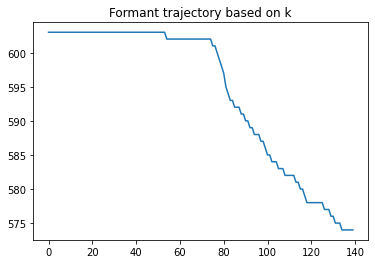

In [6]:
if 'healthy_mean_synth' in locals():
    pass
#     x_time2 = np.(0,500, num=100)
#     plt.plot(healthy_mean_synth[40:140], 'b',label='Healthy Controls')
#     plt.plot(cereb_mean_synth[40:140], 'orange',label='Cereb')
#     plt.fill_between(x_time2, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='blue', alpha=.1)
    
# test_theta = torch.from_numpy(np.array([0.005, 0.005, 0.01, 0.05, 0.0000001, 0.0000001, 165, 165, 0.5, 0.5, 0.5, 1.009, 1.009,1.009, 5000]))

# test_theta = torch.from_numpy(np.array([0.009, 0.05, 0.33, 1e-6, 165, 165, 500, 5, 1.01, 1.2, 100]))
# test_theta = torch.from_numpy(np.array([0.009, 0.01, 0.01, 0.01, 0.01, 8.0, 150]))
#
# test_theta = torch.from_numpy(np.array([0.0055, 0.01, 0.06, 0.06, 0.06, 1, 5, 10]))
# test_theta = torch.from_numpy(np.array([0.0055, 0.01, 1, 1]))
# for k in [0.1, 1, 1.2, 1.5, 3,5]:
# test_theta = torch.from_numpy(np.array([1e-2, 0.01, 3.9, 0.01, 0.01, 0.01]))

# test_theta = torch.from_numpy(np.array([4e-3, 1e-2, 1e-2 , 1e-4, .03, .01]))
# for jj in [ 1e3, 1e4, 1e5]:
for jj in [1]:
#     test_theta = torch.from_numpy(np.array([4e-3, 1e-1, 1e-2 , 1e-4, 165, 165, 3.9, 0.01, 0.1]))
    test_theta = torch.from_numpy(np.array([300, 100, 1e-2 , 1e-3, 165, 165, 3.9, 0.01, 0.1]))

    # test_theta = best_HC_theta
    # test_theta = best_theta
    # print(test_theta)
    # test_theta =  torch.from_numpy(np.append(test_theta, 10))
    # print(test_theta)

    simulated_test = FACTS(test_theta)
    x_time = np.linspace(0,500, num=140)
    # plt.plot(x_time, simulated_test)
    # plt.plot(simulated_test[40:], color='k')
#     plt.plot(simulated_test, color='k', label=f'{jj}' )
    plt.plot(simulated_test, label=f'{jj}' )
 

plt.title(f'Formant trajectory based on k')
plt.legend
plt.show()


### Run an example trial, or do a parameter sweep

#### 0 Auditory noise scale:

Low: 0.0001

High: 0.04


#### 1 Somatosensory noise scale:

Low: .002

High: 1


#### 2 TSE Process Scale:

Low: 0.0001

High: 5


#### 3 TSE Covariance Scale:

Low: 0.0000001

High: 5

#### 4 ASE Process Scale:

Low: 10e-12

High: 10e-6


#### 5 ASE Covariance Scale:

Low: 10e-12

High: 10e-4


#### 6 SensoryDelay Auditory Delay:

Low: 20

High: 105

#### x7 SensoryDelay Somato Delay:

Low: 45

High: 105

#### x8 TSE estimated_auditory_delay:

Low: 10 

High: 105

#### x9 ASE estimated_somat_delay

Low: 10 

High: 30

#### 10 cc_discount


### Load Parell's data to see what it looks like

In [7]:
# import observed data
data = scipy.io.loadmat('sbi_resources/parrell_2017/parrell_data.mat')

In [8]:
print(data['parrell_data'].dtype)
print(data['parrell_data']['means'][0,0][0,0][0].shape)
print(data['parrell_data']['stds'][0,0][0,0][0].shape)

[('means', 'O'), ('stds', 'O')]
(1, 171)
(1, 171)


### Print some of these data to see what it looks like

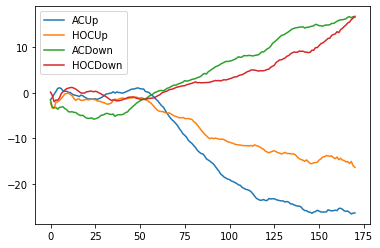

In [9]:
items = ['ACUp', 'HOCUp', 'ACDown', 'HOCDown']

for item in items:
    #pdb.set_trace()
    this_mean = data['parrell_data']['means'][0,0][item][0,0]
    if "Up" in item:
        this_mean = this_mean * -1
    plt.plot(this_mean.T, label=item)
    
plt.legend()

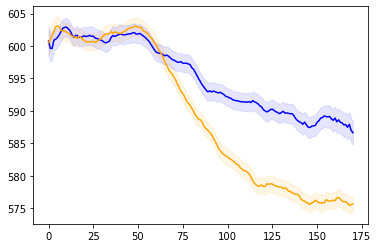

In [10]:
items = ['HOCUp', 'ACUp',]
offset = 603
# offset = 530

# for item in items:
#     #pdb.set_trace()
#     this_mean = data['parrell_data']['means'][0,0][item][0,0]
#     if "Up" in item:
#         this_mean = this_mean * -1 + offset
#     plt.plot(this_mean.T, label=item)
    
# plt.legend()

healthy_mean = data['parrell_data']['means'][0,0]['HOCUp'][0,0][0,:] *-1 +offset #+1
cereb_mean = data['parrell_data']['means'][0,0]['ACUp'][0,0][0,:] *-1 +offset -1

plt.plot(healthy_mean, color='blue', label='HC')
plt.plot(cereb_mean, color='orange', label='CD')

cereb_ci = np.abs( data['parrell_data']['stds'][0,0]['ACUp'][0,0][0,:] )
healthy_ci = np.abs(data['parrell_data']['stds'][0,0]['HOCUp'][0,0][0,:] )

plt.fill_between(range(len(cereb_mean)), (cereb_mean-cereb_ci), (cereb_mean+cereb_ci), color='orange', alpha=.1)
plt.fill_between(range(len(healthy_mean)), (healthy_mean-healthy_ci), (healthy_mean+healthy_ci), color='b', alpha=.1)


## Run Simulations and/or Load data

In [11]:
# prior_min= [  1e-8,  1e-8, 1e-8, 1e-8, 0.0, 0.0]
# prior_mmax = [ 1e-3,  1e-3, 1e-3, 1e-3, 0.075, 0.075]

In [87]:
# import facts_for_SBI

load_instead = False



# prior_min= [  0.004, 0.004, .001,  .001,  9e-7,     9e-7, 150, 150,    1e-10,  1e-10,  1e-10,      1,      1,       1,    25]
# prior_mmax = [0.006, 0.006,  2.5,  .05, 1.1e-6,   1.1e-6, 180, 180,         1,     1,      1,  1.040,  1.040,    1.040,  1e6]

# prior_min= [  0.006, 0.01,  .3,      9e-8,     150, 150,       100,         1,      1,           1,    25]
# prior_mmax = [ 0.01,  0.6,  2.5,   1.1e-5,    180, 180,      5000,          10,  1.040,      1.15,   1000]

# prior_min= [    0.0,   0.0, 1e-8,  1e-8,  9e-8,     9e-8, 150, 150,    1e-10,  1e-10,  1e-10,      1,      1,       1,    25]
# prior_mmax = [  1e-4, 1e-4,    1,    1, 1.1e-5,   1.1e-5, 180, 180,     1e10,   1e10,   1e10,      3,      3,       3,   1e6]

# test_theta = torch.from_numpy(np.array([0.009, 0.05, 0.33, 1e-6, 0, 0, 0, 0]))

# prior_min= [  0.005, 0.01,  0.01,  0.01,  0.01, .1, 1]
# prior_mmax = [ 0.01,  0.1,   1.0,   1.0,   1.0, 20, 5000]

# prior_min= [  0.005, 0.01,  0.01,  0.01,  0.01, 1,  1 ]
# prior_mmax = [ 0.01,  0.1,   1.0,   1.0,   1.0, 100, 10]

# prior_min= [  0.005, 0.01, 1,  1 ]
# prior_mmax = [ 0.01,  0.1,  100, 10]

# prior_min= [  1e-5,  1e-5,  1, 0, 0, 0]
# prior_mmax = [ 5e-2,  1e-1, 5, 1, 1, 1]

# prior_min= [  1e-5,  1e-5, 1, 1e-3,  1e-3]
# prior_mmax = [ 1e-1,  1e-1, 5, 9e-1,  9e-1]
# prior_min= [  1e-8,  1e-8, 1e-8, 1e-8]
# prior_mmax = [ 1e-3,  1e-3, 1e-3, 1e-3 ]

num_sim = 100
num_workers = 1

prior = utils.torchutils.BoxUniform(torch.as_tensor(prior_min), torch.as_tensor(prior_mmax) )
simulator2, prior = prepare_for_sbi(FACTS, prior)
inference = SNPE(prior, density_estimator='nsf')
    
# prior = torch.distributions.Uniform(torch.as_tensor(mmin), torch.as_tensor(mmax) )
for jj in range(7750,8000):
    print(jj)
    if load_instead == False:    
        try:
            theta, x = simulate_for_sbi(simulator2, proposal=prior, num_simulations=num_sim, num_workers=num_workers)
            print(f'theta {theta}')
            #parameter_posterior = infer(simulator2, prior, method='SNPE', num_simulations=num_sim, num_workers=num_workers)
#             density_estimator = inference.append_simulations(theta, x).train()
#             posterior = inference.build_posterior(density_estimator)

        # Save the theta and x
            with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_theta_x_{num_sim}_local{jj}.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
                pickle.dump([theta, x], f)
        # Save the posterior
#         with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{num_sim}_local6.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
#             pickle.dump([posterior], f)
        except Exception as e:
            print(e)
    
# else:


self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05718366056680679
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03383302688598633
7750


Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17632554471492767
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1573294848203659
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02304987981915474
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13041375577449799
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02603013627231121
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020396113395690918
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10481473058462143
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17213265597820282
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10573557764291763
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03506045415997505
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1671764850616455
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17541413009166718
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10188459604978561
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09070388227701187
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12043479830026627
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17312823235988617
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026472067460417747
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08563609421253204
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14483146369457245
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1185925155878067
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13723167777061462
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05213981866836548
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05135786533355713
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02812408283352852
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07077115029096603
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10853131860494614
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03410802036523819
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.186506450176239
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18439774215221405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09786228090524673
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1609123796224594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09926839917898178
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18764811754226685
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06910055130720139
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09667547047138214
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06113617494702339
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1500525176525116
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1016356498003006
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0034756422974169254
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07848483324050903
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016334736719727516
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.018440688028931618
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08641993999481201
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18749496340751648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1399126797914505
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06198117882013321
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1724768429994583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18235711753368378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04940908029675484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09957770258188248
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004220557399094105
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07755525410175323
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12544432282447815
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08850876241922379
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13606500625610352
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18015246093273163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10539106279611588
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07542236894369125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18157260119915009
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12116551399230957
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15779505670070648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0009677290800027549
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0852934718132019
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16984383761882782
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1559877246618271
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06486582010984421
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04774222522974014
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19899985194206238
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09465383738279343
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10177665203809738
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12304305285215378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05015430599451065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12548282742500305
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02092740498483181
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04310840368270874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040270306169986725
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11371695250272751
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1041664257645607
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1553688496351242
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1713741272687912
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09641551226377487
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11186367273330688
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028982890769839287
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.088792584836483
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08791804313659668
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18950898945331573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13330239057540894
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10811463743448257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09160564094781876
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1575217992067337
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006081831641495228
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.068999283015728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08518081903457642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05655348300933838
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13522915542125702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06283612549304962
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06515032052993774
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027108443900942802
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0056282165460288525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1618039757013321
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011014783754944801
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18135088682174683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17747609317302704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1357865184545517
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13390521705150604
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16642208397388458
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17377214133739471
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07844076305627823
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035291362553834915
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045423950999975204
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011097836308181286
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1259871870279312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0708676129579544
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17078310251235962
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10689426958560944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18620942533016205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0964767336845398
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.021219884976744652
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1087707057595253
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09125296026468277
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007157266139984131
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10676127672195435
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15211927890777588
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02727583609521389
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08112390339374542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13905468583106995
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13821856677532196
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020179927349090576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09335591644048691
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01134579163044691
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17552216351032257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07096224278211594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17392711341381073
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1316816210746765
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0966004878282547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08926695585250854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.046218693256378174
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15504924952983856
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05189256742596626
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08801926672458649
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.055435504764318466
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06591508537530899
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18896928429603577
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03971775993704796
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09927331656217575
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12415023148059845
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1995435208082199
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10792817175388336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12028589099645615
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10221325606107712
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16450630128383636
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13978742063045502
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09663368761539459
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1255137175321579
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19171161949634552
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15798106789588928
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03374014049768448
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10839281231164932
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1178169995546341
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1571670025587082
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025120317935943604
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0009050011867657304
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15554769337177277
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06629922240972519
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009889543056488037
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1357150673866272
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18197715282440186
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16608880460262299
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16123461723327637
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16946490108966827
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022265350446105003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1888897866010666
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03882258012890816
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0646953135728836
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1942550092935562
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10012846440076828
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0021455883979797363
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09375550597906113
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0480617992579937
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06452218443155289
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11232353746891022
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07971972227096558
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1852489858865738
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06453382223844528
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06159566715359688
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07513687759637833
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06160007789731026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1429537981748581
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09819147735834122
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026315582916140556
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17810478806495667
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09694375842809677
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029035890474915504
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019172286614775658
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03615124151110649
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19864194095134735
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09835486859083176
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13265126943588257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16367578506469727
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04406121000647545
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1698579043149948
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08037152141332626
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07925224304199219
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08279315382242203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17430691421031952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08711327612400055
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10869897902011871
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08988022059202194
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13700422644615173
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040311455726623535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19585274159908295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002193963620811701
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1937565803527832
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1290256381034851
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02046295441687107
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026393581181764603
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19143693149089813
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13808324933052063
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15196488797664642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11529505252838135
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06678280979394913
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020322179421782494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14642806351184845
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02037748135626316
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0446651354432106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18052153289318085
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17295853793621063
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.041079651564359665
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11504645645618439
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11172987520694733
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0901331827044487
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0324409119784832
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09797310084104538
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09997260570526123
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12273526191711426
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14921914041042328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17331676185131073
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06779394298791885
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15830068290233612
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13822969794273376
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12881706655025482
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015828872099518776
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11135772615671158
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19834907352924347
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09125596284866333
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019113147631287575
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11952386051416397
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12162226438522339
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11612508445978165
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030263293534517288
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1838861107826233
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06677358597517014
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15597128868103027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07203458994626999
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1326931118965149
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16427744925022125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09030022472143173
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10197194665670395
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1129075214266777
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19250263273715973
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039103247225284576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010374593548476696
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05471475049853325
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027560651302337646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.021765196695923805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10939190536737442
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19058997929096222
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.021566295996308327
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14336107671260834
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18517373502254486
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03843679651618004
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07699716091156006
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1842256635427475
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10331378132104874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.062143243849277496
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18030744791030884
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08890507370233536
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19419170916080475
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04697529226541519
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.053942181169986725
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15008078515529633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12190691381692886
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18947510421276093
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005052793305367231
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04811299964785576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11944112926721573
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033567942678928375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02931286208331585
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11402932554483414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11341825872659683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026264918968081474
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16489486396312714
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09707863628864288
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09105217456817627
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17679975926876068
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1352909356355667
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002576935337856412
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1282683163881302
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0742507129907608
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11471634358167648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19099900126457214
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044561054557561874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0726594552397728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04929063469171524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1525472104549408
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0950535461306572
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1043725237250328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006772482302039862
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16552233695983887
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11810828745365143
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10963385552167892
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12459997087717056
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17728129029273987
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16834282875061035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18478600680828094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05600341781973839
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14977480471134186
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.049636222422122955
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05844137817621231
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17699097096920013
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04453791305422783
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06301911920309067
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18511563539505005
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09799408912658691
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15307876467704773
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05131268501281738
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039997648447752
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07964961975812912
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1862441748380661
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029745006933808327
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13667647540569305
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10302066057920456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11402634531259537
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1634829193353653
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07994260638952255
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09584905952215195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09842398017644882
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0071866512298583984
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12326294183731079
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03569230064749718
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01852588728070259
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1688312441110611
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06595146656036377
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11031182110309601
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015316617675125599
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10421349853277206
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1624060869216919
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06089625507593155
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11796236038208008
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011947560124099255
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17666004598140717
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0028140307404100895
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1870199739933014
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10993921011686325
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02841259352862835
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.037862278521060944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18590553104877472
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08812625706195831
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01565195433795452
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07477515190839767
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08057039976119995
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.037943899631500244
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005700659938156605
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06009315326809883
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1292056292295456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1841369867324829
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0008914589998312294
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17028135061264038
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11491735279560089
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13581031560897827
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10335943847894669
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19134046137332916
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05045657232403755
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16285791993141174
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05665777996182442
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03132519870996475
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014264392666518688
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00818403996527195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0016969323623925447
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08976709842681885
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10118672996759415
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.061435189098119736
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024468863382935524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06100351735949516
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0648072361946106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025113392621278763
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03657503053545952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09723855555057526
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00028203727561049163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09198584407567978
self.

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.062109388411045074
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12502889335155487
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13671660423278809
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15017391741275787
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03355693817138672
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0005538225523196161
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016052627936005592
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1512536108493805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14536547660827637
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03967174515128136
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1444070190191269
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09614431858062744
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19063101708889008
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007923162542283535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06112188100814819
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05821124464273453
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02308068238198757
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0844344049692154
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023888850584626198
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1968355029821396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026504231616854668
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10304912179708481
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06237158924341202
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09398730844259262
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15855611860752106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17639273405075073
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19201305508613586
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11806303262710571
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12612955272197723
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15205863118171692
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027494097128510475
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01362066250294447
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0003570437547750771
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12133302539587021
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1786222904920578
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08681268990039825
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08198956400156021
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06750153750181198
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.057089485228061676
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18337473273277283
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11147313565015793
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05053314194083214
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17800478637218475
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10786731541156769
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09628576040267944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03775254637002945
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14877720177173615
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19158662855625153
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16629555821418762
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1161111369729042
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0650358721613884
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16348563134670258
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11090908199548721
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14128802716732025
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1763378381729126
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009170293807983398
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024843527004122734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07228890806436539
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0646623745560646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0012751102913171053
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006604707334190607
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015525639057159424
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040659643709659576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09870903939008713
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1480105221271515
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017736388370394707
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05139244720339775
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1916918158531189
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19731558859348297
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1092618927359581
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017497552558779716
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18831010162830353
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07360675185918808
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07660557329654694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1272003948688507
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15322111546993256
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016995524987578392
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0650857463479042
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1615271419286728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05885631963610649
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01228253822773695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11589590460062027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16337992250919342
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15515290200710297
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1002618670463562
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16245624423027039
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15541128814220428
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1530657857656479
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12774346768856049
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025346625596284866
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08975078165531158
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12576799094676971
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06545114517211914
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06805838644504547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12636727094650269
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19060193002223969
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13983650505542755
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10059372335672379
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15811432898044586
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005751311779022217
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16280876100063324
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03546971082687378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12383716553449631
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005092430394142866
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0768711119890213
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11278092116117477
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14618723094463348
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10434230417013168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04924679920077324
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04415183141827583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1792161911725998
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12770159542560577
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18054048717021942
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033020880073308945
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1484041064977646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06185270473361015
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17932096123695374
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15614791214466095
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07285549491643906
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1793440878391266
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1997482180595398
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1932712197303772
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015288889408111572
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05846461281180382
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12663818895816803
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13979235291481018
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19957448542118073
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11911791563034058
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15879718959331512
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.018700027838349342
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010373092256486416
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18265193700790405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1358647495508194
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07852069288492203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06729581207036972
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14999888837337494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13361577689647675
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031897760927677155
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08054769039154053
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19518598914146423
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07361482828855515
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15310116112232208
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05995810031890869
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1559205949306488
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12896767258644104
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03636536747217178
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09807582199573517
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09479530155658722
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039931464940309525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05438432842493057
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06790007650852203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019416261464357376
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04214165359735489
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14020593464374542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1894122213125229
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011525369249284267
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17830660939216614
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14669835567474365
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07858268171548843
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03387853130698204
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.046202708035707474
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07336347550153732
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07195545732975006
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13807301223278046
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1596701443195343
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12290004640817642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17867784202098846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18634246289730072
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12334995716810226
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15107181668281555
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15234240889549255
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0306022297590971
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11422288417816162
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1387268304824829
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03520350530743599
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1413961499929428
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06447384506464005
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05829564481973648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08217644691467285
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.043271828442811966
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006600487511605024
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.055402614176273346
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12573958933353424
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16771231591701508
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010903501883149147
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04039588198065758
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12072974443435669
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00602146377786994
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0821637511253357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18867240846157074
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09167951345443726
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18979758024215698
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009608114138245583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01940901391208172
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07065611332654953
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1581038385629654
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12445622682571411
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16861334443092346
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0013608932495117188
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0466008186340332
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10700291395187378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17712554335594177
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10737171024084091
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07375126332044601
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07721670717000961
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01736605167388916
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01423803623765707
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08485251665115356
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18346785008907318
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09479188919067383
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004729640670120716
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01841646432876587
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020834041759371758
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13772664964199066
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07965970039367676
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1282508671283722
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.187167689204216
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12848305702209473
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023274291306734085
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024835288524627686
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05604273080825806
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09918039292097092
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023015737533569336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09866229444742203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12715983390808105
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12875668704509735
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020050907507538795
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.021808886900544167
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15077164769172668
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1671217381954193
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04140132665634155
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17391441762447357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10884704440832138
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023180795833468437
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08447941392660141
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1132710799574852
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05992211028933525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1388198882341385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0040580155327916145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05527832731604576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03582277521491051
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008430445566773415
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04354217275977135
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15749125182628632
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1577773094177246
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17752768099308014
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03346414491534233
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033141981810331345
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06252341717481613
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07510153204202652
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06739597767591476
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004804742522537708
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1651366949081421
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1805134415626526
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18557189404964447
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02659900300204754
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016884280368685722
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1551918238401413
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017706453800201416
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17957071959972382
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09846349060535431
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0293292049318552
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02084200456738472
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025293827056884766
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1389581263065338
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026196790859103203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1737733632326126
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0098740104585886
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15662188827991486
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19168217480182648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05095687136054039
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13810500502586365
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09788035601377487
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09834016859531403
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11445679515600204
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17557279765605927
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03473570570349693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012738585472106934
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.196314737200737
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0011069535976275802
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14718616008758545
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.149025097489357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12375463545322418
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.185021311044693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09146767109632492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1837538778781891
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020612740889191628
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01263427734375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12377773970365524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0717972069978714
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009002149105072021
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10271481424570084
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17375577986240387
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04438188299536705
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10110997408628464
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1057511568069458
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13217787444591522
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15785233676433563
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005016350653022528
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1409216672182083
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10452324151992798
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15299047529697418
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12973974645137787
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1875074952840805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033423520624637604
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03712550550699234
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18328163027763367
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0953102633357048
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1455482542514801
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14148935675621033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17429865896701813
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.057568348944187164
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18957321345806122
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08276846259832382
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13154691457748413
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11991133540868759
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10017992556095123
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.047832656651735306
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1915566623210907
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10349541902542114
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0725967213511467
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18589137494564056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04696878418326378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12044501304626465
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023026932030916214
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06206485256552696
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10062020272016525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17978225648403168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.048181917518377304
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19755887985229492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1136431023478508
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02705059014260769
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.084316685795784
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14816300570964813
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12344701588153839
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022352779284119606
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1259251981973648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16339360177516937
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14504608511924744
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07931248098611832
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04692249372601509
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14240948855876923
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07791843265295029
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17197281122207642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0706913098692894
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15410983562469482
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1917281150817871
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.055833008140325546
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17894503474235535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08060736954212189
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13694442808628082
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08877398073673248
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015614879317581654
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07314973324537277
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07004394382238388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19492346048355103
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14891403913497925
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15988914668560028
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05718550831079483
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18275666236877441
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03305543586611748
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0451757088303566
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08304551988840103
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03723864629864693
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035773467272520065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022353291511535645
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1315675675868988
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19711938500404358
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15707220137119293
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019369233399629593
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012111449614167213
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10060907900333405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029850590974092484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00027805566787719727
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04483283683657646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03083578310906887
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1176864504814148
self.p

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15283207595348358
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09140457957983017
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1897035390138626
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16471728682518005
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11832618713378906
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19538886845111847
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06410868465900421
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015095663256943226
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07921206206083298
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04815659672021866
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010867023840546608
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0812280997633934
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10663828998804092
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09415620565414429
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035785723477602005
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03516678884625435
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014874601736664772
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06138434633612633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03018815629184246
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15582221746444702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10346304625272751
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11641166359186172
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11601461470127106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.034997355192899704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1670493632555008
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00895228423178196
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12812243402004242
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06110818311572075
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17895537614822388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05860189348459244
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14575110375881195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014077234081923962
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09712179750204086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09132393449544907
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07791527360677719
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12254269421100616
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.046781182289123535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0748867392539978
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1474253386259079
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1890917718410492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1892048567533493
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08234872668981552
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1315487027168274
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14058342576026917
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15114827454090118
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1791163980960846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09630004316568375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14380380511283875
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09665147215127945
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09590338915586472
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035073280334472656
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08192639797925949
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08055832237005234
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14294615387916565
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004306435585021973
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05775929614901543
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14464956521987915
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12094724178314209
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1503453105688095
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06453660875558853
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02365978993475437
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16035032272338867
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04000096395611763
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05864306911826134
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.018432890996336937
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1379852294921875
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13017332553863525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12232062965631485
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05703411251306534
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16072070598602295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044325437396764755
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11522343009710312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12690769135951996
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014403975568711758
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05196578428149223
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11444961279630661
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1579674929380417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06263245642185211
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16161493957042694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17790168523788452
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04762915521860123
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06318505108356476
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06274539232254028
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14467719197273254
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1549198478460312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031395506113767624
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1046157032251358
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01350494660437107
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12808558344841003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19058674573898315
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16930904984474182
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12782280147075653
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13482026755809784
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005653500556945801
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044964876025915146
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05154823139309883
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17765575647354126
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022591769695281982
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15350905060768127
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0067615630105137825
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028768671676516533
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03701658174395561
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19524116814136505
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10996615141630173
self.p

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033046092838048935
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03765692934393883
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005999112036079168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16075240075588226
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0854494720697403
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07398408651351929
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006598425097763538
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10857733339071274
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1564805954694748
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13335399329662323
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.047381818294525146
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1015835553407669
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06553542613983154
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004584372043609619
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009571504779160023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16596196591854095
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16980983316898346
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19538408517837524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0777166485786438
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10399365425109863
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15863266587257385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1897750049829483
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16232623159885406
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1796744018793106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13468195497989655
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06373868137598038
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15407724678516388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1860596388578415
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02675790898501873
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14675869047641754
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16162116825580597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05326341465115547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11575176566839218
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030230510979890823
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.060559142380952835
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16026289761066437
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03843478113412857
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15304133296012878
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00314081902615726
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.158518448472023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19746458530426025
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03043297491967678
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1689961552619934
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014245676808059216
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09477080404758453
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08682721108198166
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13970868289470673
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09603329747915268
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04897110536694527
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01994701661169529
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16162098944187164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09689436107873917
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0880851298570633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.121116042137146
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14866022765636444
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06914657354354858
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1923118680715561
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17275787889957428
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08184520155191422
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12456704676151276
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07030277699232101
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022116852924227715
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14183944463729858
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.041253019124269485
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08558475971221924
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08006816357374191
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0855889841914177
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04352528974413872
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05161970853805542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16503839194774628
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07245184481143951
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1163000836968422
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014167356304824352
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1880914866924286
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1280984729528427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18196390569210052
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07405542582273483
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10647225379943848
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12417540699243546
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05568169429898262
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06728357076644897
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05814097076654434
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045745719224214554
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16666382551193237
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1205238327383995
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16068315505981445
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033074166625738144
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012278771959245205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13538715243339539
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010526537895202637
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1204821839928627
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10921388119459152
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.043505679816007614
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1334257572889328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015473735518753529
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13342054188251495
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07207460701465607
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12902040779590607
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19744758307933807
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08557839691638947
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.158966526389122
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030726004391908646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16870704293251038
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1102968230843544
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06784742325544357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15596714615821838
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031093908473849297
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15851515531539917
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17844071984291077
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04991579055786133
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05021924898028374
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04099160432815552
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11288682371377945
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02191135846078396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12919040024280548
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024207282811403275
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02404559962451458
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09113658964633942
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09582561254501343
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14349189400672913
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07948906719684601
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1813383251428604
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03632524237036705
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01607801951467991
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12412430346012115
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16686491668224335
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.003888773964717984
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008811712265014648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08918964117765427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16274987161159515
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05472671985626221
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06317704170942307
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19242657721042633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10027822107076645
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012186718173325062
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1172790452837944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07178621739149094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12616245448589325
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1498229056596756
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07777353376150131
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024643266573548317
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13474205136299133
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.032116591930389404
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17348338663578033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016939330846071243
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007239139173179865
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11756173521280289
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02483963966369629
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1863577514886856
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11494509130716324
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08511918038129807
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040547408163547516
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19137604534626007
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.041902270168066025
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027470875531435013
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14278097450733185
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11324595659971237
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006988346576690674
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1428377330303192
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05265789106488228
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14088454842567444
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04397086054086685
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16268180310726166
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15558850765228271
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1986939162015915
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1686760038137436
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08820362389087677
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18188993632793427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12622599303722382
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1542721688747406
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14526773989200592
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16372600197792053
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19108746945858002
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04431046172976494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1101427674293518
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1794387549161911
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02604994736611843
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10684900730848312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012803149409592152
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0019300818676128983
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02711249701678753
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0915059968829155
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08125627040863037
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07743903249502182
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025910114869475365
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1268453299999237
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11894933134317398
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14922551810741425
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026967668905854225
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027036940678954124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0009714126936160028
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19623033702373505
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06403227150440216
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01937791146337986
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09205716103315353
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18853648006916046
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11586552858352661
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10688283294439316
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13702617585659027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1230727806687355
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10750295966863632
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.104522205889225
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08708208799362183
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08747539669275284
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19828225672245026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16622190177440643
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18053282797336578
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12328566610813141
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14881543815135956
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18191824853420258
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02239863947033882
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15581537783145905
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18776200711727142
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06907149404287338
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16265501081943512
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19568076729774475
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1582561582326889
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07389773428440094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10432902723550797
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10424099117517471
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03489653021097183
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18482033908367157
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0774262323975563
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1518654078245163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18298448622226715
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08323576301336288
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08437035232782364
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11344899237155914
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09093213081359863
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08825495094060898
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1818557232618332
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1023167297244072
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1997428983449936
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16767393052577972
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11069619655609131
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020822657272219658
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04304344579577446
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12452957779169083
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.057437192648649216
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03805113956332207
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09505917131900787
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13573051989078522
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17025241255760193
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14044725894927979
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06399517506361008
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.058442700654268265
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19282202422618866
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07929803431034088
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19091640412807465
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06894370168447495
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1797523945569992
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07036103308200836
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07889995723962784
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08123614639043808
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04525740072131157
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19555170834064484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14088205993175507
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10582055151462555
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02581024169921875
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08729533106088638
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09634214639663696
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17491497099399567
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08154296875
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015574300661683083
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13233321905136108
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09672881662845612
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12055661529302597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06326784193515778
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004280292894691229
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06158221885561943
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13691411912441254
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023135220631957054
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06911049038171768
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05840804800391197
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10626213997602463
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12802226841449738
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13433735072612762
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0435330867767334
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05346954986453056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1797303855419159
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15247245132923126
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0654875859618187
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031045829877257347
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1069064512848854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01663259230554104
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.153909832239151
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14463745057582855
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1087639257311821
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0008627414936199784
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1463100165128708
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11270453780889511
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10962330549955368
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.165152907371521
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022379565984010696
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11570228636264801
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17213185131549835
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18849186599254608
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1813669502735138
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14383159577846527
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006837964057922363
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11749845743179321
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1559518724679947
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15106061100959778
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08934376388788223
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12415196746587753
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1834726631641388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15267494320869446
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10598331689834595
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1437501162290573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08042621612548828
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18359319865703583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18581239879131317
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0015151978004723787
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09510635584592819
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.048664845526218414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16913168132305145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12906698882579803
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14229373633861542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03737058863043785
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11530160903930664
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11032698303461075
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05278865247964859
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1399843543767929
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028734399005770683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020195186138153076
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10162226110696793
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10153581947088242
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09092854708433151
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1958363950252533
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.032381322234869
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1371152698993683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0611235611140728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12944461405277252
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05539587885141373
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07082823663949966
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12696118652820587
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12005119770765305
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06537020206451416
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16979745030403137
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12950381636619568
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17703336477279663
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03608148172497749
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12228456884622574
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11599119752645493
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07818400114774704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11839266866445541
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07017955929040909
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10275230556726456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09107279777526855
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16093939542770386
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06381519883871078
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014459717087447643
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019536161795258522
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06854994595050812
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10260768979787827
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0356009379029274
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18993699550628662
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06721003353595734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19572843611240387
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027959978207945824
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02565004862844944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.021074319258332253
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1339658796787262
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18083123862743378
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18161079287528992
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09249158203601837
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008802247233688831
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06539448350667953
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09881225973367691
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07436442375183105
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17266935110092163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1471109241247177
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02540440671145916
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05253629758954048
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1367332935333252
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18395334482192993
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15862955152988434
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09909361600875854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04781675338745117
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14358316361904144
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1830999106168747
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16796718537807465
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1518910527229309
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17068956792354584
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1189279705286026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14772653579711914
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10315803438425064
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15681616961956024
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1882699429988861
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16943486034870148
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09872490167617798
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02454899623990059
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06638162583112717
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11237349361181259
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05493596941232681
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19490712881088257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0608447790145874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0646035447716713
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13742537796497345
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026654934510588646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09880761057138443
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17230594158172607
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12349370867013931
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08935447037220001
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029691457748413086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1971626728773117
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016239775344729424
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11596756428480148
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10804146528244019
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15529660880565643
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1981222927570343
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02288978174328804
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07261248677968979
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017067885026335716
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1824702024459839
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06976330280303955
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08464478701353073
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06812288612127304
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11783633381128311
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11818545311689377
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14789894223213196
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013067210093140602
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0343448780477047
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0037123083602637053
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16365306079387665
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0012794137001037598
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0905623659491539
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19066661596298218
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11954265832901001
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06651005893945694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02037428691983223
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11572890728712082
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17121990025043488
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19263024628162384
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10746457427740097
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1874927431344986
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16158604621887207
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06960057467222214
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18179616332054138
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12477903813123703
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18522138893604279
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15980499982833862
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09719186276197433
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08216073364019394
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18067815899848938
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05816894769668579
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.061489224433898926
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09913571923971176
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09630856662988663
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024218356236815453
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024319732561707497
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03681957721710205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17744489014148712
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09182095527648926
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.177073672413826
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09968193620443344
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10691914707422256
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08947135508060455
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1967582255601883
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06042387709021568
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19200003147125244
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1651669293642044
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.034001659601926804
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18244995176792145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08722491562366486
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016424870118498802
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04431966692209244
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01546713151037693
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12021572887897491
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030441641807556152
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18357405066490173
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17030765116214752
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012831008993089199
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12469102442264557
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16485153138637543
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06920051574707031
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04330047592520714
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.032591819763183594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13987338542938232
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07059430330991745
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024856412783265114
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1582527607679367
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09055149555206299
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04585075378417969
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12992548942565918
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14411282539367676
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1715528815984726
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028641093522310257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07145072519779205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16888366639614105
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05675850063562393
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15714016556739807
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1345919966697693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1516982614994049
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11274727433919907
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19888409972190857
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08948145061731339
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16090992093086243
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.047861646860837936
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16049602627754211
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14892490208148956
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12386514246463776
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0008218288421630859
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10215814411640167
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0691409632563591
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11391059309244156
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07542095333337784
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18439750373363495
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07385469973087311
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05561443790793419
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17362070083618164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09969711303710938
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11771774291992188
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1438640058040619
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12727491557598114
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014958500862121582
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.061548054218292236
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19994714856147766
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.054369714111089706
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19799187779426575
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1065656766295433
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1363351196050644
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09499695152044296
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16905085742473602
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13782928884029388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03867495059967041
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14333733916282654
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008211672306060791
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18978838622570038
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004834771156311035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16956287622451782
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1374213695526123
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027412785217165947
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13867709040641785
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18534307181835175
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15514525771141052
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05953611060976982
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05049550533294678
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04008897766470909
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15865711867809296
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1914224922657013
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05332894250750542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08293578773736954
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07901489734649658
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07617156952619553
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06373279541730881
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09231505542993546
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13510482013225555
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10707946866750717
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11035948246717453
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005942583084106445
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16392116248607635
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16594479978084564
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06694050133228302
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18469183146953583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03296779468655586
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18439438939094543
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11231333017349243
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 4.1294097172794864e-05
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05309551954269409
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.036568451672792435
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16104845702648163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022497892379760742
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13014133274555206
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14923988282680511
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15544649958610535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019222987815737724
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02975180186331272
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07978033274412155
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1426524817943573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11737006157636642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.177176371216774
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17630229890346527
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03151535987854004
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10128291696310043
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1574077159166336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1689777672290802
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17686443030834198
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00022752284712623805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11070942878723145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1184500977396965
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1551423817873001
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1804734319448471
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08271850645542145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035774506628513336
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029528498649597168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18618656694889069
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18224012851715088
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16469600796699524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11294175684452057
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14024865627288818
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.036680664867162704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07347579300403595
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12941472232341766
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009759641252458096
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029767705127596855
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09122192114591599
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07158081978559494
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18408489227294922
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15380406379699707
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14875799417495728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05653106048703194
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11512935161590576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12157046794891357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18135900795459747
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0334157720208168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13524393737316132
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14912621676921844
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15308915078639984
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009137773886322975
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.052884794771671295
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17289118468761444
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08759160339832306
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16864733397960663
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11380275338888168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06903678178787231
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027554679661989212
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09759470075368881
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19917455315589905
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17312319576740265
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07571574300527573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1175885945558548
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0473029725253582
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1856652945280075
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09968813508749008
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11685927212238312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07850704342126846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03187660127878189
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1667896807193756
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1979319453239441
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04550781473517418
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14221704006195068
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1741882562637329
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1878720372915268
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11767380684614182
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1448250263929367
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06889400631189346
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17975325882434845
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013568758964538574
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016416383907198906
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12208272516727448
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08222687244415283
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14026910066604614
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16422007977962494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18273653090000153
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04790453985333443
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10424671322107315
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0311629306524992
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009485996328294277
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1421373039484024
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016059650108218193
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025481998920440674
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18677058815956116
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15030238032341003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023123765364289284
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13176009058952332
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.080813467502594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13167408108711243
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1974039077758789
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06792310625314713
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009641433134675026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1683119386434555
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09801272302865982
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07158487290143967
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15276889503002167
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012840616516768932
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07099661976099014
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18879669904708862
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09512533247470856
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023372912779450417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19554577767848969
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16918067634105682
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025154996663331985
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.143102765083313
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16043305397033691
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025837887078523636
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07635777443647385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00317367329262197
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08072479814291
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04408637434244156
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1644682139158249
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12718556821346283
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06131640821695328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11790456622838974
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1541823297739029
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08405931293964386
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09783677011728287
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16452495753765106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02309316396713257
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07155070453882217
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04093382507562637
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04639557749032974
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14184992015361786
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11809022724628448
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07377075403928757
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07750778645277023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19925367832183838
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18411104381084442
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12776103615760803
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13535654544830322
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1900085061788559
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12785093486309052
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13020989298820496
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18445664644241333
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04585676267743111
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12232756614685059
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05000130087137222
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1420934945344925
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11931707710027695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18305444717407227
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04164372757077217
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19329434633255005
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16502812504768372
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09809601306915283
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1580544412136078
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14713935554027557
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1553676873445511
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13695712387561798
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017836177721619606
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0422830693423748
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10432203114032745
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11345527321100235
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05775531753897667
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19751311838626862
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04548454284667969
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16939902305603027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03346220403909683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07000404596328735
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004194748587906361
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03637183830142021
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19039997458457947
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017232144251465797
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06198517233133316
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015490114688873291
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1016509085893631
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06107071787118912
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03233053907752037
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12725020945072174
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07444597780704498
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016870176419615746
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08345212042331696
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11266406625509262
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007278371136635542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18966643512248993
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09385734796524048
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12844660878181458
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12295863777399063
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15109595656394958
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04442206770181656
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.192091166973114
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10244660824537277
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0014688849914819002
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12781134247779846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1270359307527542
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.165305957198143
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15502017736434937
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1265333890914917
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08736773580312729
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16195006668567657
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14166048169136047
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03871021419763565
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16089580953121185
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09457876533269882
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0816333070397377
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1362742781639099
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028407443314790726
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08355344831943512
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08206677436828613
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01322860736399889
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16789622604846954
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01685032807290554
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08578057587146759
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11795667558908463
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00790185946971178
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1301390528678894
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07053788751363754
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1625259816646576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.032196320593357086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.048626650124788284
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.175718292593956
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0971338078379631
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05866020917892456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06468937546014786
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17159080505371094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03264760971069336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008378553204238415
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1779409497976303
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030682504177093506
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0027480244170874357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11373648792505264
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027989162132143974
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008572828955948353
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02226017788052559
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006977057550102472
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12677210569381714
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01961066760122776
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.120979905128479
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13176432251930237
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04223368316888809
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16940973699092865
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1739145666360855
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17744170129299164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13442815840244293
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17474952340126038
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16987408697605133
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04611707851290703
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10076180845499039
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1879052221775055
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020694375038146973
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026833225041627884
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006619525142014027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06997767835855484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1543416976928711
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0689702033996582
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18460439145565033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0010811210377141833
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11913720518350601
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02757822349667549
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1721036434173584
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06887290626764297
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17604218423366547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13182227313518524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1022905632853508
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17539630830287933
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11049721390008926
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05531054735183716
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08549099415540695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04547227546572685
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10022657364606857
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09987626224756241
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18891742825508118
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08682351559400558
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027077699080109596
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11705140024423599
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08605020493268967
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030772745609283447
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04469548538327217
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.055246103554964066
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025313103571534157
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12538793683052063
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04026314243674278
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1227288767695427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18187987804412842
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1764240711927414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1423412561416626
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.058194734156131744
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05188417434692383
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12982578575611115
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18448534607887268
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18771474063396454
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1634182184934616
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19788692891597748
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.176231250166893
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1829386204481125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19278934597969055
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15258637070655823
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10521658509969711
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.018595874309539795
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06235622242093086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15658023953437805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014168048277497292
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14002087712287903
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07705986499786377
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14930889010429382
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035725273191928864
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09319248050451279
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18589113652706146
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16116254031658173
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1799355000257492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04714338853955269
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12802790105342865
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0118483304977417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05732529237866402
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1779174655675888
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19873236119747162
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13474707305431366
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08548425883054733
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1016448363661766
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12548960745334625
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17257849872112274
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1289607733488083
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06931915134191513
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11428578943014145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10281485319137573
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007232296746224165
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01337136048823595
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0896085873246193
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10475193709135056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010949778370559216
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07690248638391495
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.178273543715477
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1856617033481598
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02663142792880535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08160870522260666
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13685400784015656
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13704413175582886
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13568228483200073
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15273608267307281
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09583397209644318
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0432254783809185
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11887545883655548
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17404185235500336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.056353893131017685
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11833622306585312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0744362473487854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.034231461584568024
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.021705567836761475
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14044536650180817
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17637017369270325
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.038959991186857224
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05126211792230606
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13199558854103088
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07184874266386032
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027842510491609573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08614472299814224
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08581385761499405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19775903224945068
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06198389455676079
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15328434109687805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08887835592031479
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07856421917676926
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1369953602552414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1878233402967453
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01954435184597969
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1652030050754547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06559552252292633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05140050873160362
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18109773099422455
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1464739888906479
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.041817426681518555
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10157948732376099
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18587321043014526
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0041991472244262695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11655322462320328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14343878626823425
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039582621306180954
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06736832857131958
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17013442516326904
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13377684354782104
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1720372587442398
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10115662962198257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09173355251550674
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.043966617435216904
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09301842749118805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07849811762571335
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15034116804599762
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05379625782370567
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13324889540672302
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1089077964425087
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05649329349398613
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.037198521196842194
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1554250419139862
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19128037989139557
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12596851587295532
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0789257064461708
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14279136061668396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05877184867858887
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09907616674900055
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1076258197426796
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0629277378320694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004280710127204657
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05607990175485611
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0735262781381607
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10802886635065079
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01680830679833889
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10799672454595566
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11131548136472702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17136162519454956
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03740986809134483
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13367177546024323
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07838213443756104
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06576874107122421
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017782557755708694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11350645124912262
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0633758082985878
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0023094534408301115
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11631643027067184
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10581214725971222
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08253655582666397
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1567661613225937
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1900220364332199
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06760617345571518
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1696644276380539
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1591693013906479
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03864985704421997
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06564118713140488
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1329549103975296
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08423765748739243
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11243223398923874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13183635473251343
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13446791470050812
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14454463124275208
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1901681274175644
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03749215602874756
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13038310408592224
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18370068073272705
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0012349486351013184
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007367956917732954
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1828639954328537
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15062566101551056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11915390938520432
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12631189823150635
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19711120426654816
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008383405394852161
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05622468143701553
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09410683065652847
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16157886385917664
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10451463609933853
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00924073439091444
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07044334709644318
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04576549679040909
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12225518375635147
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.060826994478702545
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.049429573118686676
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10978102684020996
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1316143423318863
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02640554867684841
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1302882730960846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04321872070431709
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11378730833530426
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09207733720541
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14018584787845612
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02176879718899727
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19095592200756073
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.052225470542907715
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1376928687095642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09251534938812256
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.042635560035705566
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11689265817403793
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16570740938186646
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08042726665735245
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17108036577701569
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08644226938486099
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10723864287137985
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09969552606344223
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1938095986843109
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.063109390437603
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17352555692195892
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08898432552814484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17278975248336792
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02808229997754097
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10588689148426056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16849569976329803
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1372278481721878
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13986901938915253
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07331983000040054
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07261376827955246
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18196013569831848
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07721798866987228
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08933304995298386
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19722497463226318
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023701488971710205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09177154302597046
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11298400163650513
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14541687071323395
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17063698172569275
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08732601255178452
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14764007925987244
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19294115900993347
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12996233999729156
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04156399890780449
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09741275757551193
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11500600725412369
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0633092150092125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01180657185614109
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07410760223865509
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18916326761245728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028299713507294655
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03435131534934044
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14430375397205353
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19967158138751984
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.059126436710357666
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09247638285160065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.034443605691194534
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07060767710208893
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18027453124523163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12271092087030411
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1715490072965622
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15269266068935394
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09510922431945801
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14977174997329712
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04183415323495865
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08375778049230576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05759197473526001
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04345505312085152
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014809357933700085
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08498942106962204
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09307227283716202
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0429362915456295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16324180364608765
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16634172201156616
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00395390996709466
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0467551127076149
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.153141051530838
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17542524635791779
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1553410440683365
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08779313415288925
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08570932596921921
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1557725965976715
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06700350344181061
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18961791694164276
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17597545683383942
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13081984221935272
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08448325842618942
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18267370760440826
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18323270976543427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16161666810512543
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11379217356443405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19677697122097015
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10266032069921494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011302674189209938
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.075300432741642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05080477148294449
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.049665965139865875
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13570891320705414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15809719264507294
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15925364196300507
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19840364158153534
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16256342828273773
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19413486123085022
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18226632475852966
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18141163885593414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1776718944311142
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012373900972306728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10261417925357819
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08534460514783859
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10621603578329086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13199494779109955
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0006215572357177734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.059912025928497314
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16713231801986694
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04533987119793892
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1785072535276413
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015611648559570312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025687325745821
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08144333213567734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05499015003442764
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.139173686504364
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1574770212173462
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.172329381108284
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03915001079440117
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06840649992227554
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07436847686767578
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1345900595188141
self.plant_scale:  0

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09763514995574951
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17993541061878204
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1789342164993286
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14150628447532654
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15280503034591675
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07446179538965225
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03208940103650093
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08822225779294968
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13775424659252167
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13234975934028625
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13806511461734772
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03880242258310318
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11869199573993683
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16123013198375702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016888750717043877
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08504433929920197
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045812010765075684
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0033510089851915836
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015142643824219704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11099028587341309
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007639897055923939
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19441235065460205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06669361889362335
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016170000657439232
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11538910120725632
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09030061215162277
self.

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08619153499603271
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1046246886253357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1790715456008911
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16885627806186676
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04059711843729019
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009618532843887806
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09366033226251602
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08565136045217514
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16803382337093353
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13063664734363556
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19385702908039093
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15558025240898132
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1564466655254364
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12384653091430664
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14259515702724457
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.051232196390628815
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1722618192434311
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19366391003131866
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0270342119038105
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13115371763706207
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02941436879336834
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1754966527223587
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05071067810058594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12462218850851059
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06913117319345474
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11406116932630539
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19484053552150726
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16532520949840546
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11259229481220245
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05455759912729263
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16901852190494537
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11485832184553146
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18983063101768494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04813802242279053
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04622826725244522
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10320176929235458
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0525745265185833
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09730125963687897
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11156970262527466
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11731785535812378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033859144896268845
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15057291090488434
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05229688808321953
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02747035026550293
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18906964361667633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1568562239408493
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1643884927034378
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08047661930322647
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.062278248369693756
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010982823558151722
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17132215201854706
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14720124006271362
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045609571039676666
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10747360438108444
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06531798094511032
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.048697151243686676
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07139845192432404
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02811192348599434
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03823012113571167
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06789540499448776
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15033863484859467
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.165578231215477
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08846520632505417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06163300201296806
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0608108751475811
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05754108354449272
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07693637907505035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1463881880044937
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09001516550779343
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09106972068548203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12567146122455597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1601112335920334
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031999170780181885
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009792459197342396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18915319442749023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09444691985845566
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17940105497837067
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07586263865232468
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09186577796936035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013438999652862549
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06088661029934883
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1138601079583168
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1565508395433426
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08101524412631989
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1037382036447525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19725947082042694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18313561379909515
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13970012962818146
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05466056987643242
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09679987281560898
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.043180134147405624
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1611263006925583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14143496751785278
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13395275175571442
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14693520963191986
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01287380512803793
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00024520160513930023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04593116044998169
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10392804443836212
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15931075811386108
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11923986673355103
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16357429325580597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1033816933631897
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19752545654773712
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08276362717151642
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17708167433738708
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09271623939275742
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03622269630432129
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08708687126636505
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19431674480438232
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05646698549389839
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022688675671815872
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11914604902267456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08972825855016708
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005330014508217573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09838129580020905
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13375528156757355
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15733541548252106
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.168975830078125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024304473772644997
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12347656488418579
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16954635083675385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11701559275388718
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16506215929985046
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11844342201948166
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004820787813514471
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11371828615665436
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020102107897400856
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1499571055173874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11450779438018799
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11732102930545807
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.143877312541008
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12365762144327164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11170599609613419
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039401840418577194
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07361536473035812
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0013975739711895585
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17594178020954132
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05596443638205528
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15450085699558258
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03857380151748657
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028606915846467018
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009393751621246338
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.060167230665683746
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1674576848745346
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02675476111471653
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18584738671779633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0025824427139014006
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1850554198026657
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17159341275691986
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17767594754695892
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03922809287905693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1975289285182953
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09197069704532623
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18816684186458588
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06681189686059952
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17476458847522736
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19212961196899414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10660325735807419
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030805015936493874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14577607810497284
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.003728580428287387
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10641397535800934
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1090388223528862
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08726318180561066
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0756048709154129
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08795174211263657
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0962655171751976
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19648250937461853
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01866176165640354
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03493618965148926
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19029152393341064
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13864289224147797
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035341061651706696
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18363989889621735
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010151720605790615
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11417590826749802
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05303001403808594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.068397656083107
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02714824676513672
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09239231795072556
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13105803728103638
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1832035630941391
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12831048667430878
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1924629658460617
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03859853744506836
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15981058776378632
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07354332506656647
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10849013179540634
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008461403660476208
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004627227783203125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14221085608005524
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1287766844034195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005297851748764515
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14822901785373688
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07061155885457993
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1783439666032791
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06296868622303009
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.042808737605810165
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016004538163542747
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05566133186221123
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09718149900436401
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08995912224054337
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.070536307990551
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006479609292000532
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06396865099668503
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0361006036400795
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0856395959854126
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12514467537403107
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01530545949935913
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06303427368402481
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10989828407764435
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002434503985568881
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15685664117336273
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008036482147872448
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014298844151198864
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11562780290842056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12654560804367065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.060767482966184616
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17116835713386536
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1290801614522934
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07599498331546783
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0958787351846695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03666440397500992
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11867024004459381
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11825291067361832
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18358872830867767
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19175569713115692
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17206229269504547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033463526517152786
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04760756716132164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14399152994155884
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12766622006893158
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06066446378827095
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10509248077869415
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13572563230991364
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14501233398914337
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09992042928934097
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14314977824687958
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06962098181247711
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15534813702106476
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.060450006276369095
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004724049475044012
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.059487055987119675
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12518028914928436
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.051670193672180176
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1281348317861557
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045932888984680176
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1025853306055069
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17377063632011414
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11120947450399399
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10465561598539352
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10096508264541626
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17390257120132446
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15346454083919525
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16426442563533783
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06668961048126221
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012903702445328236
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03253468498587608
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014515555463731289
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015247881412506104
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18261998891830444
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013723099604249
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15867923200130463
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1686876267194748
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09697902202606201
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15000426769256592
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16611044108867645
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06232595443725586
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0428784154355526
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17087796330451965
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09725487232208252
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01886082999408245
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013204455375671387
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15958479046821594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.060176800936460495
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1806657612323761
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16539275646209717
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07387252897024155
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1321072280406952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19168101251125336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11277329176664352
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15596584975719452
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16537079215049744
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008175588212907314
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17139671742916107
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08118133991956711
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11540060490369797
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08791416138410568
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05797485262155533
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17817310988903046
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10359714180231094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11782761663198471
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07404065132141113
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18186838924884796
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13114245235919952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04019056633114815
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16978013515472412
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13502337038516998
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17464356124401093
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02494567632675171
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11095010489225388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1357964724302292
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14783816039562225
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07292380183935165
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07291865348815918
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16734376549720764
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18448756635189056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0787113830447197
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1889062225818634
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13064691424369812
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13970142602920532
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17239955067634583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19123569130897522
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18071584403514862
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11023636907339096
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035718586295843124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15167097747325897
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046569108963012695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004027021117508411
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12754330039024353
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.005839300341904163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12180361896753311
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1757444590330124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19978070259094238
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006930291652679443
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1363058239221573
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015305424109101295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14862577617168427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06576190143823624
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02633143775165081
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07897092401981354
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1694563329219818
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14188262820243835
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024729395285248756
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07331987470388412
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013577747158706188
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11518605798482895
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18953105807304382
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16243821382522583
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014394533820450306
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07712941616773605
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12205255031585693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11165574938058853
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12871621549129486
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11579277366399765
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1537197381258011
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015370202250778675
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15976859629154205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17933277785778046
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0038930773735046387
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16747325658798218
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08988483250141144
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18933913111686707
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15200339257717133
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08791591972112656
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05825845152139664
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11892660707235336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10446971654891968
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015440821647644043
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19771654903888702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.034004759043455124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08258137851953506
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09355602413415909
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002416849136352539
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12139806896448135
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16658690571784973
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16860659420490265
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02494950406253338
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14364397525787354
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03390404209494591
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1542264223098755
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0847565159201622
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01147319097071886
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1346440315246582
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0327792651951313
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16757039725780487
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033584773540496826
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1482955515384674
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10954070091247559
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18495331704616547
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12770740687847137
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.054981529712677
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04553457722067833
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09328066557645798
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05753455311059952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019654452800750732
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03598470613360405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15442529320716858
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08506031334400177
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12762580811977386
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03561795875430107
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.036099743098020554
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14912521839141846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18326285481452942
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07374300807714462
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15003429353237152
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10930215567350388
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14623574912548065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07630588114261627
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18278299272060394
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18775562942028046
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05902966484427452
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12990489602088928
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039994169026613235
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05951204523444176
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12264686822891235
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06491875648498535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08656487613916397
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17250072956085205
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04086598381400108
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02496919594705105
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013014090247452259
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1518261879682541
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017291510477662086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11136608570814133
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19236305356025696
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18191705644130707
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07770434767007828
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.001350665115751326
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04252897575497627
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06098107248544693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06437108665704727
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08762817829847336
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10691303014755249
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0040416838601231575
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10202775150537491
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0856352373957634
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0469045415520668
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11170031130313873
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19997242093086243
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1780470758676529
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18955466151237488
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15711842477321625
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11133505403995514
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015640879049897194
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19884037971496582
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0869181752204895
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.059468697756528854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10238733142614365
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01685016229748726
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08297669887542725
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03434136137366295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07466749101877213
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17341403663158417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14795859158039093
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00489653367549181
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10634493827819824
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0389159694314003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10549914091825485
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011671758256852627
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15560559928417206
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1273115873336792
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10115945339202881
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11136062443256378
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.042157698422670364
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17024284601211548
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044966306537389755
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18518267571926117
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05267995595932007
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04169671609997749
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11582209914922714
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16835443675518036
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0980556383728981
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12361729145050049
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05112196132540703
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04937591776251793
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1396988034248352
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07798320055007935
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11864122003316879
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14321641623973846
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07123374193906784
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10590889304876328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04480710253119469
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014757215976715088
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04787470027804375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04932351037859917
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1092522144317627
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10628346353769302
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1838904768228531
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1814650595188141
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09490983933210373
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0758088156580925
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17995287477970123
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19391481578350067
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00813822727650404
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11913716048002243
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18057425320148468
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0798061266541481
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16647106409072876
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04243055731058121
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007006979081779718
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031524110585451126
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19504593312740326
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09100987017154694
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15318173170089722
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08195865154266357
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013333166018128395
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.056340526789426804
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06007956340909004
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020590901374816895
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006429422181099653
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0648697167634964
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16546204686164856
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03226437792181969
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0996561199426651
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06988866627216339
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03330333158373833
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1613827645778656
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07239895313978195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1431192010641098
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05670541524887085
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18158142268657684
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19293926656246185
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1722705215215683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.052743662148714066
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13766202330589294
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1413678079843521
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.048053301870822906
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0836697444319725
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08747740089893341
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08898515999317169
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07935979217290878
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10227230936288834
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17501001060009003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12883220613002777
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0016216397052630782
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12988975644111633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1555211991071701
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.051610421389341354
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16824792325496674
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07557754963636398
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01699504815042019
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10678430646657944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022197378799319267
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19156137108802795
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1570618897676468
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.033258307725191116
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1960773468017578
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1257898211479187
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14700745046138763
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.036362599581480026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16152304410934448
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14743590354919434
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09523669630289078
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11322658509016037
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1515434831380844
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035346757620573044
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18966802954673767
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03195955976843834
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06740734726190567
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044886864721775055
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06960520893335342
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19350163638591766
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13197268545627594
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.037062980234622955
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1732664257287979
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0757049098610878
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17075292766094208
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12279964983463287
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12043726444244385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06251399964094162
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1669544279575348
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19524435698986053
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01859459839761257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1614607572555542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03195181116461754
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025346267968416214
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11400389671325684
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.008709847927093506
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03453024849295616
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03097149170935154
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04317140579223633
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14582504332065582
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17664682865142822
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1416272222995758
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007781434338539839
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14186717569828033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01387025136500597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1228589192032814
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16895847022533417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05693021044135094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019466865807771683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07684116810560226
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0870412141084671
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010135686956346035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06569503992795944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15764383971691132
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12124470621347427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19453266263008118
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03222999721765518
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10927864164113998
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10073850303888321
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12705875933170319
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14867046475410461
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1488143354654312
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16963310539722443
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08424565941095352
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05087555572390556
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07620494812726974
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00410151481628418
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0036935568787157536
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08371364325284958
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.051798928529024124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06217405945062637
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09449567645788193
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18182632327079773
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028973842039704323
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.042510222643613815
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006788015365600586
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19597913324832916
self.p

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06428120285272598
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017309440299868584
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09588887542486191
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18380258977413177
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15281438827514648
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02069377899169922
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09378446638584137
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0652058944106102
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17820662260055542
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1703699678182602
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12578755617141724
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02100992202758789
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1460564285516739
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13680489361286163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016045594587922096
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19747020304203033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.038803864270448685
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04864376783370972
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04892181232571602
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09974757581949234
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16712187230587006
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12089252471923828
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04116910696029663
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19805961847305298
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07563978433609009
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18611164391040802
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15131062269210815
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05473539978265762
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0016355871921405196
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09482573717832565
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18814663589000702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18762601912021637
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012582564726471901
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15040431916713715
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07944225519895554
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.051399897783994675
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04624004289507866
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18950025737285614
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11004828661680222
self.pla

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08798681944608688
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14302313327789307
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04363398626446724
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11775501817464828
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08062992244958878
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06845151633024216
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07673390209674835
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07826458662748337
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13630594313144684
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.056538116186857224
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04492086172103882
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0030716420151293278
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18466611206531525
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09739042818546295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031230105087161064
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1897393763065338
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12408095598220825
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006346929352730513
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13255839049816132
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10586176067590714
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0010435223812237382
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10970176756381989
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11222176998853683
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09694530069828033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01797349564731121
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12176372110843658
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06831671297550201
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14528129994869232
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0004599928797688335
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1955224573612213
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18099938333034515
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030272269621491432
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1163594126701355
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06549300998449326
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009013855829834938
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15768328309059143
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05123931169509888
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11252909898757935
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13109663128852844
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14540360867977142
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09747518599033356
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06317726522684097
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09455107897520065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045199692249298096
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10080321133136749
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019741667434573174
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1865541934967041
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03994845226407051
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18085862696170807
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015482616610825062
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.027344560250639915
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.157133087515831
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1444557011127472
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12734977900981903
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010180914774537086
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011316502466797829
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014829409308731556
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18753992021083832
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07081208378076553
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08430897444486618
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002357268473133445
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.061567630618810654
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19507156312465668
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0061349631287157536
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03465365245938301
self.p

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19343452155590057
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020579874515533447
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19090813398361206
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14860959351062775
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16515766084194183
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17484167218208313
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02202136628329754
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19121500849723816
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10856505483388901
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06327231228351593
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05591398477554321
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029260683804750443
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06633225828409195
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17560157179832458
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028042960911989212
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12036172300577164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1899583488702774
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09078890085220337
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17250896990299225
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15613895654678345
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04764911159873009
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010454404167830944
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00036187173100188375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.106109119951725
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19045445322990417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04648897796869278
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09541366249322891
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.073361836373806
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.039908409118652344
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14985136687755585
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.017636477947235107
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12083376944065094
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19165389239788055
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016156161203980446
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00978789385408163
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12094088643789291
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013830065727233887
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16221724450588226
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15564903616905212
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09157780557870865
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03739682585000992
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03181940317153931
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09935051202774048
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015273344703018665
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11412028223276138
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07468073815107346
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11092960834503174
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06952978670597076
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10009417682886124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14588864147663116
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1493818759918213
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035245370119810104
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19930586218833923
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19641710817813873
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16785717010498047
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12349305301904678
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01740669086575508
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02556380070745945
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15415726602077484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18900412321090698
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06567879021167755
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08574340492486954
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08172798156738281
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16675542294979095
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11799583584070206
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06744349002838135
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07335325330495834
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18916194140911102
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11348121613264084
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18861642479896545
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12989072501659393
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01567171886563301
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11757123470306396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004450810141861439
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14790473878383636
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09465944766998291
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.050166141241788864
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07957343012094498
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1759859174489975
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10156259685754776
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09327894449234009
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09074634313583374
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10595027357339859
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01143041905015707
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07006006687879562
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11476284265518188
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04816485568881035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.023023128509521484
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19123521447181702
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12228646129369736
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14118270576000214
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.041126515716314316
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10573668777942657
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1019509807229042
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06742526590824127
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.049748171120882034
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1230698749423027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1885388195514679
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18848462402820587
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18649624288082123
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02819700352847576
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17648111283779144
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08480577915906906
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1665024757385254
self.plant_sca

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09631266444921494
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0007238149992190301
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 5.649328159051947e-05
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15429557859897614
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031138289719820023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030085492879152298
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15601631999015808
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.049208056181669235
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17230495810508728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15830790996551514
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06706172227859497
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13533060252666473
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13139483332633972
self.

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04841085895895958
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.031288959085941315
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06471141427755356
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09168306738138199
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16039761900901794
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11604223400354385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.106656014919281
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.125286266207695
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04546551778912544
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026071572676301003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04056372866034508
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1593063622713089
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09863030910491943
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.041017211973667145
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05744999647140503
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09842635691165924
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19944874942302704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11402276903390884
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.009699988178908825
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18594388663768768
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15004794299602509
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11461442708969116
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08039360493421555
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08736296743154526
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14539401233196259
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11347442865371704
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05582857131958008
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06700898706912994
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06316617876291275
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1920083463191986
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17957204580307007
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13173529505729675
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10874324291944504
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0511883981525898
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015113425441086292
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1313074678182602
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16540077328681946
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14854952692985535
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0701279267668724
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0929073616862297
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15358227491378784
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.056027960032224655
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15082192420959473
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06632685661315918
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11581801623106003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13940194249153137
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1380397230386734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19653606414794922
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08137770742177963
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16164273023605347
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026522208005189896
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019045591354370117
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04947766289114952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022708548232913017
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14769262075424194
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03760230541229248
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16859042644500732
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12970566749572754
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1732962280511856
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07608053833246231
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12292355298995972
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1630963385105133
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1735049933195114
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0571635477244854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19837920367717743
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10013151168823242
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13924705982208252
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19145312905311584
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18679742515087128
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.066070057451725
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03258566930890083
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0139267323538661
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11019573360681534
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17688995599746704
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1619241088628769
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07244201004505157
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1684267818927765
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12576575577259064
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.036213040351867676
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.058244455605745316
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07474219053983688
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0408002994954586
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18179002404212952
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19106750190258026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07180970162153244
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03249466419219971
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12795285880565643
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16002260148525238
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0836912989616394
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18521593511104584
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09048660099506378
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15317223966121674
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14883184432983398
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18415574729442596
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04318082332611084
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09952282160520554
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07157572358846664
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029507625848054886
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05081305652856827
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.042968060821294785
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03539673238992691
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04076343774795532
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.050761546939611435
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07472171634435654
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.048825085163116455
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035792529582977295
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1884813904762268
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06936019659042358
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15901556611061096
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014083790592849255
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14251850545406342
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15272092819213867
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1752714216709137
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03020995855331421
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07967805862426758
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14332467317581177
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05302983522415161
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08119583129882812
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13168463110923767
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06718869507312775
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08248337358236313
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1478205919265747
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.026356101036071777
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13078831136226654
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045319344848394394
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09760157018899918
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06769611686468124
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.016237784177064896
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04293195158243179
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044910598546266556
self.plan

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08641254156827927
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.014534080401062965
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18438223004341125
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18389666080474854
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019459832459688187
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1719171404838562
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07257493585348129
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10568840801715851
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06723689287900925
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1957128942012787
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16784222424030304
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15042471885681152
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05911942943930626
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05798683315515518
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10389437526464462
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09887254238128662
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19057708978652954
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14659947156906128
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1408049315214157
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1842602640390396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17407821118831635
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18403981626033783
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011964273639023304
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03635052591562271
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0013811230892315507
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08556560426950455
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11614276468753815
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17968757450580597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07607319205999374
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0858047604560852
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10796375572681427
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.010405182838439941
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10078717768192291
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09421183168888092
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012216723524034023
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14547352492809296
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09358978271484375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07379206269979477
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15833495557308197
self.plant_

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10725964605808258
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01698916032910347
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16632340848445892
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1948610097169876
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19353030622005463
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015337109565734863
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19784696400165558
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13631626963615417
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14171992242336273
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05007852241396904
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18252016603946686
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15630455315113068
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07103468477725983
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19228853285312653
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04907950386404991
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02945174090564251
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19779829680919647
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.053847458213567734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05890646204352379
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03587177023291588
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1293102353811264
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025392210111021996
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1389273703098297
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08782811462879181
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18033219873905182
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12367631494998932
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09939731657505035
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.146693155169487
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1102653294801712
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.050691213458776474
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07199878990650177
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06793723255395889
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1791025698184967
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17932197451591492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0575067512691021
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17340879142284393
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07312541455030441
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13427762687206268
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10016508400440216
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01307378988713026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07526396960020065
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17237557470798492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10401638597249985
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09769045561552048
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07730767875909805
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17901460826396942
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.019648922607302666
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06641502678394318
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1828746646642685
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0516853928565979
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16922040283679962
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06522858142852783
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1418159455060959
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16477012634277344
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004404103849083185
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.012690591625869274
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06960956007242203
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1857796162366867
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18293222784996033
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1458645462989807
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12073307484388351
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07448238134384155
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1576230227947235
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00979601126164198
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1594700664281845
self.plant_scal

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11069635301828384
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.020582234486937523
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13607175648212433
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10469029098749161
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025356639176607132
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17651793360710144
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10452371835708618
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.032773494720458984
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.006036245729774237
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06151428446173668
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04194910451769829
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01782313548028469
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.030723953619599342
self.pl

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15775734186172485
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16433976590633392
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05146745592355728
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0553583987057209
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1206885501742363
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14453168213367462
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1653057038784027
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09716667979955673
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1822342574596405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.028057444840669632
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0448276661336422
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10669728368520737
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15915648639202118
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14555472135543823
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08223017305135727
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10700614750385284
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1723535656929016
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12536808848381042
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15657329559326172
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11142577230930328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07513286173343658
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.052034009248018265
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0616992712020874
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00602192897349596
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06198754534125328
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07420283555984497
self.plant_sc

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13718056678771973
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18526996672153473
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0732811912894249
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17329534888267517
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0567287914454937
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10540588945150375
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.025881195440888405
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09893830120563507
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10590823739767075
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00023971796326804906
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.00624581566080451
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13465236127376556
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15345419943332672
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.011460077948868275
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01091096457093954
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16994179785251617
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1752309501171112
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19270026683807373
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13588950037956238
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1974276751279831
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15552376210689545
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1557251662015915
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0969519391655922
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15357546508312225
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.06014275550842285
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1813524216413498
self.plant_scale

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.12444218248128891
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.061976563185453415
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09785886853933334
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0007697105756960809
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013704860582947731
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0001736283302307129
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05834057554602623
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.029515957459807396
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14278557896614075
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19582347571849823
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.058192312717437744
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18704359233379364
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19477686285972595
self

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04160916805267334
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19388698041439056
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19619189202785492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15052300691604614
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08477252721786499
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16271182894706726
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.043191708624362946
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03001873567700386
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.013154173269867897
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10797851532697678
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1801002025604248
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.08089043200016022
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.007167852018028498
self.plant

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16329394280910492
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17113560438156128
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1913556009531021
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14153878390789032
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09302511066198349
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04582719877362251
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18329070508480072
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16262538731098175
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09988953173160553
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15390919148921967
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.035159457474946976
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01419080514460802
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04253594949841499
self.plant_s

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14612849056720734
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.04353832080960274
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.15233445167541504
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.024949563667178154
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16348199546337128
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1518048644065857
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19020524621009827
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11063261330127716
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0014029741287231445
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.015076423063874245
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19467459619045258
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14549411833286285
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0014325500233098865
self.pl

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.180002361536026
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16601204872131348
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0735040083527565
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.13808338344097137
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03128936514258385
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0722251757979393
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10953593254089355
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1720668375492096
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.16701440513134003
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10134273767471313
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.05408846214413643
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1421358585357666
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.045160796493291855
self.plant_scale:

Running 100 simulations.:   0%|          | 0/100 [00:00<?, ?it/s]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19144314527511597
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.14338243007659912
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09100998938083649
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07900136709213257
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.044437408447265625
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.1935655176639557
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.10113835334777832
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.11460267752408981
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18304680287837982
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.07466492801904678
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.17229750752449036
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.19686385989189148
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.18040476739406586
self.plant_s

## Load theta and x

In [12]:
# # Get list of all pickle files matching string
# # all_files = os.listdir('./sbi_resources')
# # path_to_files = './sbi_resources/April7_9params_good_priorTooNarrow/'
# path_to_files = './sbi_resources/'
# all_files = os.listdir(path_to_files) 
# selected_files = [x for x in all_files if 'theta_x_' in x]
# # selected_files = [x for x in all_files if 'theta_x_' in x and 'local' in x]

# path_to_files2 = './sbi_resources/April7_9params_good_priorTooNarrow/'
# all_files2 = os.listdir(path_to_files2) 
# selected_files2 = [x for x in all_files2 if 'theta_x_' in x]

# selected_files2_combined = selected_files + selected_files2

# # Iterate through list
# all_theta, all_x = torch.tensor(np.array([]), dtype=torch.float32), torch.tensor(np.array([]), dtype=torch.float32)
# for file_string in selected_files2_combined:
#     file = open(f'{path_to_files}{file_string}', 'rb')
# #     pdb.set_trace()
#     this_theta, this_x = pickle.load(file)

#     # Append 
#     all_theta = torch.cat((all_theta, this_theta))
#     all_x = torch.cat((all_x, this_x))

#     # Close file
#     file.close()    
# print(all_theta.shape)
# print(all_x.shape)


In [12]:
def load_and_combine_sbi_files(path_to_files, path_to_files2=None):
    """
    Loads and combines 'theta_x_' files from one or two specified directories.

    Args:
        path_to_files (str): The primary directory path (e.g., './sbi_resources/').
        path_to_files2 (str, optional): A secondary directory path to combine files from. Defaults to None.

    Returns:
        tuple: (all_theta, all_x) as concatenated PyTorch tensors.
    """
    
    # --- Process Primary Path ---
    all_files = os.listdir(path_to_files)
    selected_files = [x for x in all_files if 'theta_x_' in x]

    selected_files_combined = selected_files
    
    # --- Process Secondary Path if provided ---
    # We will use a dictionary to track which base path to use for each filename
    file_path_map = {f: path_to_files for f in selected_files}

    if path_to_files2:
        all_files2 = os.listdir(path_to_files2)
        selected_files2 = [x for x in all_files2 if 'theta_x_' in x]
        selected_files_combined = selected_files + selected_files2
        
        # Add secondary files to the path map
        for f in selected_files2:
            # Overwrite if duplicates exist, giving priority to the second directory if found in both
            file_path_map[f] = path_to_files2 

    print(f"Found {len(selected_files_combined)} files to process.")

    # --- Iterate through list and load data ---
    # Initialize empty tensors for concatenation
    all_theta = torch.tensor(np.array([]), dtype=torch.float32)
    all_x = torch.tensor(np.array([]), dtype=torch.float32)

    for file_string in selected_files_combined:
        # CRITICAL FIX: Use the correct base path from our map
        base_path = file_path_map[file_string]
        full_file_path = os.path.join(base_path, file_string)
        
        with open(full_file_path, 'rb') as file:
            this_theta, this_x = pickle.load(file)

        # Append
        all_theta = torch.cat((all_theta, this_theta))
        all_x = torch.cat((all_x, this_x))
        
    print(f"Combined all_theta shape: {all_theta.shape}")
    print(f"Combined all_x shape: {all_x.shape}")

    return all_theta, all_x

# --- Example Usage ---
# Define your paths
primary_path = './sbi_resources/'
secondary_path = './sbi_resources/April7_9params_good_priorTooNarrow/'

# Call the function
all_theta, all_x = load_and_combine_sbi_files(
    path_to_files=primary_path, 
    path_to_files2=secondary_path
)

# You can now use theta_data and x_data

Found 9044 files to process.
Combined all_theta shape: torch.Size([602200, 9])
Combined all_x shape: torch.Size([602200, 140])


In [13]:
# labels = ['Aud Noise Scale', 'Somato Noise Scale', 'TSE Process Scale',
#           'TSE Covariance Scale', 'ASE Process Scale', 'ASE Covariance Scale',
#           'Auditory Delay', 'Somato Delay', 'AUKF_Qmult_for_pert', 
#           'AUKF_Rmult_for_pert', 'AUKF_Pmult_for_pert', 'AUKF_learning_rate']


# print(labels[-6])
# filter_some_data=True
# if filter_some_data == True:
#     filter_bool = all_theta[:,-6] < 180
#     all_x = all_x[filter_bool]
#     all_theta = all_theta[filter_bool]
    
# print('after too large Auditory Delay filter')
# print(all_theta.shape)
# print(all_x.shape)

# filter_data_on_magnitude=True
# if filter_data_on_magnitude == True:
#     filter_bool = torch.any(all_x < 498, dim=1)
#     all_x = all_x[~filter_bool]
#     all_theta = all_theta[~filter_bool]
    
# print('after magnitude filter')
# print(all_theta.shape)
# print(all_x.shape)

In [14]:
filter_some_data=True
if filter_some_data == True:
    filter_bool2 = (all_x != -1).all(axis=1)
    all_x = all_x[filter_bool2]
    all_theta = all_theta[filter_bool2]
    
    filter_bool2 = (all_x >= 400).all(axis=1)
    all_x = all_x[filter_bool2]
    all_theta = all_theta[filter_bool2]
  
print('after negative filter')
print(all_theta.shape)
print(all_x.shape)

after negative filter
torch.Size([602080, 9])
torch.Size([602080, 140])


### Resample cereb data so that it resamples to 5ms to match FACTS

In [15]:
from scipy.interpolate import interp1d
###Downsample data to match simulator output 
def downsample(array, npts):
    interpolated = interp1d(np.arange(len(array)), array, axis = 0, fill_value = 'extrapolate')
    downsampled = interpolated(np.linspace(0, len(array), npts))
    return downsampled

cereb_mean_ds = downsample(cereb_mean, 100)
healthy_mean_ds = downsample(healthy_mean, 100)

cereb_ci_ds = downsample(cereb_ci, 100)
healthy_ci_ds = downsample(healthy_ci, 100)

print(cereb_mean_ds.shape)

(100,)


### Create simulated data of preonset

The first 40 frames appear to have the same unperturbed data

(140,)


(-200.0, 500.0)

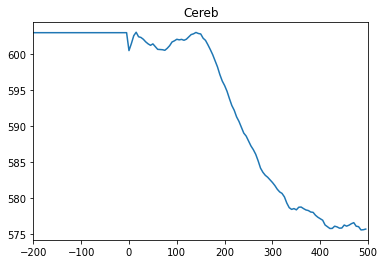

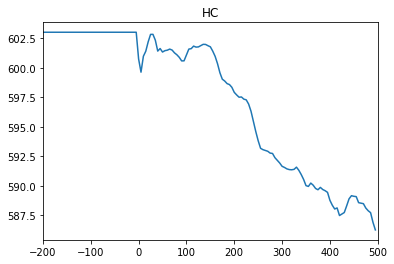

In [16]:
def create_precompensation_synthetic_data(orig_data):
#     precomp_mean = np.mean(orig_data[0:40])
#     precomp_std = np.std(orig_data[0:40])
#     precomp_offset = 530
    precomp_offset = 603

    cereb_synth = np.array([precomp_offset]*40)
    return np.concatenate( (cereb_synth, orig_data) )


cereb_mean_synth = create_precompensation_synthetic_data(cereb_mean_ds)
healthy_mean_synth = create_precompensation_synthetic_data(healthy_mean_ds)
#pdb.set_trace()
x_time = np.arange(-200,500,5)
plt.plot(x_time, cereb_mean_synth )
plt.title('Cereb')
#plt.ylim([500, 535])
plt.xlim([-200,500])

plt.figure()
plt.plot(x_time, healthy_mean_synth )
plt.title('HC')
#plt.ylim([500, 535])
print(healthy_mean_synth.shape)
plt.xlim([-200,500])



### Only grab the first 140 samples to match Ben's data

100 FACTS samples covers 0-500ms

40 FACTS samples covers 200ms preperturbation, which we wont plot

In [17]:
all_x_ds = all_x[:,0:140]
print(all_x_ds.shape)
print(all_theta.shape)


torch.Size([602080, 140])
torch.Size([602080, 9])


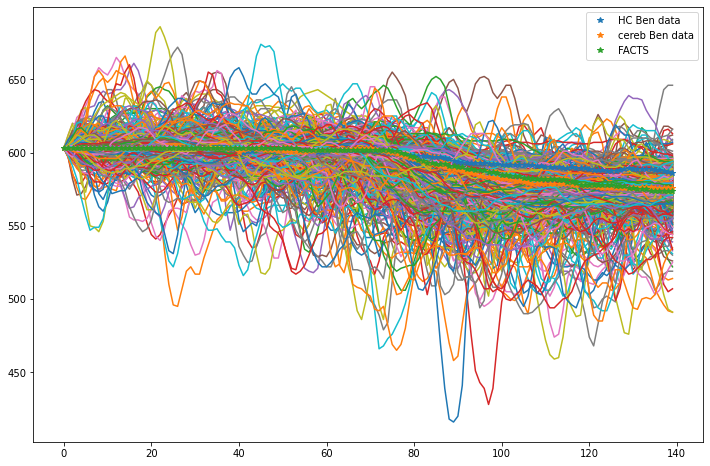

In [18]:
# Print some of the training data, just to make sure it is diverse
sample_size = all_x_ds.shape[0]
n = 1000 #sample_size
x_time = np.linspace(-200,700, num=140)
x_time_repeated = np.tile(x_time, n).reshape(n, -1)


random_samples_indices = np.random.choice(sample_size, n, replace=False)

plt.figure(figsize=(12, 8)) 
plt.plot(all_x_ds[random_samples_indices,:].T)
plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')
plt.plot(cereb_mean_synth.reshape(1,140).T, '*', label='cereb Ben data' )
plt.plot(simulated_test, '*',label='FACTS')

plt.legend()

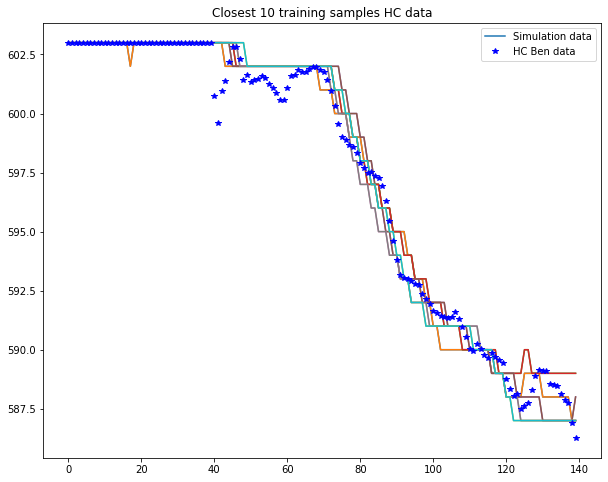

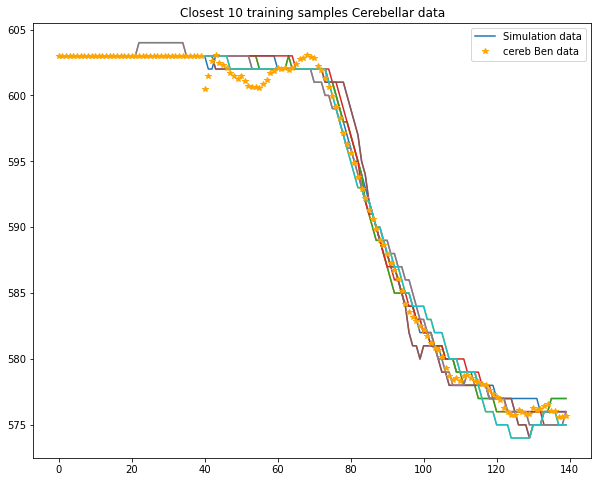

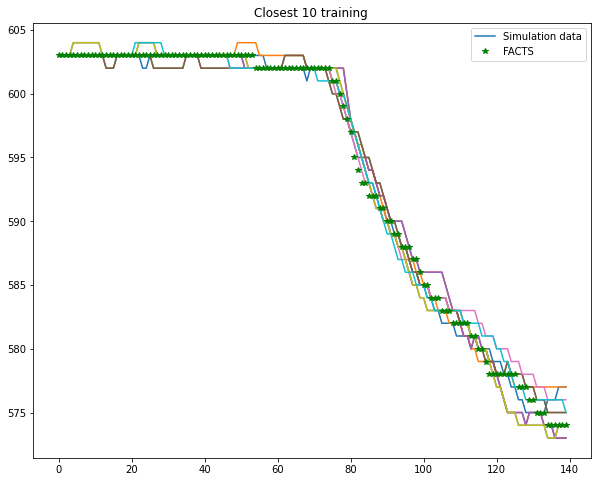

In [19]:
# Show the closest training samples
differencesHC = abs(all_x_ds - healthy_mean_synth)
differencesHC_summed = torch.sum(differencesHC, dim=1)
sorted_tensorHC, indicesHC = torch.sort(differencesHC_summed)

# Sort by sum
n = 10
plt.figure(figsize=(10,8))
plt.plot(all_x_ds[indicesHC[0:n],:].T, label='Simulation data')
# plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')
plt.plot(healthy_mean_synth.reshape(1,140).T, '*', color='Blue', label='HC Ben data' )
plt.title(f'Closest {n} training samples HC data')
lines_to_show = [0, -1]  # Index of lines to show in the legend
handles, labelss = plt.gca().get_legend_handles_labels()
selected_handles = [handles[i] for i in lines_to_show]
selected_labels = [labelss[i] for i in lines_to_show]
plt.legend(selected_handles, selected_labels)

# Plot which lines are closest
differences = abs(all_x_ds - cereb_mean_synth)
differences_summed = torch.sum(differences, dim=1)
sorted_tensor, indices = torch.sort(differences_summed)

# Sort by sum
plt.figure(figsize=(10,8))
plt.plot(all_x_ds[indices[0:n],:].T, label='Simulation data')
# plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')
plt.plot(cereb_mean_synth.reshape(1,140).T, '*', color='orange', label='cereb Ben data' )
plt.title(f'Closest {n} training samples Cerebellar data')
lines_to_show = [0, -1]  # Index of lines to show in the legend
handles, labelss = plt.gca().get_legend_handles_labels()
selected_handles = [handles[i] for i in lines_to_show]
selected_labels = [labelss[i] for i in lines_to_show]
plt.legend(selected_handles, selected_labels)

# Sort by sum
differences_FACTS = abs(all_x_ds - simulated_test)
differencesFACTS_summed = torch.sum(differences_FACTS, dim=1)
sorted_tensorF, indicesF = torch.sort(differencesFACTS_summed)

plt.figure(figsize=(10,8))
plt.plot(all_x_ds[indicesF[0:n],:].T, label='Simulation data')
# plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')
plt.plot(simulated_test, '*', color='green', label='FACTS' )
plt.title(f'Closest {n} training ')
lines_to_show = [0, -1]  # Index of lines to show in the legend
handles, labelss = plt.gca().get_legend_handles_labels()
selected_handles = [handles[i] for i in lines_to_show]
selected_labels = [labelss[i] for i in lines_to_show]
plt.legend(selected_handles, selected_labels)

(140,)
(140,)


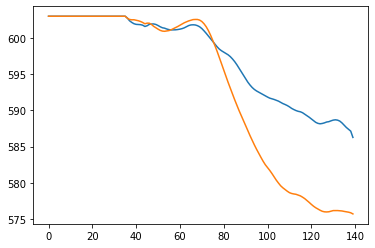

In [20]:
# What if we smooth the cereb_mean_synth and the healthy_mean_synth?

def smooth_np_convolve(data, window_size = 3):
    # Get a pad
    # Pad the data at the edges
    pad_width = window_size // 2
    padded_data = np.pad(data, pad_width, mode='edge')

    # Define the sliding average window size
    kernel = np.ones(window_size) / window_size

    # Apply the sliding average
    smoothed_data_interior = np.convolve(padded_data, kernel, mode='valid')

    smoothed_data = np.zeros_like(data)
    smoothed_data[0] = data[0]
    smoothed_data[-1] = data[-1]
    smoothed_data[1:-1] = smoothed_data_interior[1:-1]
    return smoothed_data

smoothed_cereb = smooth_np_convolve(cereb_mean_synth, 9)
smoothed_healthy = smooth_np_convolve(healthy_mean_synth, 9)
# plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')
# plt.plot(cereb_mean_synth.reshape(1,140).T, '*', label='cereb Ben data' )

plt.plot(smoothed_healthy)
plt.plot(smoothed_cereb)
print(healthy_mean_synth.shape)
print(smoothed_healthy.shape)

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/native/TensorShape.cpp:3281.)
  


(570.0, 605.0)

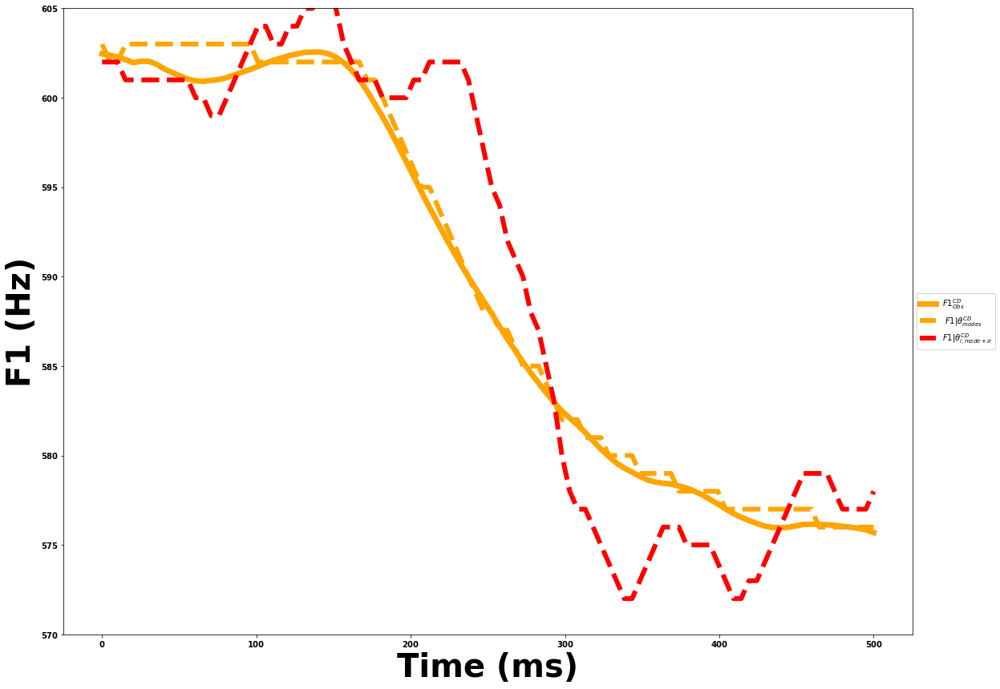

In [21]:
# This is for paper figure 1 marginal sensitivity analsysis
x_time = np.linspace(0,500, num=100)
temp = smoothed_cereb.reshape(1,140).T

fontsize=40
plt.figure(figsize=(16,12))
plt.plot(x_time, temp[40:140], color='orange', label=r'$F1^{CD}_{Obs}$' , linewidth=7)
plt.plot(x_time, all_x_ds[indices[0],40:140].T, '--', linewidth=6, label=r" $F1|\theta^{CD}_{modes}$", color='orange')
plt.plot(x_time, all_x_ds[indices[25011],40:140].T, '--', linewidth=6, label=r'$F1|\theta^{CD}_{i,mode + \sigma}$', color='red')
# plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')


# plt.title(f'Sensitivity to\n Parameter Deviations from Mode', fontweight='bold', fontsize=fontsize)


plt.ylabel('F1 (Hz)', fontweight='bold', fontsize=fontsize)
plt.xlabel('Time (ms)', fontweight='bold',fontsize=fontsize)

plt.xticks(fontweight='bold')
plt.yticks(fontweight='bold')

plt.tight_layout()
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5)) 
plt.ylim([570, 605])

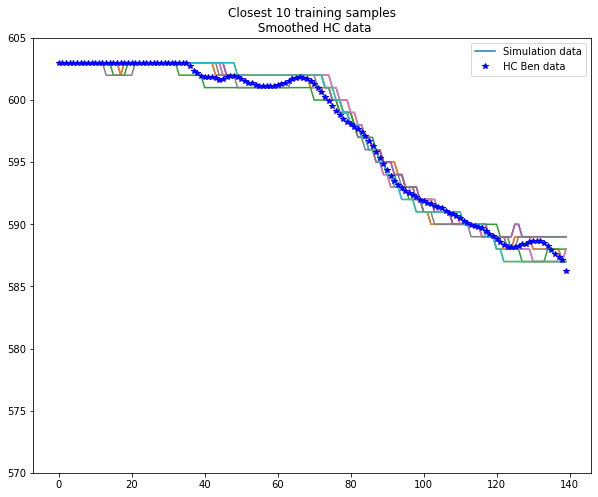

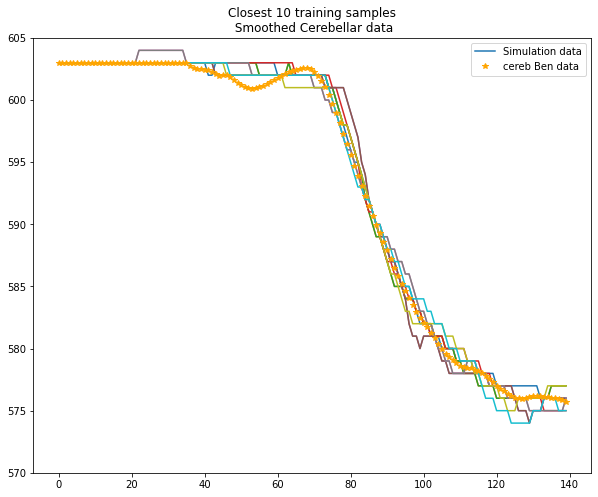

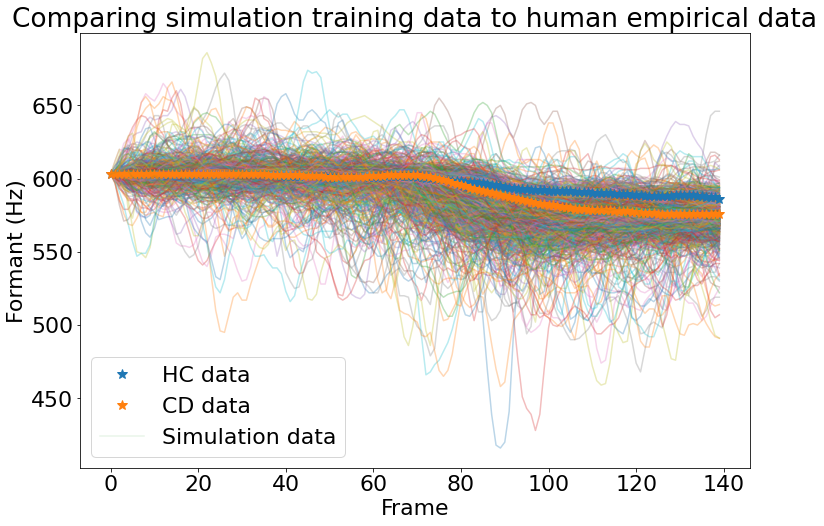

In [22]:
# Show the closest training samples
differencesHC = abs(all_x_ds - smoothed_healthy)
differencesHC_summed = torch.sum(differencesHC, dim=1)
sorted_tensorHC, indicesHC = torch.sort(differencesHC_summed)

# Sort by sum
n = 10
plt.figure(figsize=(10,8))
plt.plot(all_x_ds[indicesHC[0:n],:].T, label='Simulation data')
plt.plot(smoothed_healthy.reshape(1,140).T, '*', color='Blue', label='HC Ben data' )
plt.title(f'Closest {n} training samples\n Smoothed HC data')
lines_to_show = [0, -1]  # Index of lines to show in the legend
handles, labelss = plt.gca().get_legend_handles_labels()
selected_handles = [handles[i] for i in lines_to_show]
selected_labels = [labelss[i] for i in lines_to_show]
plt.legend(selected_handles, selected_labels)

plt.ylim([570, 605])
# plt.ylim([490, 540])

# Plot which lines are closest
differences = abs(all_x_ds - smoothed_cereb)
differences_summed = torch.sum(differences, dim=1)
sorted_tensor, indices = torch.sort(differences_summed)

# Sort by sum
plt.figure(figsize=(10,8))
plt.plot(all_x_ds[indices[0:n],:].T, label='Simulation data')
# plt.plot(healthy_mean_synth.reshape(1,140).T, '*', label= 'HC Ben data')
plt.plot(smoothed_cereb.reshape(1,140).T, '*', color='orange', label='cereb Ben data' )
plt.title(f'Closest {n} training samples\n Smoothed Cerebellar data')
lines_to_show = [0, -1]  # Index of lines to show in the legend
handles, labelss = plt.gca().get_legend_handles_labels()
selected_handles = [handles[i] for i in lines_to_show]
selected_labels = [labelss[i] for i in lines_to_show]
plt.legend(selected_handles, selected_labels)
plt.ylim([570, 605])
# plt.ylim([490, 540])

plt.rcParams.update({'font.size': 22})
plt.figure(figsize=(12, 8)) 
plt.plot(all_x_ds[random_samples_indices,:].T, label='_nolegend_', alpha=0.3)
h1 = plt.plot(smoothed_healthy.reshape(1,140).T, '*', markersize=10, label= 'HC data')
h2 = plt.plot(smoothed_cereb.reshape(1,140).T, '*', markersize=10, label='CD data' )
h3 = plt.plot(all_x_ds[0,:].T, label='Simulation data', alpha=0.1)
plt.title('Comparing simulation training data to human empirical data')
plt.xlabel('Frame')
plt.ylabel('Formant (Hz)')
plt.legend()

Text(0.5, 1.0, 'HC vs CD Speech Compensation')

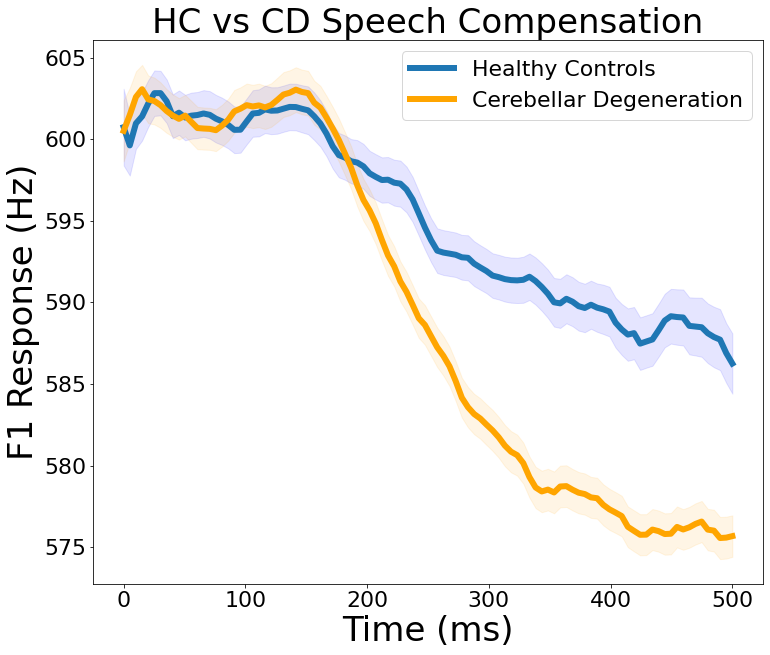

In [23]:
# Plot for figure 1
# Plot without empiri
x_time = np.linspace(0,500, num=100)
# Get the default color cycle
default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

# First few colors in the default cycle:
blue_from_cycle = default_colors[0]   # Default blue
orange_from_cycle = default_colors[1] # Default orange

# Plot without empiri
x_time = np.linspace(0,500, num=100)
fontsize=34

plt.figure(figsize=(12,10))
plt.plot(x_time, healthy_mean_synth[40:140],label='Healthy Controls', linewidth=6, color=blue_from_cycle)
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='blue', alpha=.1)


plt.plot(x_time, cereb_mean_synth[40:140], 'orange',label='Cerebellar Degeneration', linewidth=6)
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1)

plt.xlabel('Time (ms)', fontsize=fontsize)
plt.ylabel('F1 Response (Hz)', fontsize=fontsize)

plt.legend(fontsize='medium')
plt.title('HC vs CD Speech Compensation', fontsize=fontsize)

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:21: MatplotlibDeprecationWarning: Unrecognized location 'outer right'. Falling back on 'best'; valid locations are
	best
	upper right
	upper left
	lower left
	lower right
	right
	center left
	center right
	lower center
	upper center
	center
This will raise an exception in 3.3.


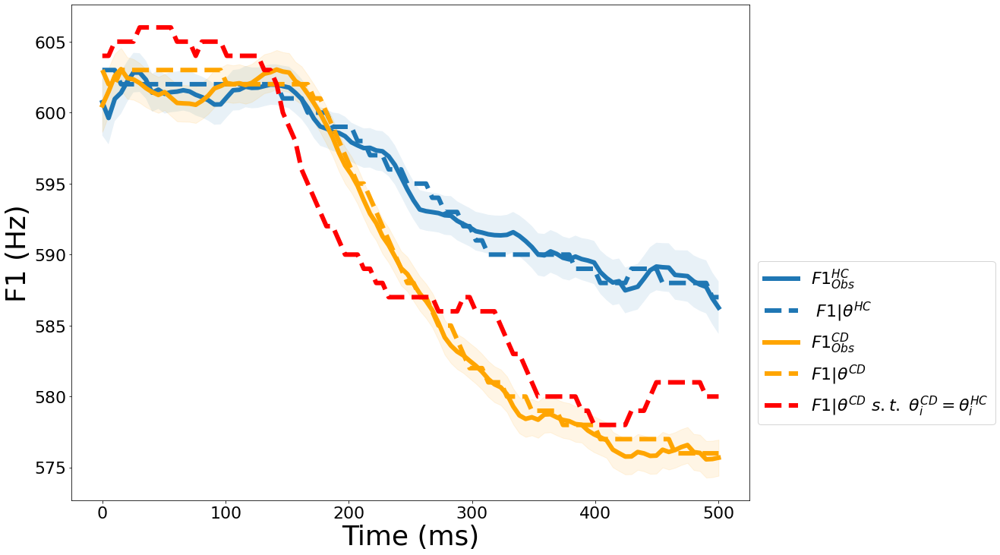

In [24]:


plt.figure(figsize=(16,12))
plt.plot(x_time, healthy_mean_synth[40:140],label=r'$F1^{HC}_{Obs}$', linewidth=6, color=blue_from_cycle )
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), alpha=.1)
plt.plot(x_time, all_x_ds[indicesHC[0],:].T[40:140],'--', label=r' $F1|\theta^{HC}$', linewidth=6, color=blue_from_cycle )



plt.plot(x_time, cereb_mean_synth[40:140], 'orange',label=r'$F1^{CD}_{Obs}$', linewidth=6)
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1)
plt.plot(x_time, all_x_ds[indices[0],40:140].T, '--', linewidth=6, label=r'$F1|\theta^{CD}$', color='orange')
plt.plot(x_time, all_x_ds[indices[27016],40:140].T, '--', linewidth=6, label=r'$F1|\theta^{CD}$ $s.t.$ $\theta_{i}^{CD}=\theta_{i}^{HC}$', color='red')



plt.xlabel('Time (ms)', fontsize=36)
plt.ylabel('F1 (Hz)', fontsize=36)

plt.legend(fontsize='medium')
# plt.title('Single-Parameter Substitution Analysis', fontsize=40)

plt.legend(loc='outer right', bbox_to_anchor=(1, 0.5)) 
ax = plt.gca()
# ax.legend_ = None

(570.0, 606.0)

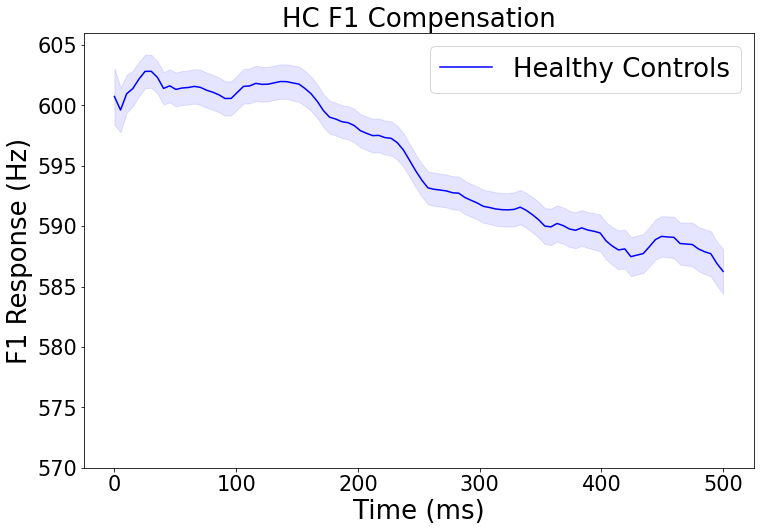

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


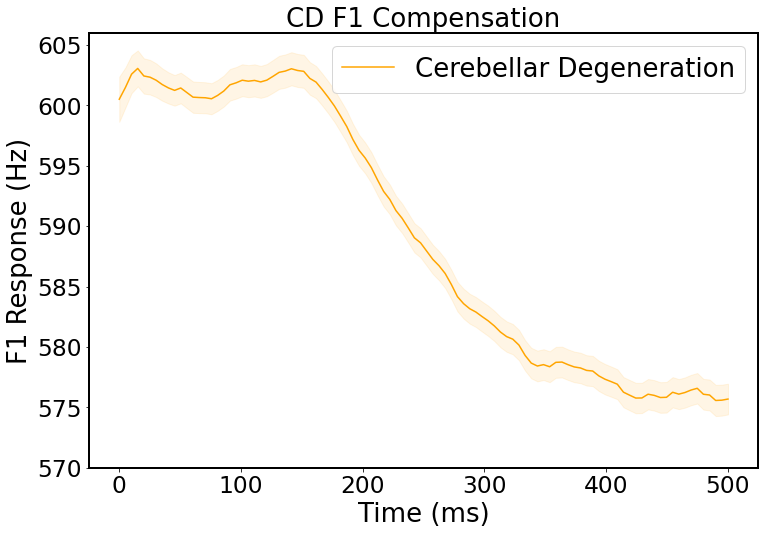

In [25]:


# Plot without empiri
x_time = np.linspace(0,500, num=100)

plt.figure(figsize=(12,8))

ft_size = 26

plt.plot(x_time, healthy_mean_synth[40:140], 'blue',label='Healthy Controls')
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='blue', alpha=.1)


# plt.plot(x_time, cereb_mean_synth[40:140], 'orange',label='Cerebellar Degeneration')
# plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1)

plt.xlabel('Time (ms)', fontsize=ft_size,)
plt.ylabel('F1 Response (Hz)', fontsize=ft_size)

plt.legend(fontsize=ft_size)
plt.title('HC F1 Compensation', fontsize=ft_size)


font = {'family' : 'normal',
        'weight' : 'normal',
        }
ax = plt.gca()
ax.tick_params(axis='both', which='major', labelsize=ft_size*.8)
plt.rc('font', **font)
plt.rc('axes', linewidth=2)
plt.ylim([570,606])
# plt.ylim([490,540])



plt.figure(figsize=(12,8))
# plt.plot(x_time, healthy_mean_synth[40:140], 'blue',label='Healthy Controls')
# plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='blue', alpha=.1)


plt.plot(x_time, cereb_mean_synth[40:140], 'orange',label='Cerebellar Degeneration')
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1)

plt.xlabel('Time (ms)', fontsize=ft_size,)
plt.ylabel('F1 Response (Hz)', fontsize=ft_size,)

plt.legend(fontsize=ft_size)
plt.title('CD F1 Compensation', fontsize=ft_size,)
ax = plt.gca()
ax.tick_params(axis='both', which='major', labelsize=ft_size*.9)
plt.ylim([570,606])
# plt.ylim([490,540])

In [26]:
# Save all_theta and all_x


In [28]:

# prior_min= [  0.001, 0.01,  .1,   .01,   9e-8,     9e-8, 150, 150,       100,   1e-17,      1,      1,      1,       1,    25]
# prior_mmax = [ 0.01,  0.1,  2.5,  .05, 1.1e-5,   1.1e-5, 180, 180,      5000,       5,      10,  1.040,  1.040,    1.2,   1000]

# prior_min= [  0.006, 0.01,  .3,      9e-8,     150, 150,       100,         1,      1,           1,    25]
# prior_mmax = [ 0.01,  0.6,  2.5,   1.1e-5,    180, 180,      5000,          10,  1.040,      1.15,   1000]

# prior_min= [  0.005, 0.01, 0.001,   1.1e-8,    0.01,  0.01,  0.01]
# prior_mmax = [ 0.01,  0.1,   0.1,   1.1e-5,     1.0,   1.0,   1.0]

 
# prior_min = [  1e-08, 1e-8,  1e-8, 1e-8, 100, 100,  3,  0,  0]
# prior_mmax = [   1e2, 1e-4,  0.05, 1e-4, 240, 240, 10, .1, .1]

prior = utils.torchutils.BoxUniform(torch.as_tensor(prior_min), torch.as_tensor(prior_mmax) )
simulator2, prior = prepare_for_sbi(FACTS, prior)
inference = SNPE(prior, density_estimator='nsf')

run_and_save = True
print(len(prior_min))


learning_rate = 5e-6
training_batch_size = 32
if run_and_save:
#     density_estimator = inference.append_simulations(best_theta, best_x_ds).train(force_first_round_loss=True,
    density_estimator = inference.append_simulations(all_theta, all_x_ds).train(force_first_round_loss=True,
                                                                                discard_prior_samples=True, 
                                                                                show_train_summary=True,
                                                                               training_batch_size=training_batch_size,
                                                                                learning_rate = learning_rate,
                                                                               ) # Look more into force_first_round_loss=True
#     density_estimator = inference.append_simulations(all_theta[0:100000,:], all_x_ds[0:100000]).train(force_first_round_loss=True)
#     posterior = inference.build_posterior(density_estimator, sample_with='mcmc')
    posterior = inference.build_posterior(density_estimator)

    # Save the posterior
    with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta.size()[0]}_local_nsf_{training_batch_size}_{learning_rate}.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
        pickle.dump([posterior], f)
        
else:
#     with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_72000_local.pkl', 'rb') as f:  # Python 3: open(..., 'wb')
# ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_3969_local_nsf.pkl
#     with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_3969_local_nsf.pkl', 'rb') as f:  # Python 3: open(..., 'wb')

#         pdb.set_trace()
        object_file = pickle.load(f)
        posterior = object_file[0]

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.09301238507032394
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.055784132331609726
9
 Neural network successfully converged after 217 epochs.
        -------------------------
        ||||| ROUND 1 STATS |||||:
        -------------------------
        Epochs trained: 217
        Best validation performance: -2.0975
        -------------------------
        


In [29]:
# # # Save the posterior
print(all_theta.size()[0])
all_theta_size = all_theta.size()[0]
# # all_theta_size=3969eio
# with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta_size}_okay.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
#     pickle.dump([posterior], f)
    
# # # Save the inference
# with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_inference_{all_theta_size}_okay.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
#     pickle.dump([inference], f)

SAVE = True
LOAD = False

posterior_path = f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta_size}_{training_batch_size}_{learning_rate}.pkl'
inference_path = f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_inference_{all_theta_size}_{training_batch_size}_{learning_rate}.pkl'

if SAVE:
    # Save the posterior
    with open(posterior_path, 'wb') as f:
        pickle.dump([posterior], f)

    # Save the inference
    with open(inference_path, 'wb') as f:
        pickle.dump([inference], f)

if LOAD:
    # Load the posterior
    with open(posterior_path, 'rb') as f:
        posterior = pickle.load(f)[0]

    # Load the inference
    with open(inference_path, 'rb') as f:
        inference = pickle.load(f)[0]

602080


/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/sbi/inference/base.py:428: UserWarning: When the inference object is pickled, the behaviour of the loaded object changes in the following two ways: 1) `.train(..., retrain_from_scratch=True)` is not supported. 2) When the loaded object calls the `.train()` method, it generates a new tensorboard summary writer (instead of appending to the current one).
  "When the inference object is pickled, the behaviour of the loaded object "


In [113]:
from pathlib import Path
import numpy as np
import json, datetime, platform

def save_simulations_bundle(out_dir: str, all_theta: np.ndarray, all_x_ds: np.ndarray):
    out = Path(out_dir)
    out.mkdir(parents=True, exist_ok=True)

    # Portable, simple, compressed
    np.savez_compressed(
        out / "simulations.npz",
        Simulation_parameters=all_theta,
        Simulation_output=all_x_ds,
    )

    meta = {
        "created_utc": datetime.datetime.utcnow().isoformat() + "Z",
        "Simulation_parameters": {
            "shape": list(all_theta.shape),
            "dtype": str(all_theta.dtype),
        },
        "Simulation_output": {
            "shape": list(all_x_ds.shape),
            "dtype": str(all_x_ds.dtype),
        },
        "python": platform.python_version(),
        "numpy": np.__version__,
        "notes": "Add parameter names/units, simulator version, priors, normalization, etc."
    }
    (out / "metadata.json").write_text(json.dumps(meta, indent=2))

# Usage:
save_simulations_bundle("./sbi_resources/all_sbi_simulations_v1", all_theta, all_x_ds)

# Load
# import numpy as np
# z = np.load("my_sbi_release_v1/simulations.npz")
# all_theta = z["Simulation_parameters"]
# all_x_ds  = z["Simulation_output"]

In [118]:
from pathlib import Path
import torch
import json
import numpy as np

def save_weights_fallback(out_dir: str, all_theta, all_x_ds, posterior, inference):
    out = Path(out_dir)
    out.mkdir(parents=True, exist_ok=True)

    np.savez_compressed(
        out / "simulations.npz",
        Simulation_parameters=all_theta,
        Simulation_output=all_x_ds,
    )

    # Save posterior network weights if present
    if hasattr(posterior, "net") and posterior.net is not None:
        torch.save(posterior.net.state_dict(), out / "posterior_net_state_dict.pt")

    # Save inference network weights if present (SNPE_C internals can vary across versions)
    # Common patterns: inference.neural_net or inference._neural_net
    nn = None
    if hasattr(inference, "neural_net"):
        nn = inference.neural_net
    elif hasattr(inference, "_neural_net"):
        nn = inference._neural_net

    if nn is not None:
        torch.save(nn.state_dict(), out / "inference_net_state_dict.pt")

    # Config stub: fill in what is needed to reconstruct the network/prior/transforms
    cfg = {
        "posterior_class": str(type(posterior)),
        "inference_class": str(type(inference)),
        "rebuild_notes": [
            "To rebuild, recreate the same prior and the same density estimator architecture, then load state_dict.",
            "Also document x/theta normalization and any embedding net used.",
        ],
    }
    (out / "rebuild_config.json").write_text(json.dumps(cfg, indent=2))

save_weights_fallback('sbi_resources/all_sbi_simulations_v1/', all_theta, all_x_ds, posterior, inference)

In [119]:
# Potential Loading template
from pathlib import Path
import json
import numpy as np
import torch

from sbi.utils import BoxUniform
from sbi.neural_nets import posterior_nn
from sbi.inference import DirectPosterior  # DirectPosterior(density_estimator, prior)

def load_release_weights_only(release_dir: str):
    p = Path(release_dir)

    # 1) Arrays
    z = np.load(p / "simulations.npz")
    all_theta = z["Simulation_parameters"]
    all_x_ds  = z["Simulation_output"]

    # 2) Config (YOU must have written these fields when saving)
    cfg = json.loads((p / "rebuild_config.json").read_text())

    # --- Required config fields (examples) ---
    # cfg["prior_low"]  = [...]
    # cfg["prior_high"] = [...]
    # cfg["posterior_nn_kwargs"] = {"model": "nsf", "hidden_features": 128, "num_transforms": 5}
    # cfg["x_normalization"] / cfg["theta_normalization"] if used
    # cfg["embedding_net"] spec if used (or explicitly None)

    prior = BoxUniform(
        low=torch.as_tensor(cfg["prior_low"], dtype=torch.float32),
        high=torch.as_tensor(cfg["prior_high"], dtype=torch.float32),
    )

    # 3) Recreate the density estimator *architecture*
    # posterior_nn returns a builder that needs theta/x to infer shapes
    build_density = posterior_nn(**cfg["posterior_nn_kwargs"])
    theta_t = torch.as_tensor(all_theta, dtype=torch.float32)
    x_t     = torch.as_tensor(all_x_ds, dtype=torch.float32)

    density_estimator = build_density(theta_t, x_t)

    # 4) Load weights
    sd = torch.load(p / "posterior_net_state_dict.pt", map_location="cpu")
    density_estimator.load_state_dict(sd)
    density_estimator.eval()

    # 5) Wrap as DirectPosterior
    posterior = DirectPosterior(density_estimator=density_estimator, prior=prior)

    return all_theta, all_x_ds, posterior

In [ ]:
# Helper function
def get_modes(data):
    # Initialize list to store modes
    modes = []
    
    # Iterate over each dimension (column) in the data
    for i in range(data.shape[1]):
        kde = stats.gaussian_kde(data[:, i])
        x = np.linspace(data[:, i].min(), data[:, i].max(), 1000)
        mode_x = x[np.argmax(kde.evaluate(x))]
        modes.append(mode_x)
    
    return np.array(modes)

from sklearn.neighbors import KernelDensity
from scipy.optimize import minimize

def find_multivariate_mode(data_tensor, bandwidth=0.1, kernel='gaussian'):
    # Convert PyTorch tensor to NumPy array for compatibility with KDE
    data_np = data_tensor.numpy()
    
    # Fit the KDE model to the data
    kde = KernelDensity(kernel=kernel, bandwidth=bandwidth)  # Adjust bandwidth if needed
    kde.fit(data_np)

    # Define the PDF function to evaluate the density at any given point
    def pdf(x):
        log_density = kde.score_samples(x.reshape(1, -1))  # Log density for a single point
        return np.exp(log_density)  # Convert log density to regular density

    # Define the negative PDF function for minimization (since we want to maximize PDF)
    def neg_pdf(x):
        return -pdf(x)

    # Use the mean of the data as the initial guess for optimization
    initial_guess = np.mean(data_np, axis=0)

    # Minimize the negative PDF to find the mode
    result = minimize(neg_pdf, initial_guess, method='L-BFGS-B')
    mode = result.x  # This is the mode in NumPy array format

    # Convert mode back to PyTorch tensor
    mode_tensor = torch.tensor(mode, dtype=data_tensor.dtype)
    
    return mode_tensor

In [31]:
# labels = ['Aud Noise Scale', 'Somato Noise Scale', 'TSE Process Scale',
#           'TSE Covariance Scale', 'ASE Process Scale', 'ASE Covariance Scale',
#           'Auditory Delay', 'Somato Delay', 'cc_discount_from_delay_TSE','cc_discount_from_delay_ASE', 
#           'cc_decay', 'cc_minimum']
# labels = ['Aud Noise Scale', 'Somato Noise Scale', 'TSE Process Scale',
#           'TSE Covariance Scale', 'ASE Process Scale', 'ASE Covariance Scale',
#           'Auditory Delay', 'Somato Delay', 
#           'AUKF_Rmult_for_pert', 
#           'AUKF_Qmult_for_pert', 
#           'AUKF_Pmult_for_pert', 
#           'AUKF_learning_rate_R',
#          'AUKF_learning_rate_Q',
#          'AUKF_learning_rate_P',
#          'sensory_error_threshold']

## Sample the posterior for the mean of all trials

In [32]:
sample_size = 150000
# sample_size = all_theta.size()[0]

In [33]:
# samples_test_FACTS = posterior.sample((sample_size,), x=simulated_test)
# # samples_test_FACTS = posterior.sample((702438,), x=simulated_test)

In [34]:
# samples_cereb = posterior.sample((all_theta.size()[0],), x=cereb_mean_synth)
samples_cereb = posterior.sample((sample_size,), x=cereb_mean_synth)
# samples_cereb = posterior.sample((sample_size,), x=smoothed_cereb)

Drawing 150000 posterior samples:   0%|          | 0/150000 [00:00<?, ?it/s]

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/nflows/transforms/lu.py:81: UserWarning: torch.triangular_solve is deprecated in favor of torch.linalg.solve_triangularand will be removed in a future PyTorch release.
torch.linalg.solve_triangular has its arguments reversed and does not return a copy of one of the inputs.
X = torch.triangular_solve(B, A).solution
should be replaced with
X = torch.linalg.solve_triangular(A, B). (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/native/BatchLinearAlgebra.cpp:2121.)
  outputs.t(), lower, upper=False, unitriangular=True


In [35]:
# samples_healthy = posterior.sample((all_theta.size()[0],), x=healthy_mean_synth)
samples_healthy = posterior.sample((sample_size,), x=healthy_mean_synth)
# samples_healthy = posterior.sample((sample_size,), x=smoothed_healthy)

Drawing 150000 posterior samples:   0%|          | 0/150000 [00:00<?, ?it/s]

In [36]:
# plt.rcParams.update({'font.size': 12})

# #Append test_FACTS
# px_testFACTS = pd.DataFrame(samples_test_FACTS).astype("float")
# display(px_testFACTS)
# px_testFACTS.set_axis(labels, axis="columns", inplace=True)
# px_testFACTS["Group"] = "TestFACTS"

# px2 = px_testFACTS
# g = sns.PairGrid(px2, diag_sharey=False, corner=True)

# g = sns.pairplot(px, corner=True, kind='hist')
# g.map_lower(sns.kdeplot)
# g.map_diag(sns.kdeplot)
# g.add_legend()

In [37]:
# px_healthy.shape
# len(labels)
# # print(labels)
# labels = ['Aud Noise Scale', 
#           'Somato Noise Scale', 
#           'ArticToTask Scale',
#           'TaskSFCLaw Noise Scale',
#           'ArticSFCLaw Noise Scale',
#           'AUKF_PMult'
# #           'TSE Covariance Scale',
# #           'ASE Covariance Scale',
          
# ]

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  

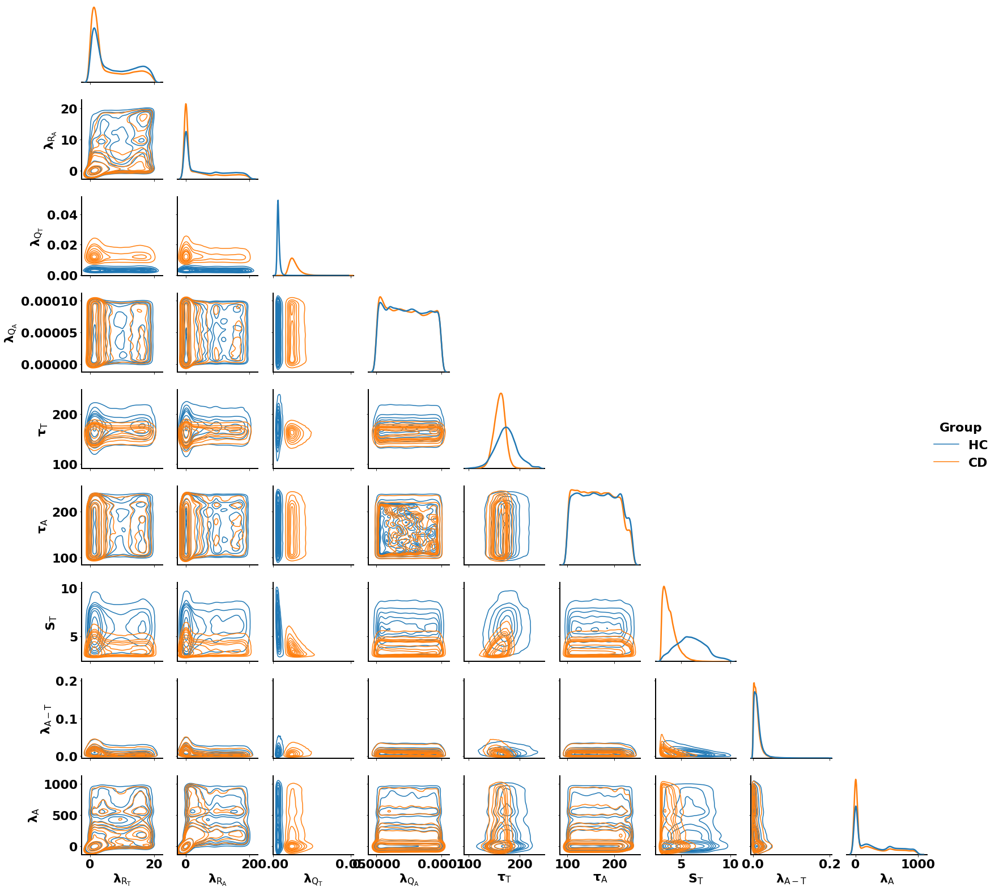

In [82]:
# labels = ['Aud Noise Scale', 
#           'Somato Noise Scale', 
#           'TSE Process Scale',
#           'ASE Process Scale',
#           'ArticToTask Scale',
#           'TaskSFCLaw Noise Scale',
#           'ArticSFCLaw Noise Scale',
#           'TSE Covariance Scale',
#           'ASE Covariance Scale']

lw = 2.5  # adjust to taste (e.g., 2, 3, 4)

# Append Healthy data
px_healthy = pd.DataFrame(samples_healthy).astype("float")
px_healthy.set_axis(labels2, axis="columns", inplace=True)
px_healthy["Group"] = "HC"

# Append CD
px = pd.DataFrame(samples_cereb).astype("float")
px.set_axis(labels2, axis="columns", inplace=True)
px["Group"] = "CD"

# px2 = px_testFACTS
px2 = pd.concat([px,px_healthy], ignore_index=True)

g = sns.PairGrid(px2, diag_sharey=False, corner=True, hue="Group", hue_order=['HC','CD'])

# g = sns.pairplot(px, corner=True, kind='hist')
g.map_lower(sns.kdeplot, linewidth=lw)
g.map_diag(sns.kdeplot, linewidth=lw)
g.add_legend()

In [105]:
import matplotlib as mpl
import seaborn as sns

tsz=40
# Global font sizing + bold
mpl.rcParams.update({
    "font.size": tsz,          # base font size
    "font.weight": "bold",    # default text weight
    "axes.labelsize": tsz,
    "axes.labelweight": "bold",
    "axes.titlesize": tsz,
    "axes.titleweight": "bold",
    "xtick.labelsize": tsz,
    "ytick.labelsize": tsz,
    "legend.fontsize": tsz,
    "figure.titlesize": tsz,
})

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/seaborn/distributions.py:1188: UserWarning: The following kwargs were not used by contour: 'linewidth'
  

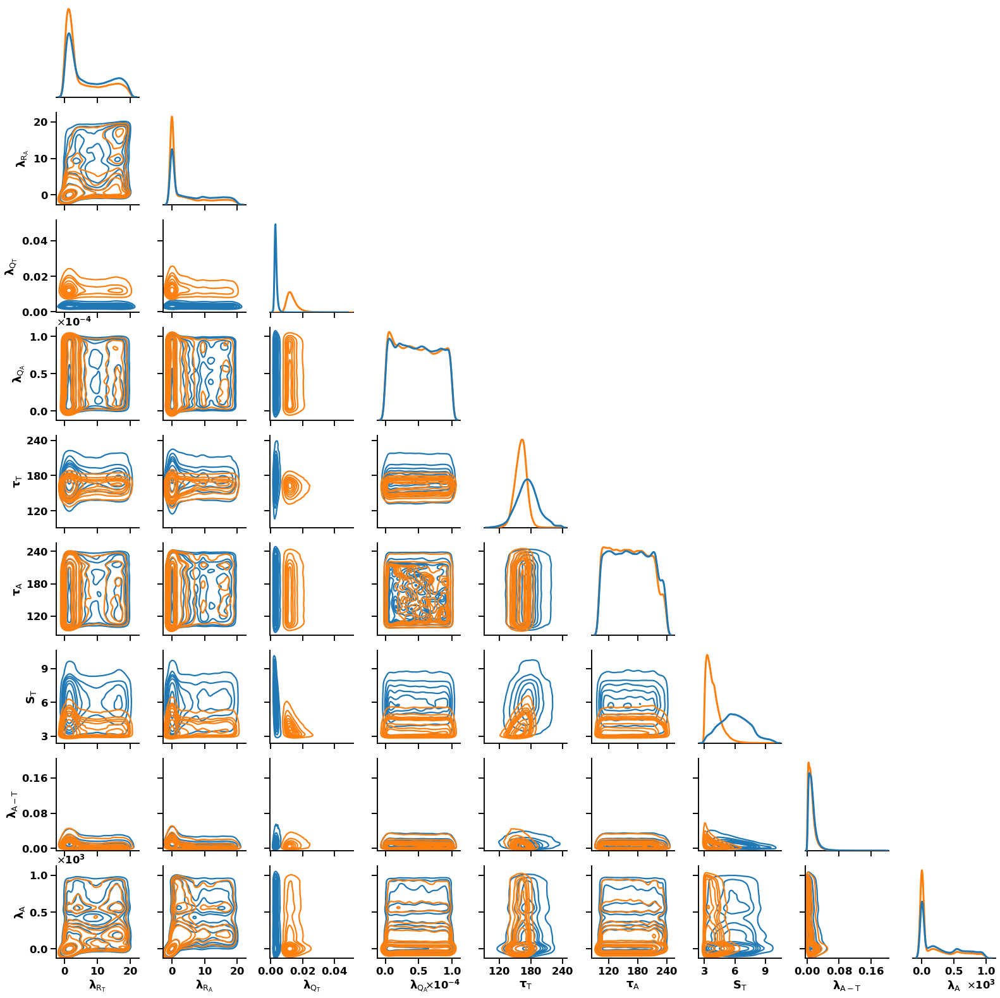

In [108]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker

# --- Build dataframe ---
px_healthy = pd.DataFrame(samples_healthy).astype(float)
px_healthy.set_axis(labels2, axis="columns", inplace=True)
px_healthy["Group"] = "HC"

px = pd.DataFrame(samples_cereb).astype(float)
px.set_axis(labels2, axis="columns", inplace=True)
px["Group"] = "CD"

px2 = pd.concat([px, px_healthy], ignore_index=True)

# --- Plot (recompute KDEs) ---
plt.close("all")
# sns.set_context("talk")  # optional: slightly larger text

lw = 3.0
g = sns.PairGrid(
    px2,
    diag_sharey=False,
    corner=True,
    hue="Group",
    hue_order=["HC", "CD"],
#     height=2.2,   # per-panel size; increase if still crowded
#     aspect=1.0
)

# kdeplot params that are common/robust; adjust if you like
g.map_lower(sns.kdeplot, linewidth=lw)
g.map_diag(sns.kdeplot, linewidth=lw)

# g.add_legend()

# --- Make tick labels shorter + reduce overlap ---
# 1) fewer ticks
# 2) scientific notation for small/large values
for ax in g.axes.flat:
    if ax is None:
        continue

    ax.xaxis.set_major_locator(mticker.MaxNLocator(nbins=3))
    ax.yaxis.set_major_locator(mticker.MaxNLocator(nbins=3))

    # Use scientific notation outside [-3, 3] powers, e.g., 5e-05 instead of 0.00005
    ax.ticklabel_format(axis="both", style="sci", scilimits=(-3, 3), useMathText=True)

    # Optional: slightly smaller tick font if still tight
#     ax.tick_params(axis="both", labelsize=9)

# Tighten layout and render
# g.fig.tight_layout()
plt.show()

# If display is still unreliable in your environment, always write an image:
# g.fig.savefig("pairgrid_kde.png", dpi=300, bbox_inches="tight")


In [90]:
plt.show()

### Plot estimated formant to observed formant

In [39]:
# from scipy import stats

# plt.rcParams.update({'font.size': 22})

# torch.set_printoptions(sci_mode=True)

# posterior_modes_FACTS = stats.mode(samples_test_FACTS,0)
# posterior_modes_FACTS = torch.from_numpy(posterior_modes_FACTS[0][0])
# print(f'poster modes {posterior_modes_FACTS}')
# # print(f'original theta {original_theta}')
# # pdb.set_trace()

# all_simulated_formant_facts = np.array([])
# for ii in range(2):
#     all_simulated_formant_facts = FACTS(posterior_modes_FACTS)
#     if ii == 0:
#         all_simulated_formant = all_simulated_formant_facts
#     else:
#         all_simulated_formant = np.vstack((all_simulated_formant, all_simulated_formant_facts))
        
# #pdb.set_trace()
# # simulated_formant = FACTS(posterior_modes_FACTS)
# mean_formants = np.mean(all_simulated_formant, axis=0)
# ci = np.std(all_simulated_formant, axis=0)

# x_time = np.linspace(-200,700, num=140)

# plt.figure(figsize=(14,10))
# # Plot "Estimations"
# plt.plot(x_time, mean_formants, label='estimated from posteriors')
# plt.fill_between(x_time, (mean_formants-ci), (mean_formants+ci), color='b', alpha=.1)

# # Plot Empirical Data
# plt.plot(x_time, simulated_test, 'k',label='FACTS output')
# # plt.fill_between(x_time, (simulated_test-healthy_ci), (simulated_test+healthy_ci), color='k', alpha=.1)

# #  plt.axvline(x = 0, color = 'grey', ls=':')
# plt.legend()

# plt.xlabel('Time (ms)')
# plt.ylabel('Formant response (Hz)')
# plt.title('FACTS Empirical')

['Aud Noise Scale Est', 'Somato Noise Scale Est', 'TSE Process Scale', 'ASE Process Scale', 'Aud delay', 'Somato delay', 'Spring constant', 'ArticToTask Noise Scale', 'ArticSFCLaw Noise Scale']
tensor([2.347606420516967773437500000000e+00,
        9.296282223658636212348937988281e-05,
        2.565575297921895980834960937500e-03,
        6.907017086632549762725830078125e-05,
        1.203872756958007812500000000000e+02,
        1.227693481445312500000000000000e+02,
        3.159259796142578125000000000000e+00,
        2.202252857387065887451171875000e-02,
        5.570527911186218261718750000000e-02])
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02202252857387066
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.02202252857387066
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


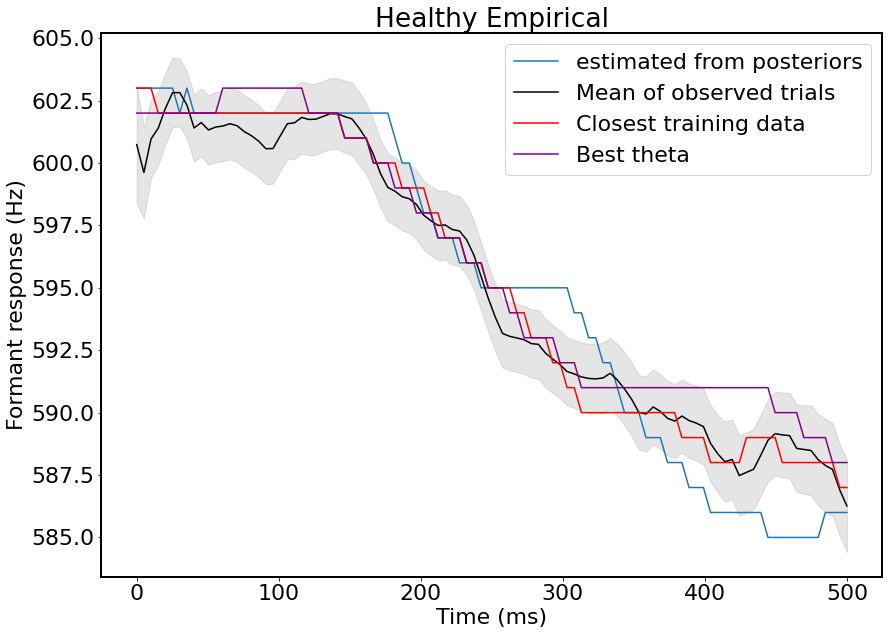

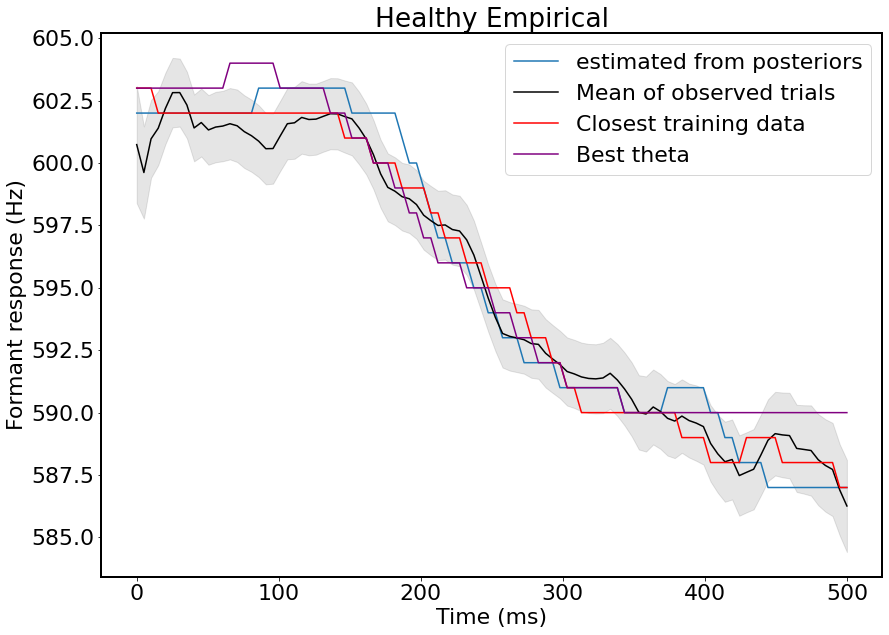

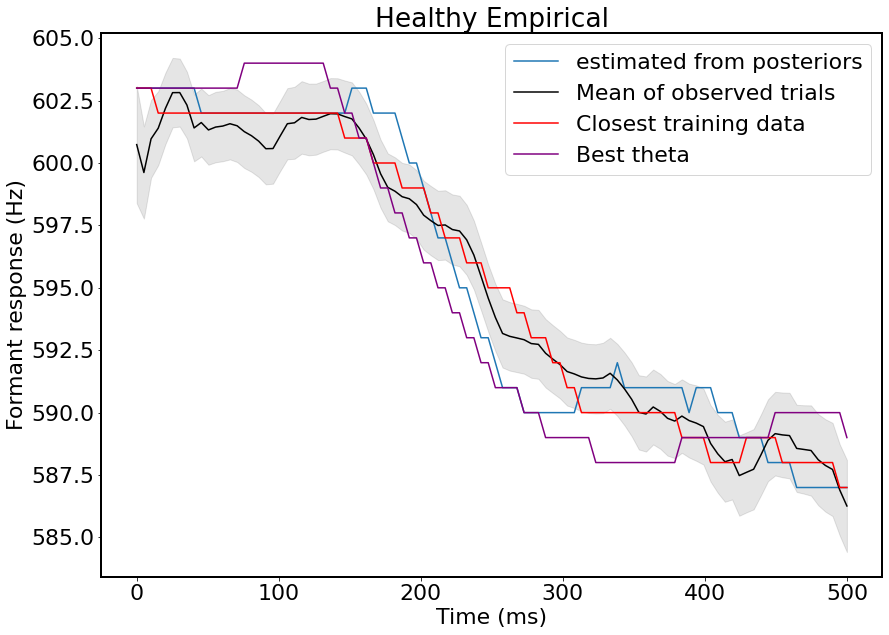

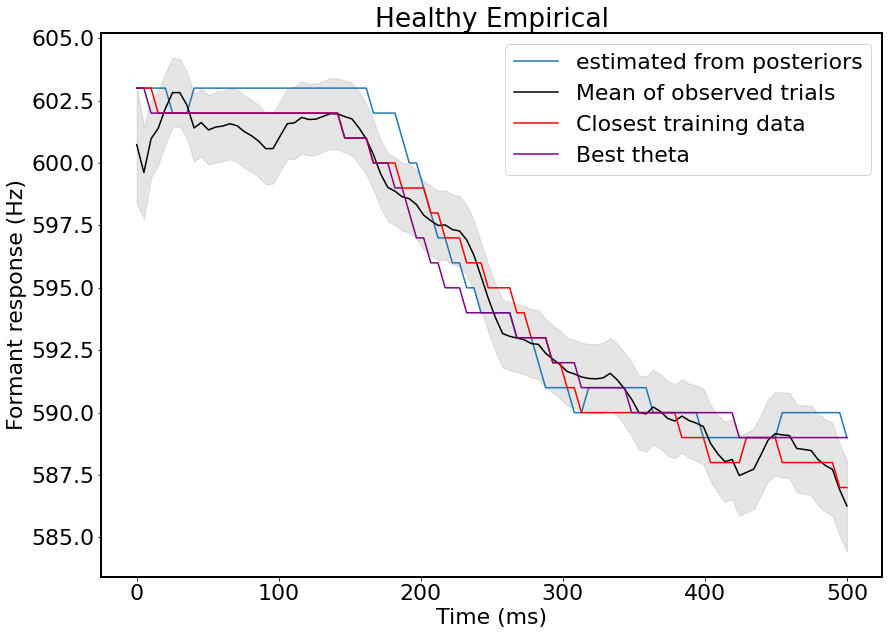

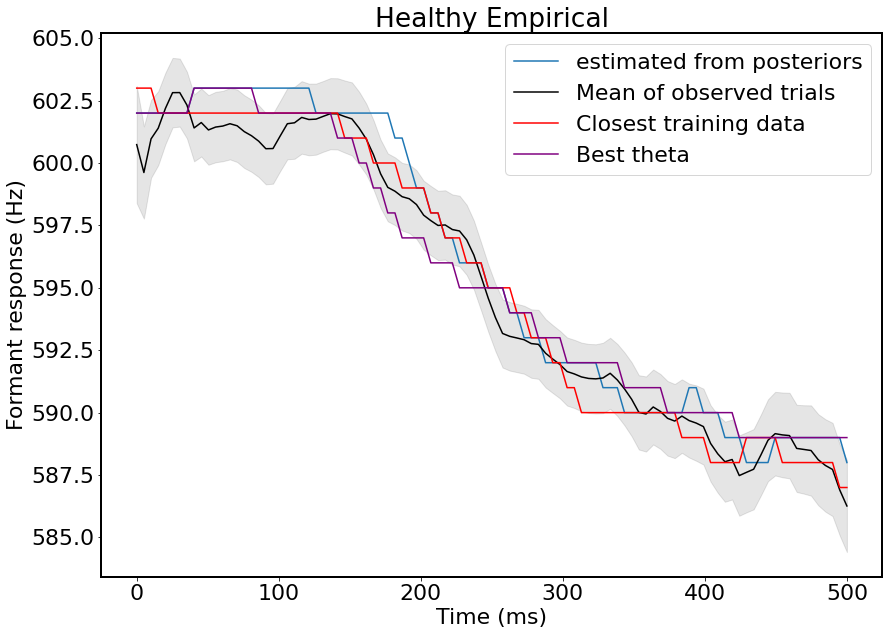

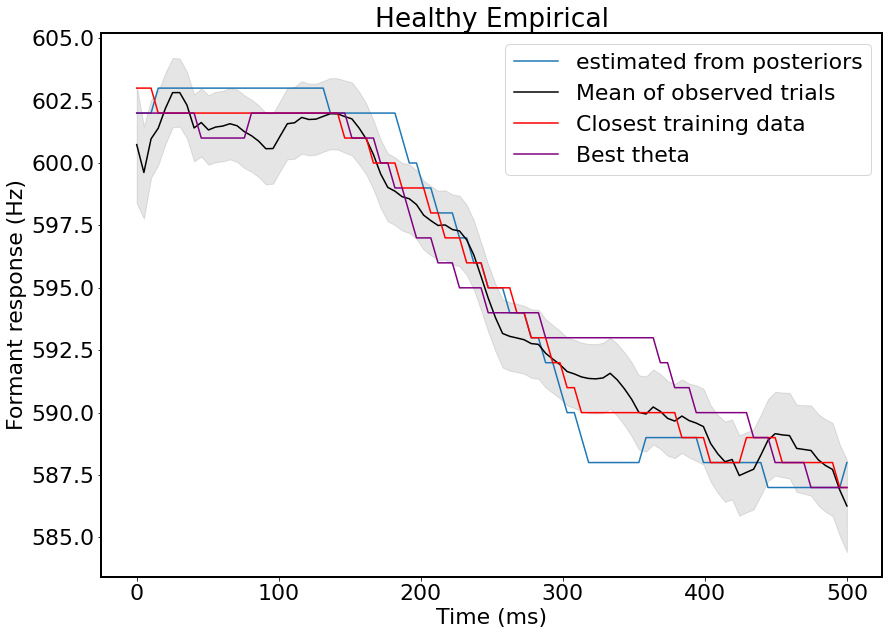

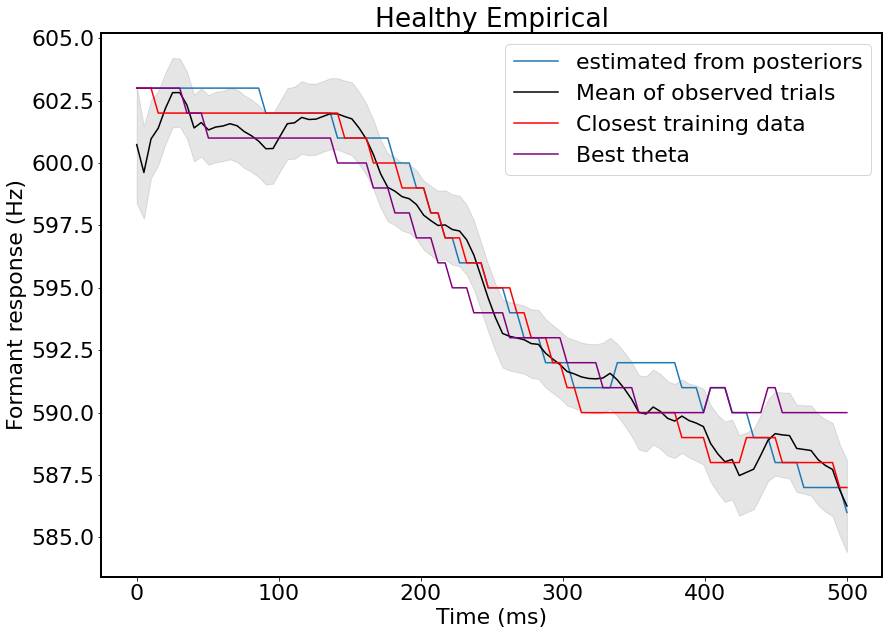

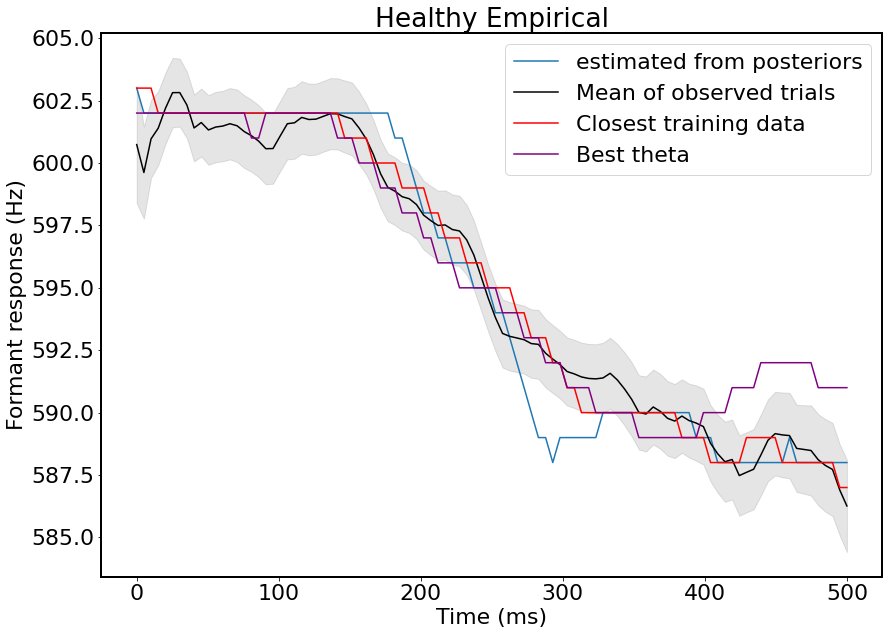

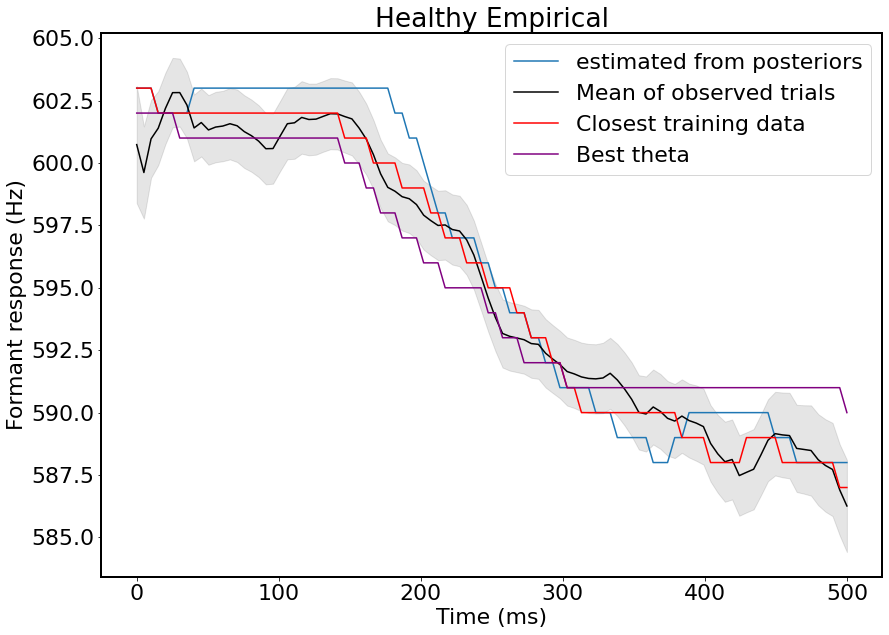

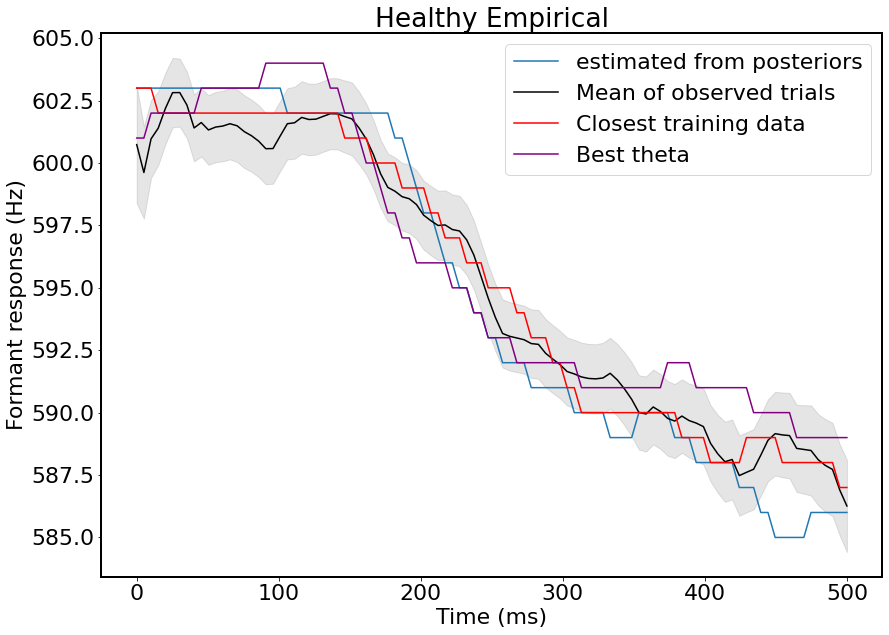

In [40]:
torch.set_printoptions(sci_mode=False)
torch.set_printoptions(precision=30)

print(labels)
# posterior_modes_HC = stats.mode(samples_healthy,0)
# posterior_modes_HC = torch.from_numpy(posterior_modes_HC[0][0])

posterior_modes_HC = get_modes(samples_healthy)
# posterior_modes_HC = np.average(samples_healthy, axis=0)
# posterior_modes_HC = np.median(samples_healthy, axis=0)
posterior_modes_HC = torch.from_numpy(posterior_modes_HC)
# print(f'poster modes {posterior_modes_HC}')
# print(f'original theta {0.005, 0.005, 0.01, 0.1, 0.0000001, 0.0000001, 100, 50, 3}')
# pdb.set_trace()


# posterior_modes_HC_manual_test = posterior_modes_HC.detach().clone()
# posterior_modes_HC_manual_test[-2] = 0.98
# posterior_modes_HC_manual_test[2] = 0.04
# posterior_modes_HC_manual_test[5] = posterior_modes_HC[5] * 100

# posterior_modes_HC_manual_test = torch.tensor([0.0005,
#             0.0005,
#             0.1,
#             0.000001, 
#             0.000001, 
#             0.000001,
#             150.0,
#             100.0,
#             100.0,
#             75.0,
#             0.958,
#             6.0]) 

# posterior_modes_HC2 = posterior_modes_HC.clone()
# posterior_modes_HC2[2] = posterior_modes_HC_manual_test[2]

# posterior_modes_HC = find_multivariate_mode(samples_healthy, bandwidth=1)

best_theta_hc = all_theta[indicesHC[0],:]
print(best_theta_hc)

HC_simulations = []
for ii in range(10):
    simulated_formant_H = FACTS(posterior_modes_HC)
#     print(f'posterior_modes_HC_manual_test {posterior_modes_HC_manual_test}')
    simulated_formant_manual_test = FACTS(best_theta_hc)
    HC_simulations.append(simulated_formant_H)
#     pdb.set_trace() 
    # Plot data
    x_time = np.linspace(0,500, num=100)
    plt.figure(figsize=(14,10))
    plt.plot(x_time, simulated_formant_H[40:140], label='estimated from posteriors')

    plt.plot(x_time, healthy_mean_synth[40:140], 'k',label='Mean of observed trials')
    plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='k', alpha=.1)
    plt.plot(x_time, all_x_ds[indicesHC[0:1],40:].T, color='red', label='Closest training data')

    plt.plot(x_time, simulated_formant_manual_test[40:140], 'purple',label='Best theta')
#         plt.axvline(x = 0, color = 'grey', ls=':')
    plt.legend()

    plt.xlabel('Time (ms)')
    plt.ylabel('Formant response (Hz)')
    plt.title('Healthy Empirical')

# print(f'difference of parameter values = {posterior_modes_HC - posterior_modes_HC_manual_test}')


/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  """Entry point for launching an IPython kernel.
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  """Entry poi

Text(0.5, 1.0, 'Healthy Empirical')

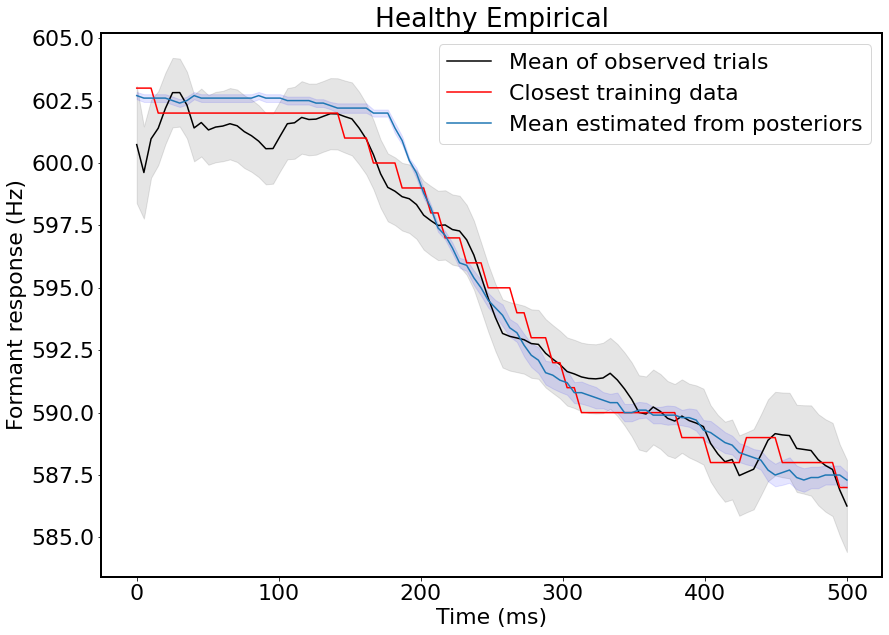

In [41]:
HC_simulations_np = np.array(HC_simulations)
HC_simulations_np = np.stack(HC_simulations_np)
HC_simulations_np.shape

mean_HC_simulations = np.mean(HC_simulations_np[:,40:140], axis=0)
Sem_HC_simulations = np.std(HC_simulations_np[:,40:140], axis=0) / np.sqrt(HC_simulations_np.shape[0])


plt.figure(figsize=(14,10))
plt.plot(x_time, healthy_mean_synth[40:140], 'k',label='Mean of observed trials')
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='k', alpha=.1)
plt.plot(x_time, all_x_ds[indicesHC[0:1],40:].T, color='red', label='Closest training data')

plt.plot(x_time, mean_HC_simulations, label='Mean estimated from posteriors')
plt.fill_between(x_time, (mean_HC_simulations-Sem_HC_simulations), (mean_HC_simulations+Sem_HC_simulations), color='blue', alpha=.1)


plt.legend()

plt.xlabel('Time (ms)')
plt.ylabel('Formant response (Hz)')
plt.title('Healthy Empirical')

In [42]:
np.set_printoptions(precision=4)
pd.set_option('display.float_format', '{:.7f}'.format)
np.set_printoptions(suppress=True)

best_HC_theta = all_theta[indicesHC[0],:]
print(best_HC_theta)
this_df_HC = pd.DataFrame({'Parameter label': labels,
#                         'posterior_modes_CD_manual_test': posterior_modes_HC_manual_test.numpy().tolist(),
                        'best_training_data':best_HC_theta.numpy().tolist(),
                       'posterior_modes_C': posterior_modes_HC.numpy().tolist(),
                       'difference in parameter tensors': (posterior_modes_HC - best_HC_theta).numpy().tolist(),
                       'Percent diff': ((posterior_modes_HC - best_HC_theta)/best_HC_theta*100).numpy().tolist()
                       })

display(this_df_HC)


tensor([2.347606420516967773437500000000e+00,
        9.296282223658636212348937988281e-05,
        2.565575297921895980834960937500e-03,
        6.907017086632549762725830078125e-05,
        1.203872756958007812500000000000e+02,
        1.227693481445312500000000000000e+02,
        3.159259796142578125000000000000e+00,
        2.202252857387065887451171875000e-02,
        5.570527911186218261718750000000e-02])


,Parameter label,best_training_data,posterior_modes_C,difference in parameter tensors,Percent diff
0,Aud Noise Scale Est,2.3476064,1.3212506,-1.0263558,-43.7192470
1,Somato Noise Scale Est,0.0000930,0.0600609,0.0599679,64507.4334391
2,TSE Process Scale,0.0025656,0.0029754,0.0004098,15.9742900
3,ASE Process Scale,0.0000691,0.0000059,-0.0000632,-91.4337347
4,Aud delay,120.3872757,173.3513643,52.9640886,43.9947563
5,Somato delay,122.7693481,156.0581304,33.2887823,27.1148970
6,Spring constant,3.1592598,5.5996945,2.4404347,77.2470417
7,ArticToTask Noise Scale,0.0220225,0.0046017,-0.0174209,-79.1047653
8,ArticSFCLaw Noise Scale,0.0557053,2.0015339,1.9458286,3493.0775582


# Test a single parameter 
test_parameter_at_this_index = 8
# best_test_F1 = all_x_ds[indicesHC[0:1],40:].T
best_test_params = all_theta[indicesHC[0:1]][0]
print(best_test_params)

# test_f1 = FACTS(best_test_params)

# best_test_params2 = best_test_params.clone()
# best_test_params2[test_parameter_at_this_index] = best_test_params2[test_parameter_at_this_index] * 10
# test2_f1 = FACTS(best_test_params2)

# best_test_params3 = best_test_params.clone()
# best_test_params3[test_parameter_at_this_index] = best_test_params3[test_parameter_at_this_index] * 100
# test3_f1 = FACTS(best_test_params3)

# best_test_params4 = best_test_params.clone()
# best_test_params4[test_parameter_at_this_index] = best_test_params4[test_parameter_at_this_index] * 1000
# # test4_f1 = FACTS(best_test_params4)

best_test_params5 = best_test_params.clone()
best_test_params5[test_parameter_at_this_index] = best_test_params5[test_parameter_at_this_index] * 1e5
test5_f1 = FACTS(best_test_params5)

print(best_test_params[test_parameter_at_this_index], 
      best_test_params2[test_parameter_at_this_index], 
      best_test_params3[test_parameter_at_this_index], 
      best_test_params4[test_parameter_at_this_index], 
      best_test_params5[test_parameter_at_this_index])

plt.figure(figsize=(14,10))
plt.plot(x_time, healthy_mean_synth[40:140], 'k',label='Mean of observed trials')
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='k', alpha=.1)
plt.plot(x_time, test_f1[40:140], color='red', label='test1')
plt.plot(x_time, test2_f1[40:140], color='orange', label='test*10')
plt.plot(x_time, test3_f1[40:140], color='magenta', label='test*100')
plt.plot(x_time, test4_f1[40:140], color='green', label='test*1000')
plt.plot(x_time, test5_f1[40:140], color='blue', label='test*1e5')

# plt.plot(x_time, mean_HC_simulations, label='Mean estimated from posteriors')
# plt.fill_between(x_time, (mean_HC_simulations-Sem_HC_simulations), (mean_HC_simulations+Sem_HC_simulations), color='blue', alpha=.1)


plt.legend()

plt.xlabel('Time (ms)')
plt.ylabel('Formant response (Hz)')
plt.title('Testing a single parameter')

['Aud Noise Scale Est', 'Somato Noise Scale Est', 'TSE Process Scale', 'ASE Process Scale', 'Aud delay', 'Somato delay', 'Spring constant', 'ArticToTask Noise Scale', 'ArticSFCLaw Noise Scale']
tensor([1.241207262031340574637283680204e+00,
        2.002069914903683786611132688904e-02,
        1.192162799028058904615701152352e-02,
        5.815546054464847484640008939971e-06,
        1.632331423067354307931964285672e+02,
        1.095307258323386889742323546670e+02,
        3.268003821492314386887301225215e+00,
        2.699946380566245560800320291150e-03,
        1.000958233624249293924890480412e+00], dtype=torch.float64)
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.

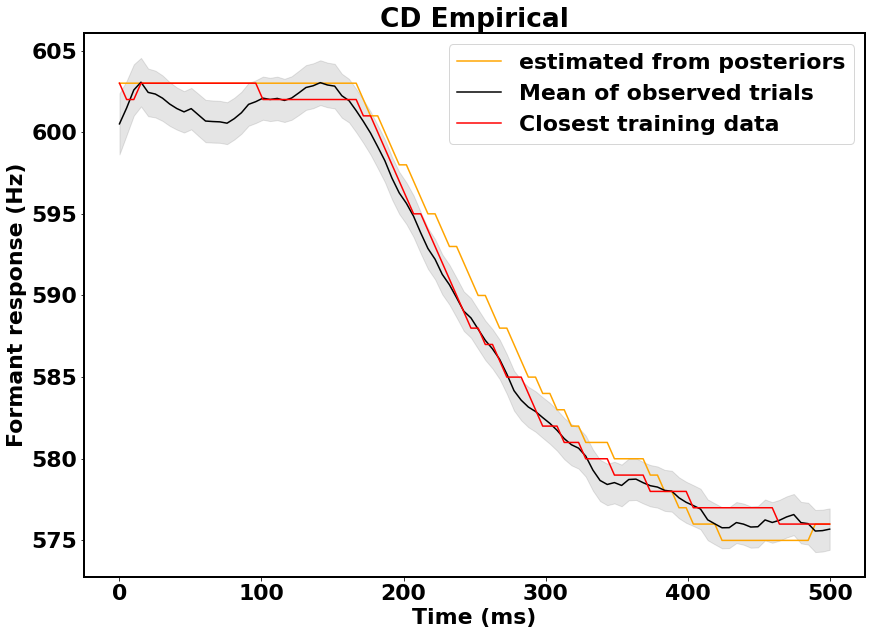

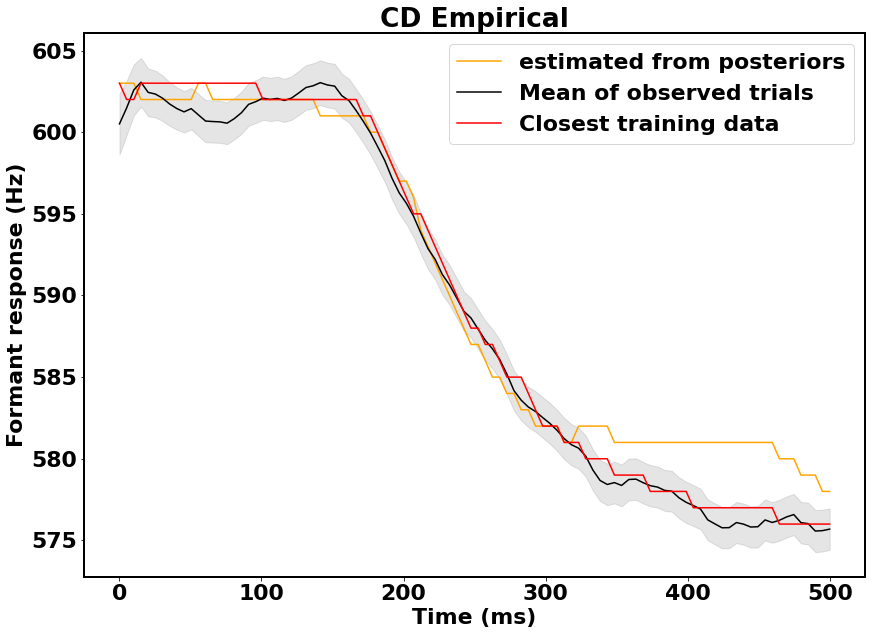

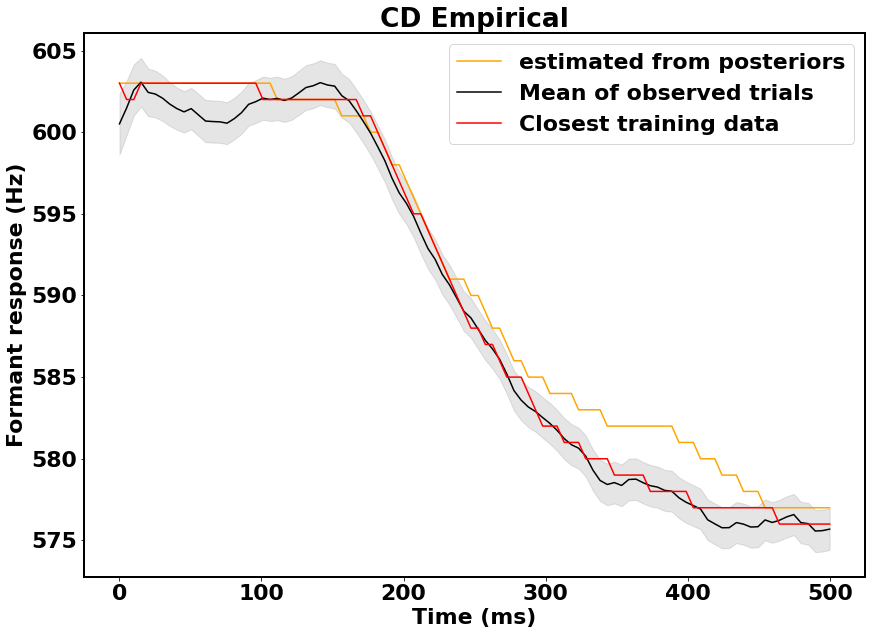

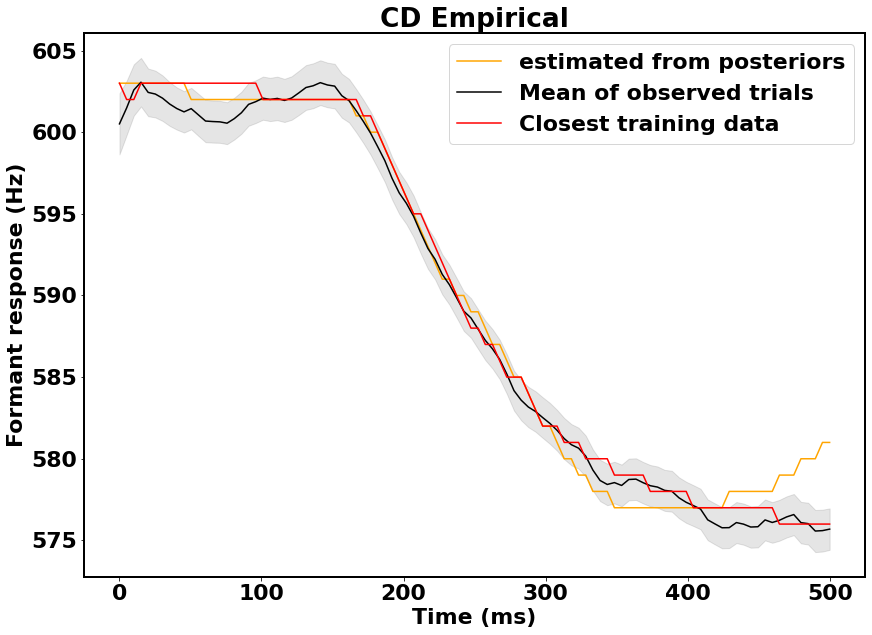

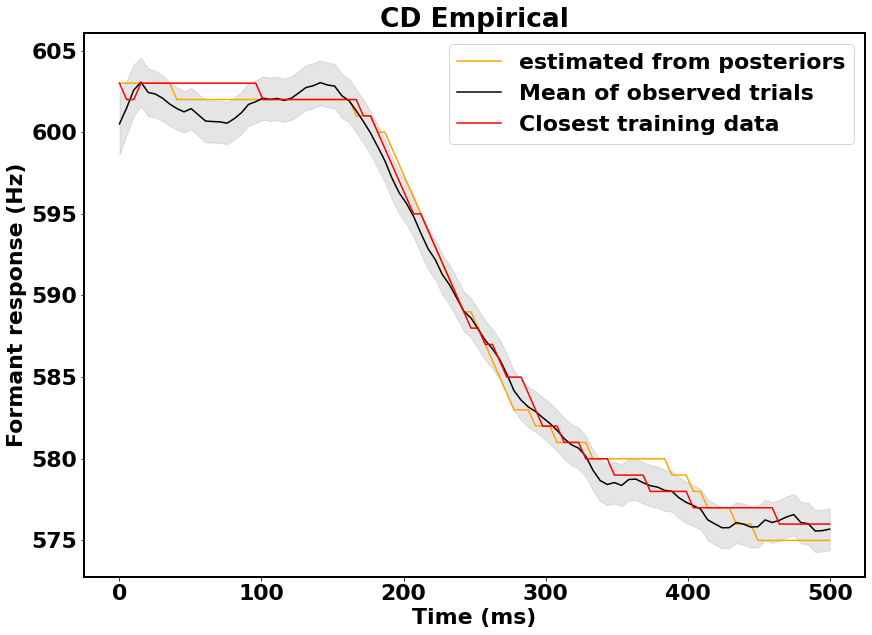

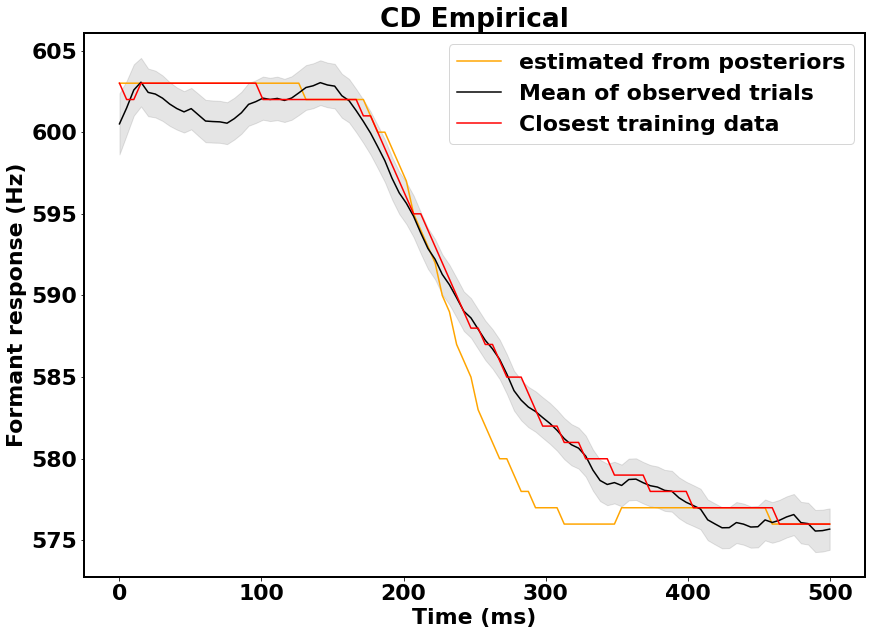

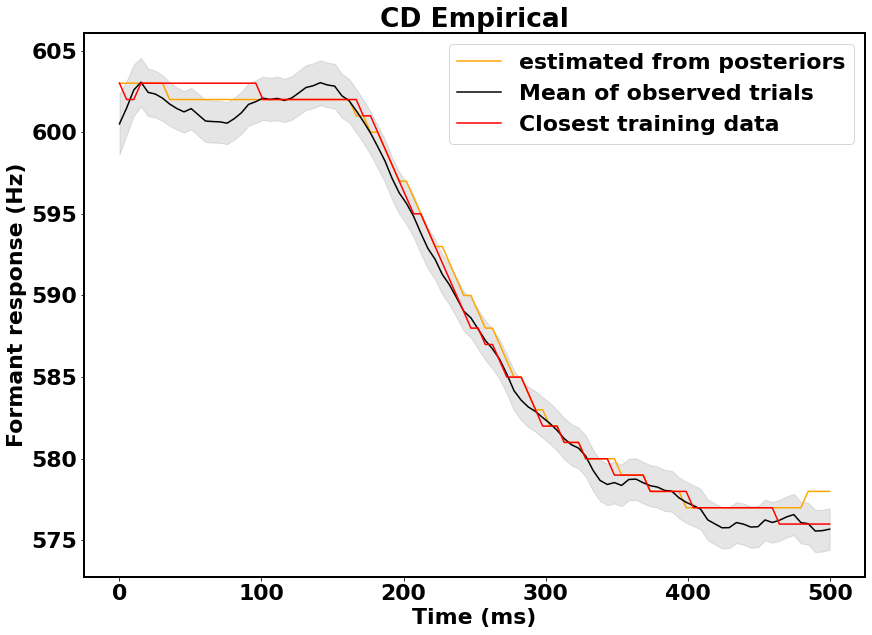

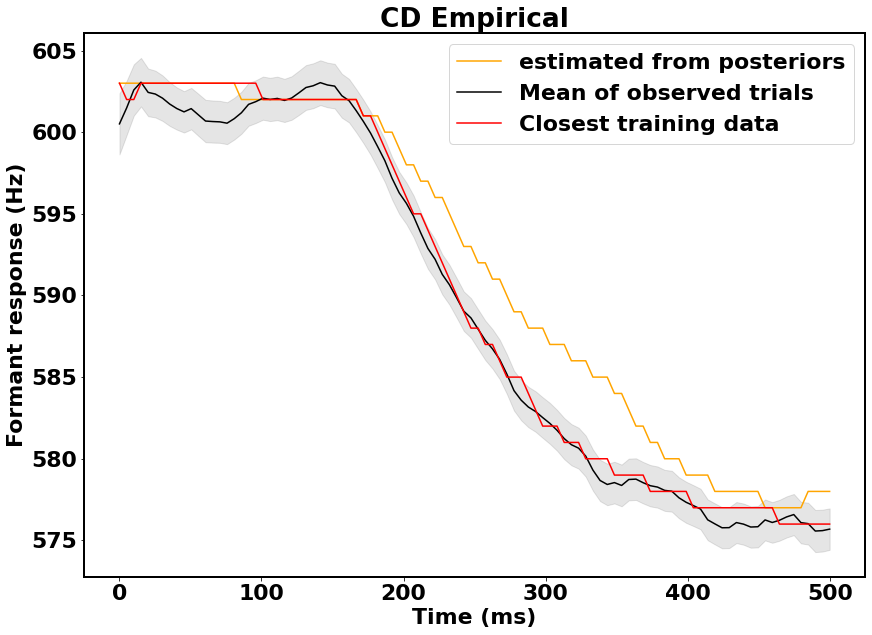

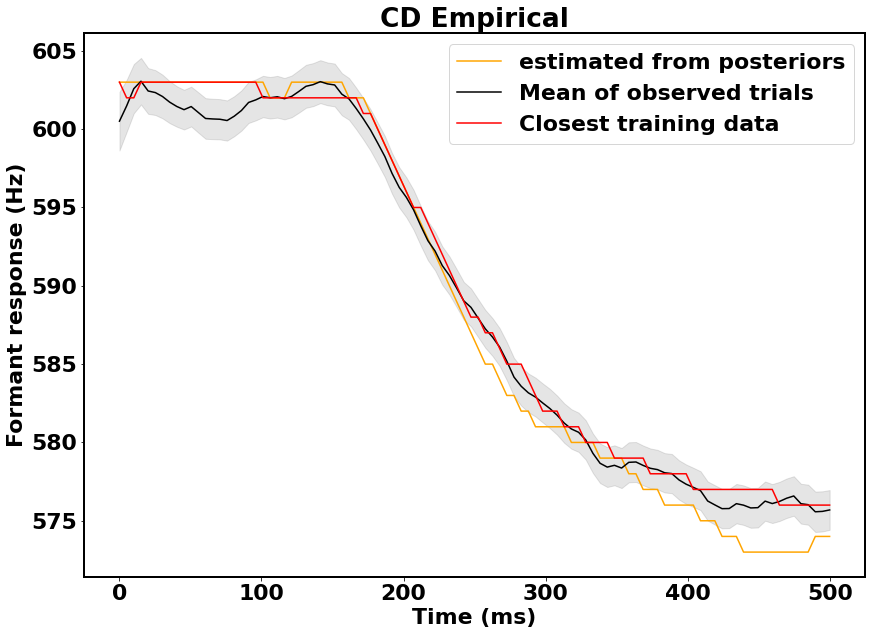

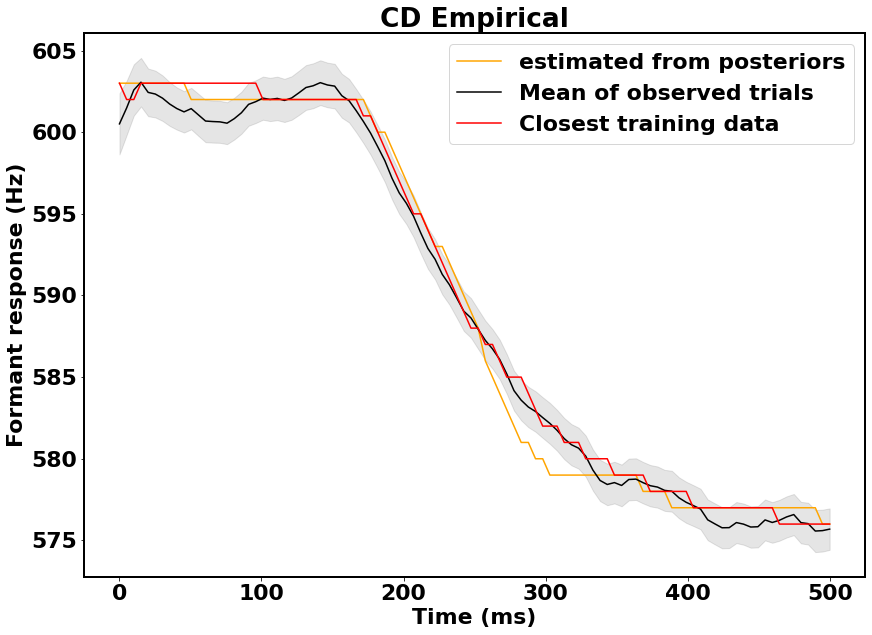

In [77]:
print(labels)
# posterior_modes_C = stats.mode(samples_cereb,0)
# posterior_modes_C = torch.from_numpy(posterior_modes_C[0][0])

posterior_modes_C = get_modes(samples_cereb)
# posterior_modes_C = np.median(samples_cereb, axis=0)
# posterior_modes_C = np.average(samples_cereb, axis=0)
posterior_modes_C = torch.from_numpy(posterior_modes_C)

# print(f'poster modes {posterior_modes_C}')
# print(posterior_modes.shape)
# pdb.set_trace()


# samples_cereb_multi = posterior.sample((sample_size,), x=smoothed_cereb)
# samples_cereb_2 = posterior.sample((1000,), x=cereb_mean_synth)
# samples_cereb_multi = posterior_CD_SNPE_loaded.sample((500,), x=cereb_mean_synth)
# posterior_modes_C = find_multivariate_mode(samples_cereb, bandwidth=1)#, kernel='epanechnikov')
print(posterior_modes_C)

#posterior_modes_C_manual_test = posterior_modes_C.detach().clone()
posterior_modes_CD_manual_test = torch.tensor([0.005,
            0.0005,
            4.0,
            0.0000001, 
            0.0001, 
            0.000001,
            150.0,
            100.0,
            100.8,
            55.0,
            0.955,
            6.0])


# print(f'posterior_modes_C_manual_test {posterior_modes_C_manual_test}')
# posterior_modes_C2 = posterior_modes_C.clone()
# posterior_modes_C2[3] = posterior_modes_CD_manual_test[3]

best_theta = all_theta[indices[0:1],:]
# Sort by sum
CD_simulations = []
for ii in range(10):
    #pdb.set_trace()
    simulated_formant_C = FACTS(posterior_modes_C)
    CD_simulations.append(simulated_formant_C)
#     simulated_formant_manual_test = FACTS(best_theta)
    
    x_time = np.linspace(0,500, num=100)

    plt.figure(figsize=(14,10))
    plt.plot(x_time, simulated_formant_C[40:140], 'orange', label='estimated from posteriors')
    plt.plot(x_time, cereb_mean_synth[40:140], 'k',label='Mean of observed trials')
#     plt.plot(x_time, all_simulated_formant_facts
    plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='k', alpha=.1)
#     plt.plot(x_time, simulated_formant_manual_test[40:140], 'red',label='best theta tuning')
#     plt.plot(x_time, simulated_formant_manual_test2[40:140], 'magenta',label='Manual test')
    plt.plot(x_time, all_x_ds[indices[0:1],40:].T, label='Closest training data', color='red')
#     plt.axvline(x = 0, color = 'grey', ls=':')
    plt.legend()

    plt.xlabel('Time (ms)')
    plt.ylabel('Formant response (Hz)')
    plt.title('CD Empirical')
    
# print(f'% difference in parameter tensors {(posterior_modes_C - posterior_modes_CD_manual_test)/posterior_modes_CD_manual_test}')
print(f'% difference in parameter tensors {(posterior_modes_C - best_theta)/best_theta*100}')



/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  """Entry point for launching an IPython kernel.
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  """Entry poi

Text(0.5, 1.0, 'CD Empirical')

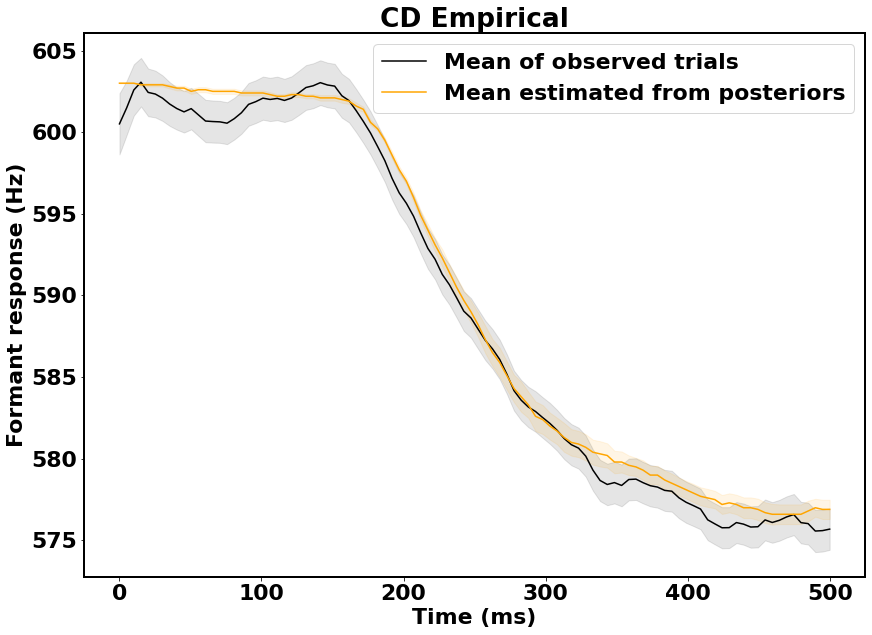

In [78]:
CD_simulations_np = np.array(CD_simulations)
CD_simulations_np = np.stack(CD_simulations_np)
CD_simulations_np.shape

mean_CD_simulations = np.mean(CD_simulations_np[:,40:140], axis=0)
Sem_CD_simulations = np.std(CD_simulations_np[:,40:140], axis=0) / np.sqrt(HC_simulations_np.shape[0])
print(f'SEM CD; {Sem_CD_simulations}')

plt.figure(figsize=(14,10))
plt.plot(x_time, cereb_mean_synth[40:140], 'k',label='Mean of observed trials')
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='k', alpha=.1)

plt.plot(x_time, mean_CD_simulations, label='Mean estimated from posteriors', color='orange')
plt.fill_between(x_time, (mean_CD_simulations-Sem_CD_simulations), (mean_CD_simulations+Sem_CD_simulations), color='orange', alpha=.1)


plt.legend()

plt.xlabel('Time (ms)')
plt.ylabel('Formant response (Hz)')
plt.title('CD Empirical')

In [79]:
np.set_printoptions(precision=4)
pd.set_option('display.float_format', '{:.7f}'.format)

# posterior_modes_C - best_theta)/best_theta
print(best_theta[0].tolist())
print((posterior_modes_C - best_theta[0]).numpy().tolist())
this_df = pd.DataFrame({'Parameter label': labels,
                        'best training data': best_theta[0].tolist(),
                       'posterior_modes_C': posterior_modes_C.numpy().tolist(),
                       'difference in parameter tensors': (posterior_modes_C - best_theta[0]).numpy().tolist(),
                       'Percent diff': ((posterior_modes_C - best_theta[0])/best_theta[0]*100).numpy().tolist()
                       })

display(this_df)

[20.95450210571289, 9.42185870371759e-05, 0.009688704274594784, 3.12329939333722e-05, 156.06753540039062, 100.98104858398438, 3.8121514320373535, 0.00767512945458293, 0.033495474606752396]
[-19.71329484368155, 0.019926480561999662, 0.0022329237156858053, -2.5417447878907353e-05, 7.165606906344806, 8.549677248354314, -0.5441476105450391, -0.0049751830740166845, 0.9674627590174969]


,Parameter label,best training data,posterior_modes_C,difference in parameter tensors,Percent diff
0,Aud Noise Scale Est,20.9545021,1.2412073,-19.7132948,-94.0766559
1,Somato Noise Scale Est,0.0000942,0.0200207,0.0199265,21149.2033458
2,TSE Process Scale,0.0096887,0.0119216,0.0022329,23.0466701
3,ASE Process Scale,0.0000312,0.0000058,-0.0000254,-81.3801198
4,Aud delay,156.0675354,163.2331423,7.1656069,4.5913501
5,Somato delay,100.9810486,109.5307258,8.5496772,8.4666156
6,Spring constant,3.8121514,3.2680038,-0.5441476,-14.2740293
7,ArticToTask Noise Scale,0.0076751,0.0026999,-0.0049752,-64.8221389
8,ArticSFCLaw Noise Scale,0.0334955,1.0009582,0.9674628,2888.3387096


(array([-100.,    0.,  100.,  200.,  300.,  400.,  500.,  600.]),
 <a list of 8 Text major ticklabel objects>)

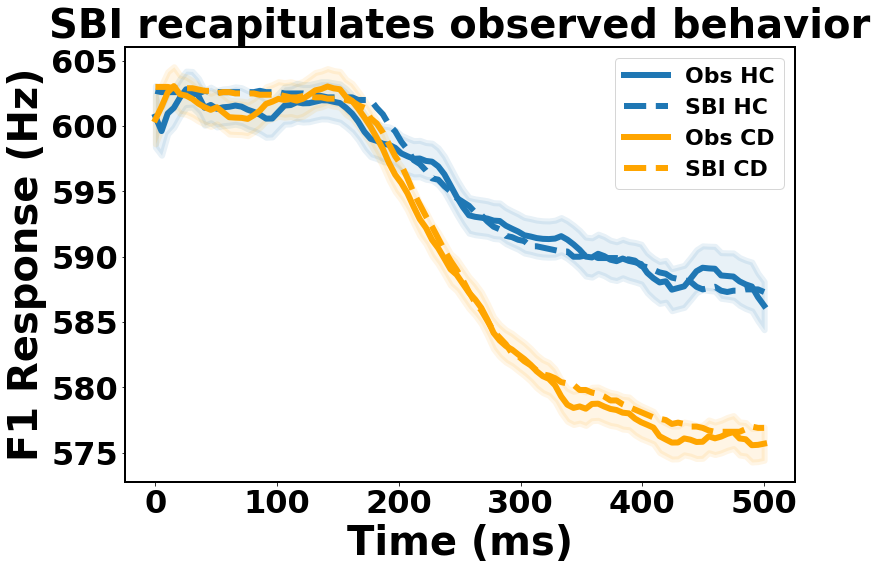

In [80]:
x_time = np.linspace(0,500, num=100)

plt.rcParams['font.weight'] = 'bold'          # axes and labels
plt.rcParams['axes.labelweight'] = 'bold'     # axis labels
plt.rcParams['axes.titleweight'] = 'bold'  
ft_size = 40

plt.figure(figsize=(12,8))
plt.plot(x_time, healthy_mean_synth[40:140], color=blue_from_cycle,label='Obs HC', linewidth=6)
# plt.plot(x_time, simulated_formant_H[40:140], 'blue', linestyle='--' ,label='Estimated from posteriors')
plt.plot(x_time, mean_HC_simulations, color=blue_from_cycle, linestyle='--' ,label='SBI HC', linewidth=6 )
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color=blue_from_cycle, alpha=.1, linewidth=6)


plt.plot(x_time, cereb_mean_synth[40:140], 'orange',label='Obs CD', linewidth=6)
# plt.plot(x_time, simulated_formant_C[40:140], 'orange', linestyle='--' ,label='Estimated from posteriors')
plt.plot(x_time, mean_CD_simulations, 'orange', linestyle='--' ,label='SBI CD', linewidth=6)
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1, linewidth=6)

plt.xlabel('Time (ms)', fontsize=ft_size)
plt.ylabel('F1 Response (Hz)', fontsize=ft_size)

plt.legend(fontsize='medium')
plt.title('SBI recapitulates observed behavior', fontsize=ft_size)
plt.yticks(fontsize=32, fontweight='bold')
plt.xticks(fontsize=32, fontweight='bold')


# Plot smoothed
# smoothed_cereb = smooth_np_convolve(cereb_mean_synth, 9)
# smoothed_healthy = smooth_np_convolve(healthy_mean_synth, 9)
# plt.figure(figsize=(12,8))
# plt.plot(x_time, smoothed_healthy[40:140], 'blue',label='SBI HC')
# # plt.plot(x_time, simulated_formant_H[40:140], 'blue', linestyle='--' ,label='Estimated from posteriors')
# plt.plot(x_time, mean_HC_simulations, 'blue', linestyle='--' ,label='Estimated', linewidth=6)
# plt.fill_between(x_time, (smoothed_healthy[40:140]-healthy_ci_ds), (smoothed_healthy[40:140]+healthy_ci_ds), color='blue', alpha=.1, linewidth=6)


# plt.plot(x_time, smoothed_cereb[40:140], 'orange',label='Empricial CD')
# # plt.plot(x_time, simulated_formant_C[40:140], 'orange', linestyle='--' ,label='Estimated from posteriors')
# plt.plot(x_time, mean_CD_simulations, 'orange', linestyle='--' ,label='Estimated')
# plt.fill_between(x_time, (smoothed_cereb[40:140]-cereb_ci_ds), (smoothed_cereb[40:140]+cereb_ci_ds), color='orange', alpha=.1, linewidth=6)

# plt.xlabel('Time (ms)', fontsize=ft_size)
# plt.ylabel('F1 Response (Hz)', fontsize=ft_size)

# plt.legend(fontsize='medium')
# plt.title('Simulation Based Inference Posteriors Describe\n Differences in HC vs CD Behavior', fontsize=ft_size)

# plt.yticks(fontsize=ft_size, fontweight='bold')
# plt.xticks(fontsize=ft_size, fontweight='bold')

# Single Parameter Subsitution Analysis
Iterate through each of the parameters i.
 
1.  Grab the mode of the CD posteriors
2.  Replace the CD parameter value at index i with an HC parameter value at index i
3.  Store the RMSE of each iteration


In [47]:
from sklearn.metrics import mean_squared_error
from scipy.stats import mannwhitneyu, ttest_ind
import numpy as np

# Initialize lists to store RMSE means, SEMs, and p-values
ablated_rmse_means_HC = []
ablated_rmse_means_CD = []

ablated_rmse_sems_HC = []
ablated_rmse_sems_CD = []

p_values_mwu = []   # Mann–Whitney U
p_values_ttest = [] # Independent t-test

# Perform substitution analysis
num_runs = 25
for i in range(len(posterior_modes_C)):
    print(f'################################################################################### {i} ###################################################################################')
    rmse_values_HC = []
    rmse_values_CD = []
    for _ in range(num_runs):
        # Create an ablated CD tensor
        ablated_CD = posterior_modes_C.clone()
        ablated_CD[i] = posterior_modes_HC[i]
        
        # Run the ablated CD tensor through the simulation function
        ablated_CD_simulation = FACTS(ablated_CD)
        HC_simulation = FACTS(posterior_modes_HC)
        
        # Calculate RMSE for the ablated CD tensor
        rmse_HC = np.sqrt(mean_squared_error(HC_simulation[40:140], healthy_mean_synth[40:140]))
        rmse_CD = np.sqrt(mean_squared_error(ablated_CD_simulation[40:140], cereb_mean_synth[40:140]))
        rmse_values_HC.append(rmse_HC)
        rmse_values_CD.append(rmse_CD)
    
    # Calculate mean and SEM for the RMSE values
    mean_rmse_HC = np.mean(rmse_values_HC)
    mean_rmse_CD = np.mean(rmse_values_CD)
    
    sem_rmse_HC = np.std(rmse_values_HC, ddof=1) / np.sqrt(num_runs)
    sem_rmse_CD = np.std(rmse_values_CD, ddof=1) / np.sqrt(num_runs)
    
    ablated_rmse_means_HC.append(mean_rmse_HC)
    ablated_rmse_means_CD.append(mean_rmse_CD)
    
    ablated_rmse_sems_HC.append(sem_rmse_HC)
    ablated_rmse_sems_CD.append(sem_rmse_CD)
    
    # Statistical tests
    _, p_mwu = mannwhitneyu(rmse_values_HC, rmse_values_CD, alternative='two-sided')
    _, p_ttest = ttest_ind(rmse_values_HC, rmse_values_CD, equal_var=False)  # Welch’s t-test
    
    p_values_mwu.append(p_mwu)
    p_values_ttest.append(p_ttest)

# Example: print summary for each parameter
for i, (mHC, mCD, semHC, semCD, p_mwu, p_t) in enumerate(zip(
        ablated_rmse_means_HC, ablated_rmse_means_CD, 
        ablated_rmse_sems_HC, ablated_rmse_sems_CD,
        p_values_mwu, p_values_ttest)):
    print(f"Param {i}: HC={mHC:.3f}±{semHC:.3f}, CD={mCD:.3f}±{semCD:.3f}, p_MWU={p_mwu:.3e}, p_ttest={p_t:.3e}")


################################################################################### 0 ###################################################################################
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004601

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004601

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

In [48]:
# from sklearn.metrics import mean_squared_error
# # print(posterior_modes_HC)
# # print(simulated_formant_H)

# # print(posterior_modes_C.shape)
# # print(simulated_formant_C)

# # posterior_modes_C_np = posterior_modes_C.detach().cpu().numpy()
# # posterior_modes_HC_np = posterior_modes_HC.detach().cpu().numpy()

# # Store original rmse
# # original_rmse = np.sqrt(mean_squared_error(simulated_formant_H, simulated_formant_C))

# # Initialize lists to store RMSE means and SEMs for ablated parameters
# ablated_rmse_means_HC = []
# ablated_rmse_means_CD = []

# ablated_rmse_sems_HC = []
# ablated_rmse_sems_CD = []

# # Perform substitution analysis
# num_runs = 25
# for i in range(len(posterior_modes_C)):
#     print(f'################################################################################### {i} ###################################################################################')
#     rmse_values_HC = []
#     rmse_values_CD = []
#     for _ in range(num_runs):
#         # Create an ablated CD tensor
#         ablated_CD = posterior_modes_C.clone()
#         ablated_CD[i] = posterior_modes_HC[i]
        
#         # Run the ablated CD tensor through the simulation function
#         ablated_CD_simulation = FACTS(ablated_CD)
#         HC_simulation = FACTS(posterior_modes_HC)
        
#         # Calculate RMSE for the ablated CD tensor
#         rmse_HC = np.sqrt(mean_squared_error(HC_simulation[40:140], healthy_mean_synth[40:140]))
#         rmse_CD = np.sqrt(mean_squared_error(ablated_CD_simulation[40:140], cereb_mean_synth[40:140]))
#         rmse_values_HC.append(rmse_HC)
#         rmse_values_CD.append(rmse_CD)
    
#     # Calculate mean and SEM for the RMSE values
#     mean_rmse_HC = np.mean(rmse_values_HC)
#     mean_rmse_CD = np.mean(rmse_values_CD)
    
#     sem_rmse_HC = np.std(rmse_values_HC) / np.sqrt(num_runs)
#     sem_rmse_CD = np.std(rmse_values_CD) / np.sqrt(num_runs)
    
#     ablated_rmse_means_HC.append(mean_rmse_HC)
#     ablated_rmse_means_CD.append(mean_rmse_CD)
    
#     ablated_rmse_sems_HC.append(sem_rmse_HC)
#     ablated_rmse_sems_CD.append(sem_rmse_CD)
    

# # # Plot the RMSE of each ablated parameter with error bars
# # plt.figure(figsize=(10, 6))
# # plt.bar(range(len(CD)), ablated_rmse_means, yerr=ablated_rmse_sems, capsize=5, tick_label=[f'Param {i+1}' for i in range(len(CD))])
# # plt.axhline(y=original_rmse, color='r', linestyle='--', label='Original CD RMSE')
# # plt.xlabel('Ablated Parameter Index')
# # plt.ylabel('RMSE')
# # plt.title('Mean RMSE with SEM for Each Ablated Parameter (CD vs HC)')
# # plt.legend()
# # plt.show()

In [49]:
# # Example parameter labels (replace with your actual parameter names or indices)
# parameter_labels = [f'{label}' for i, label in enumerate(labels)]

# # X-axis positions for grouped bars
# x = np.arange(len(parameter_labels))

# # Bar width for grouped bars
# bar_width = 0.4

# # Create the grouped bar plot
# plt.figure(figsize=(12, 6))
# plt.bar(x - bar_width / 2, ablated_rmse_means_HC, bar_width, yerr=ablated_rmse_sems_HC, capsize=5, label='HC', alpha=0.8)
# plt.bar(x + bar_width / 2, ablated_rmse_means_CD, bar_width, yerr=ablated_rmse_sems_CD, capsize=5, label='CD', alpha=0.8)

# # Customize the plot
# plt.xticks(x, parameter_labels, rotation=90, ha='right')
# # plt.axhline(y=original_rmse, color='r', linestyle='--', label='Original RMSE (CD)')
# plt.xlabel('Parameters')
# plt.ylabel('RMSE')
# plt.title('Ablation Study: HC vs CD RMSE')
# plt.legend()
# plt.tight_layout()

# # Show the plot
# plt.show()

In [50]:
# labels = ['Aud Noise Scale Est', 
#           'Somato Noise Scale Est', 
#           'TSE Process Scale', 
#           'ASE Process Scale', 
#           'Aud delay',
#           'Somato delay',
#           'Spring constant',
#           'ArticToTask Noise Scale',
#           'ArticSFCLaw Noise Scale',
# ]

# labels2 = [r'$\mathbf{\lambda_{\mathrm{R_T}}}$', 
#            r'$\mathbf{\lambda_{\mathrm{R_A}}}$', 
#            r'$\mathbf{\lambda_{\mathrm{Q_T}}}$', 
#            r'$\mathbf{\lambda_{\mathrm{Q_A}}}$', 
#            r'$\mathbf{\tau_{\mathrm{T}}}$',
#            r'$\mathbf{\tau_{\mathrm{A}}}$',
#            r'$\mathbf{S_{\mathrm{T}}}$',
#            r'$\mathbf{\lambda_{\mathrm{A-T}}}$',
#            r'$\mathbf{\lambda_{\mathrm{A}}}$',
          
# ]


# label_dict = dict(zip(labels, labels2))

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


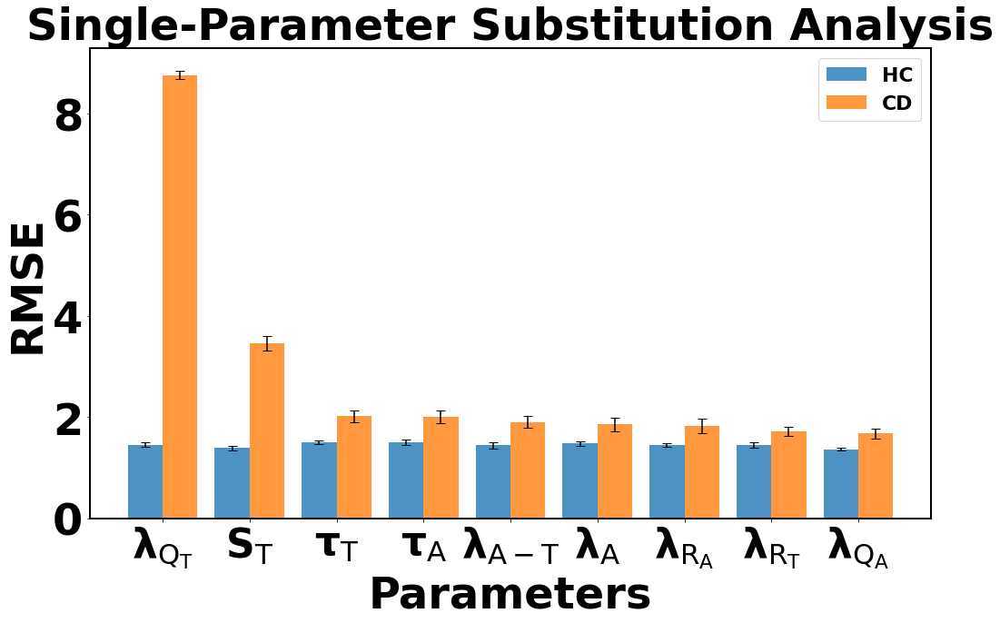

In [51]:
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams['font.weight'] = 'bold'          # axes and labels
plt.rcParams['axes.labelweight'] = 'bold'     # axis labels
plt.rcParams['axes.titleweight'] = 'bold'  
plt.rcParams['text.usetex'] = False # maybe toggle from T or F
# matplotlib.rc('text', usetex=True)
# matplotlib.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]
# plt.rcParams['text.latex.preamble'] = [r'\usepackage{amsmath}']

ft_size = 48

# Sort data in descending order of CD RMSE
sorted_indices = np.argsort(ablated_rmse_means_CD)[::-1]
ablated_rmse_means_HC_sorted = np.array(ablated_rmse_means_HC)[sorted_indices]
ablated_rmse_means_CD_sorted = np.array(ablated_rmse_means_CD)[sorted_indices]
ablated_rmse_sems_HC_sorted = np.array(ablated_rmse_sems_HC)[sorted_indices]
ablated_rmse_sems_CD_sorted = np.array(ablated_rmse_sems_CD)[sorted_indices]
parameter_labels_sorted = [labels2[i] for i in sorted_indices]

# X-axis positions for grouped bars
x = np.arange(len(parameter_labels_sorted))

# Bar width for grouped bars
bar_width = 0.4

# Create the grouped bar plot
plt.figure(figsize=(16, 10))  # Increased height from 6 to 8
plt.bar(x - bar_width / 2, ablated_rmse_means_HC_sorted, bar_width, yerr=ablated_rmse_sems_HC_sorted, capsize=5, label='HC', alpha=0.8)
plt.bar(x + bar_width / 2, ablated_rmse_means_CD_sorted, bar_width, yerr=ablated_rmse_sems_CD_sorted, capsize=5, label='CD', alpha=0.8)

# Customize the plot
plt.xticks(x, parameter_labels_sorted, fontsize=44, fontweight='bold')#, rotation=90, ha='right')
plt.yticks(fontsize=ft_size, fontweight='bold')
# plt.axhline(y=original_rmse, color='r', linestyle='--', label='Original RMSE (CD)')
plt.xlabel('Parameters', fontsize=ft_size)
plt.ylabel('RMSE', fontsize=ft_size)
plt.title('Single-Parameter Substitution Analysis', fontsize=ft_size)
plt.legend()
plt.tight_layout()

# Show the plot
plt.show()

In [52]:
# Statistical tests

from sklearn.metrics import mean_squared_error
from scipy.stats import mannwhitneyu, ttest_ind
import numpy as np

_, p_mwu = mannwhitneyu(rmse_values_HC, rmse_values_CD, alternative='two-sided')
_, p_ttest = ttest_ind(rmse_values_HC, rmse_values_CD, equal_var=False)  # Welch’s t-test

p_values_mwu.append(p_mwu)
p_values_ttest.append(p_ttest)

# Example: print summary for each parameter
for i, (mHC, mCD, semHC, semCD, p_mwu, p_t) in enumerate(zip(
        ablated_rmse_means_HC, ablated_rmse_means_CD, 
        ablated_rmse_sems_HC, ablated_rmse_sems_CD,
        p_values_mwu, p_values_ttest)):
    print(f"{labels2[i]}    {labels[i]}: HC={mHC:.3f}±{semHC:.3f}, CD={mCD:.3f}±{semCD:.3f}, p_MWU={p_mwu:.3e}, p_ttest={p_t:.3e}")
    
    
def format_p(p):
    """Format p-value: scientific if <0.005, else decimal"""
    if p < 0.005:
        return f"{p:.2e}"   # scientific notation
    else:
        return f"{p:.4f}"   # decimal notation
    
    
# Collect results into a list of dicts
results = []
for i, (mHC, mCD, semHC, semCD, p_mwu, p_t) in enumerate(zip(
        ablated_rmse_means_HC, ablated_rmse_means_CD, 
        ablated_rmse_sems_HC, ablated_rmse_sems_CD,
        p_values_mwu, p_values_ttest)):
    
    results.append({
        "Parameter": labels[i],
        "Label": labels2[i],
        "HC (mean±SEM)": f"{mHC:.3f} ± {semHC:.3f}",
        "CD (mean±SEM)": f"{mCD:.3f} ± {semCD:.3f}",
        "p_MWU": p_mwu,
        "p_ttest": p_t
    })

df = pd.DataFrame(results)

# Sort by smallest p-value (min of MWU and t-test)
df["p_min"] = df[["p_MWU", "p_ttest"]].min(axis=1)
df_sorted = df.sort_values("p_min").drop(columns="p_min")

# Apply conditional formatting
df_sorted["p_MWU"] = df_sorted["p_MWU"].map(format_p)
df_sorted["p_ttest"] = df_sorted["p_ttest"].map(format_p)

# Print pretty table
print(df_sorted.to_string(index=False))

$\mathbf{\lambda_{\mathrm{R_T}}}$    Aud Noise Scale Est: HC=1.451±0.056, CD=1.716±0.095, p_MWU=6.529e-02, p_ttest=2.066e-02
$\mathbf{\lambda_{\mathrm{R_A}}}$    Somato Noise Scale Est: HC=1.452±0.039, CD=1.821±0.146, p_MWU=7.745e-02, p_ttest=2.157e-02
$\mathbf{\lambda_{\mathrm{Q_T}}}$    TSE Process Scale: HC=1.454±0.042, CD=8.762±0.085, p_MWU=1.416e-09, p_ttest=5.308e-41
$\mathbf{\lambda_{\mathrm{Q_A}}}$    ASE Process Scale: HC=1.362±0.027, CD=1.673±0.096, p_MWU=2.320e-02, p_ttest=4.145e-03
$\mathbf{\tau_{\mathrm{T}}}$    Aud delay: HC=1.503±0.039, CD=2.016±0.116, p_MWU=9.620e-05, p_ttest=2.384e-04
$\mathbf{\tau_{\mathrm{A}}}$    Somato delay: HC=1.494±0.054, CD=1.997±0.125, p_MWU=2.471e-03, p_ttest=8.052e-04
$\mathbf{S_{\mathrm{T}}}$    Spring constant: HC=1.385±0.040, CD=3.459±0.150, p_MWU=1.416e-09, p_ttest=1.775e-13
$\mathbf{\lambda_{\mathrm{A-T}}}$    ArticToTask Noise Scale: HC=1.438±0.055, CD=1.904±0.109, p_MWU=5.941e-04, p_ttest=5.335e-04
$\mathbf{\lambda_{\mathrm{A}}}$    A

# Marginal Sensitivity Analysis

15 parameters x 5 stds x 3 runs x 8 seconds each run = 1800 seconds or 30 minutes

In [53]:
# Initialize results storage
sensitivity_rmse_means_HC = []
sensitivity_rmse_means_CD = []
sensitivity_rmse_sems_HC = []
sensitivity_rmse_sems_CD = []
simulation_outputs_HC = {}
simulation_outputs_CD = {}

In [54]:
import time
from concurrent.futures import ThreadPoolExecutor, TimeoutError as FuturesTimeoutError

# Define perturbation levels
# perturbations = [-2, -1, 0, 1, 2]
# perturbations = [-1.5, -1, 0, 1, 1.5]
# perturbations = [-0.01, 0, 0.01]
perturbations = [-3, -1.5, 0, 1.5, 3]

print(samples_healthy.shape)
std_devs_HC = samples_healthy.std(dim=0, unbiased=True)
std_devs_C = samples_cereb.std(dim=0, unbiased=True)

# Marginal sensitivity analysis
num_runs = 25
timeout_seconds = 500

def run_single_simulation(perturbed_HC, perturbed_CD, healthy_mean_synth, cereb_mean_synth):
    """Run a single simulation with both HC and CD"""
    hc_sim = FACTS(perturbed_HC)
    cd_sim = FACTS(perturbed_CD)
    
    rmse_hc = np.sqrt(mean_squared_error(hc_sim[40:140], healthy_mean_synth[40:140]))
    rmse_cd = np.sqrt(mean_squared_error(cd_sim[40:140], cereb_mean_synth[40:140]))
    
    return hc_sim, cd_sim, rmse_hc, rmse_cd

for i, (hc_mode, cd_mode, hc_std, cd_std) in enumerate(zip(posterior_modes_HC, posterior_modes_C, std_devs_HC, std_devs_C)):
    print(f'################################################################################### {i} ###################################################################################')
    rmse_values_HC = []
    rmse_values_CD = []
    
    sem_values_HC = []
    sem_values_CD = []
    
    simulation_outputs_HC[i] = []
    simulation_outputs_CD[i] = []
    
    for p in perturbations:
        perturbed_HC = posterior_modes_HC.clone()
        perturbed_CD = posterior_modes_C.clone()
        
        # Apply perturbations
        perturbed_HC[i] += p * hc_std
        perturbed_CD[i] += p * cd_std
        print(f"STD CD: {perturbed_CD[i]}")
        
        hc_simulation_runs = []
        cd_simulation_runs = []
        rmse_runs_HC = []
        rmse_runs_CD = []
        
        if perturbed_HC[i] < 0 or perturbed_CD[i] < 0:
         # Create default array of -1 with 140 elements
            default_array = torch.full((140,), -1.0)
            simulation_outputs_HC[i].append(default_array)
            simulation_outputs_CD[i].append(default_array)
            rmse_values_HC.append(np.nan)
            rmse_values_CD.append(np.nan)
            sem_values_HC.append(np.nan)
            sem_values_CD.append(np.nan)
            
            continue
        
        
        with ThreadPoolExecutor(max_workers=1) as executor:
            for run_idx in range(num_runs):
                
                # Track start time for this perturbation's runs
                start_time = time.time()
                timed_out = False
        
                # Calculate remaining time
                elapsed = time.time() - start_time
                remaining_time = timeout_seconds - elapsed
                
                if remaining_time <= 0:
                    print(f"Timeout reached for parameter {i}, perturbation {p} after {run_idx} runs")
                    timed_out = True
                    break
                
                # Submit the simulation with timeout
                future = executor.submit(run_single_simulation, perturbed_HC, perturbed_CD, 
                                        healthy_mean_synth, cereb_mean_synth)
                
                try:
                    # Wait for result with remaining time as timeout
                    hc_sim, cd_sim, rmse_hc, rmse_cd = future.result(timeout=remaining_time)
                    
                    # Store results
                    hc_simulation_runs.append(hc_sim)
                    cd_simulation_runs.append(cd_sim)
                    rmse_runs_HC.append(rmse_hc)
                    rmse_runs_CD.append(rmse_cd)
                    
                except FuturesTimeoutError:
                    print(f"Single run timeout for parameter {i}, perturbation {p}, run {run_idx}")
                    timed_out = True
                    break
                except Exception as e:
                    print(f"Error in run {run_idx}: {e}")
                    continue
        
        # If timed out or no successful runs, use default values
        if timed_out or len(hc_simulation_runs) == 0:
            # Create default array of -1 with 140 elements
            default_array = torch.full((140,), -1.0)
            simulation_outputs_HC[i].append(default_array)
            simulation_outputs_CD[i].append(default_array)
            rmse_values_HC.append(np.nan)
            rmse_values_CD.append(np.nan)
            sem_values_HC.append(np.nan)
            sem_values_CD.append(np.nan)
        else:
            # Store mean simulations
            simulation_outputs_HC[i].append(torch.stack(hc_simulation_runs).mean(dim=0))
            simulation_outputs_CD[i].append(torch.stack(cd_simulation_runs).mean(dim=0))
            
            # Store RMSE mean and SEM
            rmse_values_HC.append(np.mean(rmse_runs_HC))
            rmse_values_CD.append(np.mean(rmse_runs_CD))
            
            sem_values_HC.append(np.std(rmse_runs_HC, axis=0) / np.sqrt(len(rmse_runs_HC)))
            sem_values_CD.append(np.std(rmse_runs_CD, axis=0) / np.sqrt(len(rmse_runs_CD)))
    
    # Aggregate results
    sensitivity_rmse_means_HC.append(rmse_values_HC)
    sensitivity_rmse_means_CD.append(rmse_values_CD)
    sensitivity_rmse_sems_HC.append(sem_values_HC)
    sensitivity_rmse_sems_CD.append(sem_values_CD)

torch.Size([150000, 9])
################################################################################### 0 ###################################################################################
STD CD: -16.460113386162018
STD CD: -7.609453062065339
STD CD: 1.2412072620313406
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.0

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004601

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004601

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004601

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.004601

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
STD CD: 4.314872622609258
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
################################################################################### 7 ###################################################################################
STD CD: -0.02774442233948838
STD CD: -0.012522237979461068
STD CD: 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.022424230125734693
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.01792213074059356
STD CD: 0.03314431510062087
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040246801224539164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03314431510062087
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040246801224539164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03314431510062087
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040246801224539164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03314431510062087
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040246801224539164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03314431510062087
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.040246801224539164
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.03314431510062087
self.plant_scale:  0.01 
self.artic_to_task_noise_scal

self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0026999463805662456
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.0046016590269302195
self.plant_scale:  0.01 
self.artic_to_task_noise_scale 0.002699

In [55]:
# import time
# from concurrent.futures import ThreadPoolExecutor, TimeoutError

# # Define perturbation levels
# # perturbations = [-3, -1.5, 0, 1.5, 3] #[0, 1, -1, 2, -2]
# perturbations = [-2, -1, 0, 1, 2]


# print(samples_healthy.shape)
# std_devs_HC = samples_healthy.std(dim=0, unbiased=True) #np.std(samples_healthy, axis=0)
# std_devs_C = samples_cereb.std(dim=0, unbiased=True) #np.std(samples_cereb, axis=0)

# # Marginal sensitivity analysis
# num_runs = 25
# for i, (hc_mode, cd_mode, hc_std, cd_std) in enumerate(zip(posterior_modes_HC, posterior_modes_C, std_devs_HC, std_devs_C)): # 15 params
#     print(f'################################################################################### {i} ###################################################################################')
#     rmse_values_HC = []
#     rmse_values_CD = []
    
#     sem_values_HC = []
#     sem_values_CD = []
    
#     simulation_outputs_HC[i] = []
#     simulation_outputs_CD[i] = []

#     for p in perturbations: # 5
#         perturbed_HC = posterior_modes_HC.clone()
#         perturbed_CD = posterior_modes_C.clone()
        
#         # Apply perturbations
#         perturbed_HC[i] += p * hc_std
#         perturbed_CD[i] += p * cd_std

#         hc_simulation_runs = []
#         cd_simulation_runs = []
#         rmse_runs_HC = []
#         rmse_runs_CD = []

#         for _ in range(num_runs): # 3 runs
#             # Run simulations
#             hc_sim = FACTS(perturbed_HC)
#             cd_sim = FACTS(perturbed_CD)

#             # Store simulations for later plotting
#             hc_simulation_runs.append(hc_sim)
#             cd_simulation_runs.append(cd_sim)

#             # Calculate RMSE
# #             if p==0:
# #                 pdb.set_trace()
#             rmse_runs_HC.append(np.sqrt(mean_squared_error(hc_sim[40:140], healthy_mean_synth[40:140])))
#             rmse_runs_CD.append(np.sqrt(mean_squared_error(cd_sim[40:140], cereb_mean_synth[40:140])))
        
# #             sem_runs_HC.append(np.std(rmse_runs_HC, axis=0) / np.sqrt(num_runs))
# #             sem_runs_CD.append(np.std(rmse_runs_CD, axis=0) / np.sqrt(num_runs))

#         # Store mean simulations
# #         pdb.set_trace()
#         simulation_outputs_HC[i].append(torch.stack(hc_simulation_runs).mean(dim=0))
#         simulation_outputs_CD[i].append(torch.stack(cd_simulation_runs).mean(dim=0))

#         # Store RMSE mean and SEM
#         rmse_values_HC.append(np.mean(rmse_runs_HC))
#         rmse_values_CD.append(np.mean(rmse_runs_CD))
        
#         sem_values_HC.append(np.std(rmse_runs_HC, axis=0) / np.sqrt(num_runs))
#         sem_values_CD.append(np.std(rmse_runs_CD, axis=0) / np.sqrt(num_runs))
# #         sem_values_HC.append(np.mean(sem_runs_HC))
# #         sem_values_CD.append(np.mean(sem_runs_CD))
    
#     # Aggregate results
#     sensitivity_rmse_means_HC.append(rmse_values_HC)
#     sensitivity_rmse_means_CD.append(rmse_values_CD)
#     sensitivity_rmse_sems_HC.append(sem_values_HC)
#     sensitivity_rmse_sems_CD.append(sem_values_CD)

In [56]:
print(sensitivity_rmse_means_HC[0])
print(sensitivity_rmse_sems_CD[0])

for elem in sensitivity_rmse_means_HC:
    print(len(elem), elem)


[nan, nan, 1.4245772499025164, 1.4897001018205487, 1.3593644282289283]
[nan, nan, 0.09447537425545963, 0.126076962751951, 0.08965790681093092]
5 [nan, nan, 1.4245772499025164, 1.4897001018205487, 1.3593644282289283]
5 [nan, nan, 1.4483548037056002, 1.422717390400932, 1.4488953028094702]
5 [nan, 3.010949246614365, 1.4210805341903079, 2.9408705117933804, 4.6149701549833795]
5 [nan, nan, 1.5053228992280867, 1.4691822777818364, 1.5450798781309536]
5 [3.355946534420214, 2.1856450568914565, 1.5063214250824821, 1.8349118904180504, 2.6432706920368476]
5 [nan, 1.3655704908707074, 1.547370917527569, 1.488807149797785, 1.3781065631156348]
5 [5.100461267490506, 1.614427141744052, 1.4592660444976544, 1.7364743485296796, 2.2564698498296814]
5 [nan, nan, 1.437607942611994, 1.9741444717094856, 2.6916316515170258]
5 [nan, nan, 1.482873720377518, 1.676364606830891, 2.282420154333266]


In [57]:
# Get the default color cycle
default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

# First few colors in the default cycle:
blue_from_cycle = default_colors[0]   # Default blue
orange_from_cycle = default_colors[1] # Default orange

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:101: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


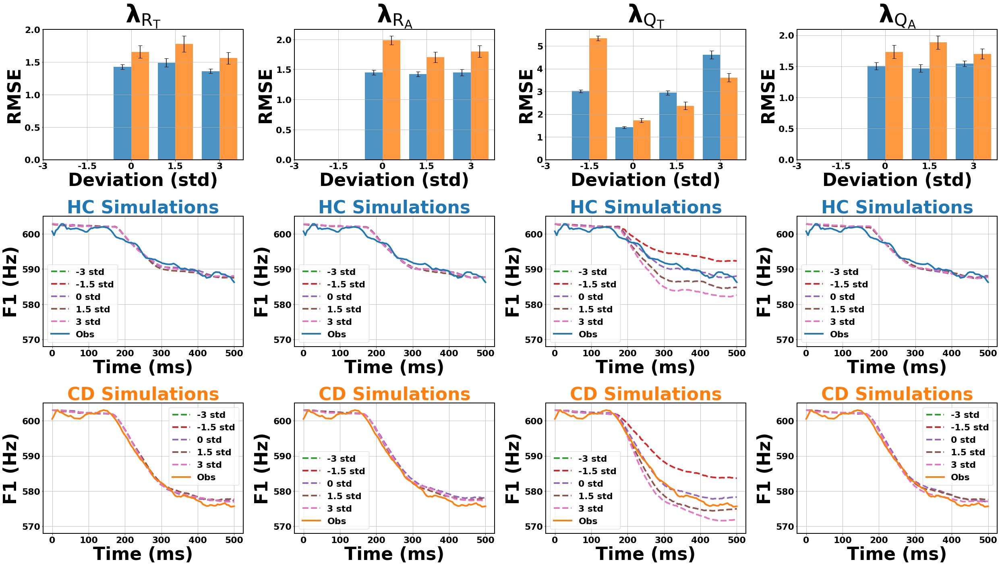

In [58]:
import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False

plt.rcParams['font.weight'] = 'bold'          # axes and labels
plt.rcParams['axes.labelweight'] = 'bold'     # axis labels
plt.rcParams['axes.titleweight'] = 'bold'  
ft_size = 44

default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
custom_cycle = plt.cycler(color=default_colors[2:] + default_colors[:2])
# ax.set_prop_cycle(custom_cycle)

num_of_params = 4 #len(labels)
# Example parameter labels (replace with actual labels)
parameter_labels = [f'{label}' for i, label in enumerate(labels)]

# Perturbation levels for x-axis
# perturbations = [-2,-1,0,1,2] #[0, 1, -1, 2, -2]

# sorted_indices = np.argsort(perturbations)
# sorted_perturbations = [perturbations[i] for i in sorted_indices]

# Create subplots with 3 rows and len(parameter_labels) columns
# num_params = len(parameter_labels)
fig, axes = plt.subplots(3, num_of_params, figsize=(35, 20), constrained_layout=True, sharey=False)

for i, param_label in enumerate(parameter_labels[:num_of_params]):
    # Row 1: RMSE vs Perturbation for HC and CD
#     axes[0, i].errorbar(perturbations, sensitivity_rmse_means_HC[i], 
#                         yerr=sensitivity_rmse_sems_HC[i], label='HC', fmt='-o')
#     axes[0, i].errorbar(perturbations, sensitivity_rmse_means_CD[i], 
#                         yerr=sensitivity_rmse_sems_CD[i], label='CD', fmt='-o')
#     axes[0, i].set_title(f'{param_label}')
#     axes[0, i].set_xlabel('Perturbation (std)')
#     axes[0, i].set_ylabel('RMSE')
#     axes[0, i].legend()
#     axes[0, i].grid(True)

#     sorted_rmse_means_HC = [sensitivity_rmse_means_HC[i][j] for j in sorted_indices]
#     sorted_rmse_means_CD = [sensitivity_rmse_means_CD[i][j] for j in sorted_indices]
#     sorted_sems_HC = [sensitivity_rmse_sems_HC[j] for j in sorted_indices]
#     sorted_sems_CD = [sensitivity_rmse_sems_CD[j] for j in sorted_indices]
    
#     x = np.arange(len(sorted_perturbations))
#     bar_width = 0.35
#     axes[0, i].bar(x - bar_width / 2, sorted_rmse_means_HC, bar_width,
# #                    yerr=sorted_sems_HC, 
#                    capsize=5, label='HC', alpha=0.8)
#     axes[0, i].bar(x + bar_width / 2, sorted_rmse_means_CD, bar_width,
# #                    yerr=sorted_sems_CD, 
#                    capsize=5, label='CD', alpha=0.8)
#     axes[0, i].set_title(param_label)
#     axes[0, i].set_xlabel('Perturbation (std)')
#     axes[0, i].set_ylabel('RMSE')
#     axes[0, i].set_xticks(x)
#     axes[0, i].set_xticklabels(sorted_perturbations)
#     axes[0, i].legend()
#     axes[0, i].grid(True)

#      # Plot HC and CD bars side by side
    x = np.arange(len(perturbations))
    axes[0, i].bar(x - bar_width / 2, sensitivity_rmse_means_HC[i], bar_width,
                yerr=sensitivity_rmse_sems_HC[i], capsize=5, label='HC', alpha=0.8)
    axes[0, i].bar(x + bar_width / 2, sensitivity_rmse_means_CD[i], bar_width,
                yerr=sensitivity_rmse_sems_CD[i], capsize=5, label='CD', alpha=0.8)

    # Customize the plot
    axes[0, i].set_title(labels2[i], fontsize=60)
    axes[0, i].set_xlabel('Deviation (std)', fontsize=ft_size)
    axes[0, i].set_ylabel('RMSE', fontsize=ft_size)
    axes[0, i].set_xticks(x)
    axes[0, i].set_xticklabels(perturbations)
    axes[0, i].grid(True)

    # Row 2: Simulation Outputs for HC Perturbations
    axes[1,i].set_prop_cycle(custom_cycle)
    for j, perturbation in enumerate(perturbations):
        axes[1, i].plot(x_time, simulation_outputs_HC[i][j][40:140], '--', label=f'{perturbation} std', linewidth=4)
    axes[1, i].plot(x_time, healthy_mean_synth[40:140],  label=f'Obs', color=blue_from_cycle, linewidth=4)
    axes[1, i].set_xlabel('Time (ms)', fontsize=ft_size)
    axes[1, i].set_ylabel('F1 (Hz)', fontsize=ft_size)
    axes[1, i].set_title(f'HC Simulations',fontsize=ft_size, color=blue_from_cycle)
    axes[1, i].legend()
    axes[1, i].grid(True)
    axes[1, i].set_ylim([568,605])

    # Row 3: Simulation Outputs for CD Perturbations
    axes[2,i].set_prop_cycle(custom_cycle)
    for j, perturbation in enumerate(perturbations):
        axes[2, i].plot(x_time, simulation_outputs_CD[i][j][40:140], '--', label=f'{perturbation} std', linewidth=4)
    axes[2, i].plot(x_time, cereb_mean_synth[40:140], label=f'Obs', color=orange_from_cycle, linewidth=4)
    axes[2, i].set_xlabel('Time (ms)', fontsize=ft_size)
    axes[2, i].set_ylabel('F1 (Hz)', fontsize=ft_size)
    axes[2, i].set_title(f'CD Simulations',fontsize=ft_size, color=orange_from_cycle)
    axes[2, i].legend()
    axes[2, i].grid(True)
    axes[2, i].set_ylim([568,605])

# Set overall plot title and adjust layout
# plt.suptitle('Sensitivity Analysis: RMSE and Simulation Outputs', fontsize=16)
plt.tight_layout()
plt.show()

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:80: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


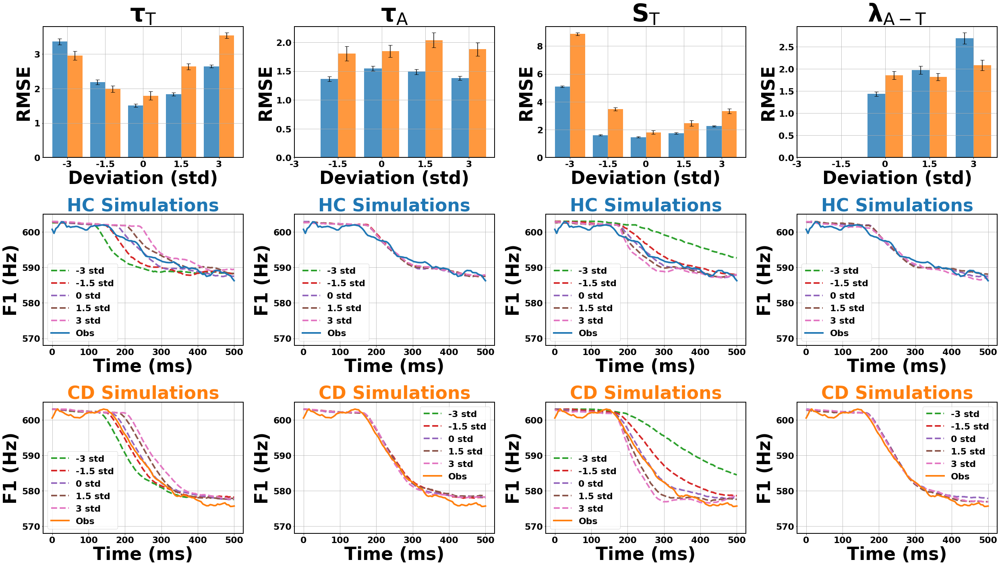

In [59]:
# num_params = len(parameter_labels)
offset = 4
fig, axes = plt.subplots(3, num_of_params, figsize=(35, 20), constrained_layout=True, sharey=False)

for i, param_label in enumerate(parameter_labels[offset:offset+num_of_params]):
    ii=i+offset
    # Row 1: RMSE vs Perturbation for HC and CD
#     axes[0, i].errorbar(perturbations, sensitivity_rmse_means_HC[i], 
#                         yerr=sensitivity_rmse_sems_HC[i], label='HC', fmt='-o')
#     axes[0, i].errorbar(perturbations, sensitivity_rmse_means_CD[i], 
#                         yerr=sensitivity_rmse_sems_CD[i], label='CD', fmt='-o')
#     axes[0, i].set_title(f'{param_label}')
#     axes[0, i].set_xlabel('Perturbation (std)')
#     axes[0, i].set_ylabel('RMSE')
#     axes[0, i].legend()
#     axes[0, i].grid(True)

#     sorted_rmse_means_HC = [sensitivity_rmse_means_HC[i][j] for j in sorted_indices]
#     sorted_rmse_means_CD = [sensitivity_rmse_means_CD[i][j] for j in sorted_indices]
#     sorted_sems_HC = [sensitivity_rmse_sems_HC[j] for j in sorted_indices]
#     sorted_sems_CD = [sensitivity_rmse_sems_CD[j] for j in sorted_indices]
    
#     x = np.arange(len(sorted_perturbations))
#     bar_width = 0.35
#     axes[0, i].bar(x - bar_width / 2, sorted_rmse_means_HC, bar_width,
# #                    yerr=sorted_sems_HC, 
#                    capsize=5, label='HC', alpha=0.8)
#     axes[0, i].bar(x + bar_width / 2, sorted_rmse_means_CD, bar_width,
# #                    yerr=sorted_sems_CD, 
#                    capsize=5, label='CD', alpha=0.8)
#     axes[0, i].set_title(param_label)
#     axes[0, i].set_xlabel('Perturbation (std)')
#     axes[0, i].set_ylabel('RMSE')
#     axes[0, i].set_xticks(x)
#     axes[0, i].set_xticklabels(sorted_perturbations)
#     axes[0, i].legend()
#     axes[0, i].grid(True)

#      # Plot HC and CD bars side by side
    x = np.arange(len(perturbations))
    axes[0, i].bar(x - bar_width / 2, sensitivity_rmse_means_HC[ii], bar_width,
                yerr=sensitivity_rmse_sems_HC[ii], capsize=5, label='HC', alpha=0.8)
    axes[0, i].bar(x + bar_width / 2, sensitivity_rmse_means_CD[ii], bar_width,
                yerr=sensitivity_rmse_sems_CD[ii], capsize=5, label='CD', alpha=0.8)

    # Customize the plot
    axes[0, i].set_title(labels2[ii],fontsize=60)
    axes[0, i].set_xlabel('Deviation (std)',fontsize=ft_size)
    axes[0, i].set_ylabel('RMSE',fontsize=ft_size)
    axes[0, i].set_xticks(x)
    axes[0, i].set_xticklabels(perturbations)
    axes[0, i].grid(True)

    # Row 2: Simulation Outputs for HC Perturbations
    axes[1,i].set_prop_cycle(custom_cycle)
    for j, perturbation in enumerate(perturbations):
        axes[1, i].plot(x_time, simulation_outputs_HC[ii][j][40:140], '--', label=f'{perturbation} std',  linewidth=4 )
    axes[1, i].plot(x_time, healthy_mean_synth[40:140], '-', label=f'Obs', color=blue_from_cycle,  linewidth=4)
    axes[1, i].set_xlabel('Time (ms)',fontsize=ft_size)
    axes[1, i].set_ylabel('F1 (Hz)',fontsize=ft_size)
    axes[1, i].set_title(f'HC Simulations',fontsize=ft_size, color=blue_from_cycle)
    axes[1, i].legend()
    axes[1, i].grid(True)
    axes[1, i].set_ylim([568,605])

    # Row 3: Simulation Outputs for CD Perturbations
    axes[2,i].set_prop_cycle(custom_cycle)
    for j, perturbation in enumerate(perturbations):
        axes[2, i].plot(x_time, simulation_outputs_CD[ii][j][40:140], '--', label=f'{perturbation} std',  linewidth=4)
    axes[2, i].plot(x_time, cereb_mean_synth[40:140], label=f'Obs', color=orange_from_cycle, linewidth=4)
    axes[2, i].set_xlabel('Time (ms)',fontsize=ft_size)
    axes[2, i].set_ylabel('F1 (Hz)',fontsize=ft_size)
    axes[2, i].set_title(f'CD Simulations', fontsize=ft_size, color=orange_from_cycle)
    axes[2, i].legend()
    axes[2, i].grid(True)
    axes[2, i].set_ylim([568,605])

# Set overall plot title and adjust layout
# plt.suptitle('Sensitivity Analysis: RMSE and Simulation Outputs', fontsize=16)
plt.tight_layout()
plt.show()

/Users/alvincepongos/opt/anaconda3/envs/FACTS_SBI_py37/lib/python3.7/site-packages/ipykernel_launcher.py:80: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


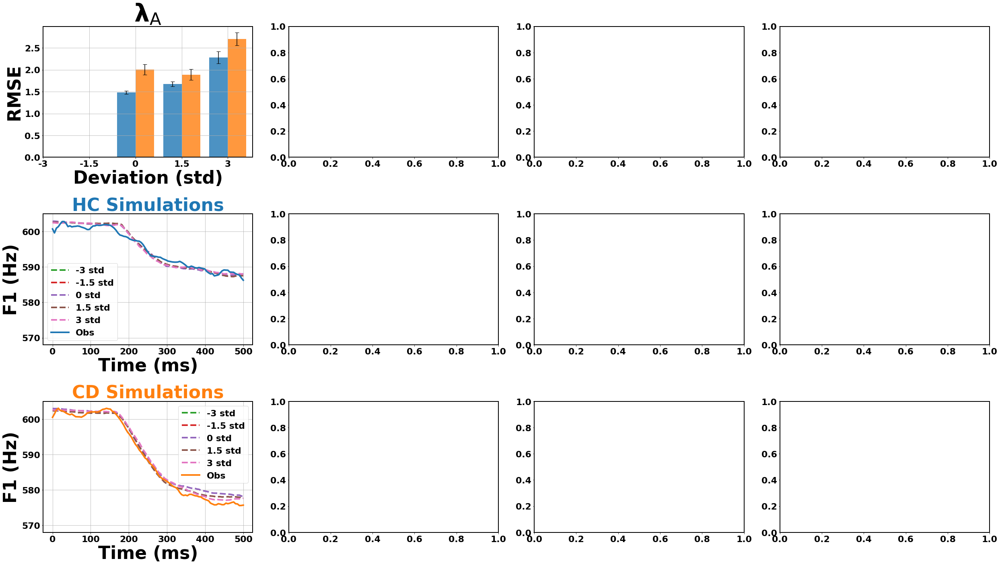

In [60]:
# num_params = len(parameter_labels)
offset = 8
fig, axes = plt.subplots(3, num_of_params, figsize=(35, 20), constrained_layout=True, sharey=False)

for i, param_label in enumerate(parameter_labels[offset:offset+num_of_params]):
    ii=i+offset
    # Row 1: RMSE vs Perturbation for HC and CD
#     axes[0, i].errorbar(perturbations, sensitivity_rmse_means_HC[i], 
#                         yerr=sensitivity_rmse_sems_HC[i], label='HC', fmt='-o')
#     axes[0, i].errorbar(perturbations, sensitivity_rmse_means_CD[i], 
#                         yerr=sensitivity_rmse_sems_CD[i], label='CD', fmt='-o')
#     axes[0, i].set_title(f'{param_label}')
#     axes[0, i].set_xlabel('Perturbation (std)')
#     axes[0, i].set_ylabel('RMSE')
#     axes[0, i].legend()
#     axes[0, i].grid(True)

#     sorted_rmse_means_HC = [sensitivity_rmse_means_HC[i][j] for j in sorted_indices]
#     sorted_rmse_means_CD = [sensitivity_rmse_means_CD[i][j] for j in sorted_indices]
#     sorted_sems_HC = [sensitivity_rmse_sems_HC[j] for j in sorted_indices]
#     sorted_sems_CD = [sensitivity_rmse_sems_CD[j] for j in sorted_indices]
    
#     x = np.arange(len(sorted_perturbations))
#     bar_width = 0.35
#     axes[0, i].bar(x - bar_width / 2, sorted_rmse_means_HC, bar_width,
# #                    yerr=sorted_sems_HC, 
#                    capsize=5, label='HC', alpha=0.8)
#     axes[0, i].bar(x + bar_width / 2, sorted_rmse_means_CD, bar_width,
# #                    yerr=sorted_sems_CD, 
#                    capsize=5, label='CD', alpha=0.8)
#     axes[0, i].set_title(param_label)
#     axes[0, i].set_xlabel('Perturbation (std)')
#     axes[0, i].set_ylabel('RMSE')
#     axes[0, i].set_xticks(x)
#     axes[0, i].set_xticklabels(sorted_perturbations)
#     axes[0, i].legend()
#     axes[0, i].grid(True)

#      # Plot HC and CD bars side by side
    x = np.arange(len(perturbations))
    axes[0, i].bar(x - bar_width / 2, sensitivity_rmse_means_HC[ii], bar_width,
                yerr=sensitivity_rmse_sems_HC[ii], capsize=5, label='HC', alpha=0.8)
    axes[0, i].bar(x + bar_width / 2, sensitivity_rmse_means_CD[ii], bar_width,
                yerr=sensitivity_rmse_sems_CD[ii], capsize=5, label='CD', alpha=0.8)

    # Customize the plot
    axes[0, i].set_title(labels2[i+offset],fontsize=60)
    axes[0, i].set_xlabel('Deviation (std)',fontsize=ft_size)
    axes[0, i].set_xticks(x)
    axes[0, i].set_ylabel('RMSE',fontsize=ft_size)
    axes[0, i].set_xticklabels(perturbations)
    axes[0, i].grid(True)

    # Row 2: Simulation Outputs for HC Perturbations
    axes[1,i].set_prop_cycle(custom_cycle)
    for j, perturbation in enumerate(perturbations):
        axes[1, i].plot(x_time, simulation_outputs_HC[ii][j][40:140], '--', label=f'{perturbation} std', linewidth=4 )
    axes[1, i].plot(x_time, healthy_mean_synth[40:140], '-', label=f'Obs', color=blue_from_cycle, linewidth=4 )
    axes[1, i].set_xlabel('Time (ms)',fontsize=ft_size)
    axes[1, i].set_ylabel('F1 (Hz)',fontsize=ft_size)
    axes[1, i].set_title(f'HC Simulations', fontsize=ft_size, color=blue_from_cycle)
    axes[1, i].legend()
    axes[1, i].grid(True)
    axes[1, i].set_ylim([568,605])

    # Row 3: Simulation Outputs for CD Perturbations
    axes[2,i].set_prop_cycle(custom_cycle)
    for j, perturbation in enumerate(perturbations):
        axes[2, i].plot(x_time, simulation_outputs_CD[ii][j][40:140],'--', label=f'{perturbation} std', linewidth=4 )
    axes[2, i].plot(x_time, cereb_mean_synth[40:140], label=f'Obs', color=orange_from_cycle, linewidth=4 )
    axes[2, i].set_xlabel('Time (ms)', fontsize=ft_size)
    axes[2, i].set_ylabel('F1 (Hz)', fontsize=ft_size)
    axes[2, i].set_title(f'CD Simulations', fontsize=ft_size, color=orange_from_cycle)
    axes[2, i].legend()
    axes[2, i].grid(True)
    axes[2, i].set_ylim([568,605])

# Set overall plot title and adjust layout
# plt.suptitle('Sensitivity Analysis: RMSE and Simulation Outputs', fontsize=16)
plt.tight_layout()
plt.show()

# Test various true ASE process noise or true TSE process noise

In [61]:
# Initialize results storage
sensitivity_rmse_means_HC_test = []
sensitivity_rmse_means_CD_test = []
sensitivity_rmse_sems_HC_test = []
sensitivity_rmse_sems_CD_test = []
simulation_outputs_HC_test = {}
simulation_outputs_CD_test = {}

In [62]:
type(posterior_modes_HC)

torch.Tensor

In [63]:
# Define perturbation levels
# perturbations = [-3, -1.5, 0, 1.5, 3] #[0, 1, -1, 2, -2]
# perturbations = [0, 0.05, 0.10, 0.20, 0.35, 0.50, 0.75, 1.00, 10]


# print(samples_healthy.shape)
# std_devs_HC = samples_healthy.std(dim=0, unbiased=True) #np.std(samples_healthy, axis=0)
# std_devs_C = samples_cereb.std(dim=0, unbiased=True) #np.std(samples_cereb, axis=0)

# # Marginal sensitivity analysis
# num_runs = 3
# # for i, (hc_mode, cd_mode, hc_std, cd_std) in enumerate(zip(posterior_modes_HC, posterior_modes_C, std_devs_HC, std_devs_C)): # 15 params
# # print(f'################################################################################### {i} ###################################################################################')
# rmse_values_HC = []
# rmse_values_CD = []

# sem_values_HC = []
# sem_values_CD = []

# simulation_outputs_HC_test[0] = []
# simulation_outputs_CD_test[0] = []

# for pert in perturbations: # 5
#     perturbed_HC = posterior_modes_HC.clone()
#     perturbed_CD = posterior_modes_C.clone()

#     # Apply perturbations
# #     pdb.set_trace()
#     perturbed_HC = torch.cat([perturbed_HC, torch.tensor([pert])], dim=0)
#     perturbed_CD = torch.cat([perturbed_CD, torch.tensor([pert])], dim=0)

#     hc_simulation_runs = []
#     cd_simulation_runs = []
#     rmse_runs_HC = []
#     rmse_runs_CD = []

#     for _ in range(num_runs): # 3 runs
#         # Run simulations
#         hc_sim = FACTS(perturbed_HC)
#         cd_sim = FACTS(perturbed_CD)

#         # Store simulations for later plotting
#         hc_simulation_runs.append(hc_sim)
#         cd_simulation_runs.append(cd_sim)

#         # Calculate RMSE
# #             if p==0:
# #                 pdb.set_trace()
#         rmse_runs_HC.append(np.sqrt(mean_squared_error(hc_sim[40:140], healthy_mean_synth[40:140])))
#         rmse_runs_CD.append(np.sqrt(mean_squared_error(cd_sim[40:140], cereb_mean_synth[40:140])))

# #             sem_runs_HC.append(np.std(rmse_runs_HC, axis=0) / np.sqrt(num_runs))
# #             sem_runs_CD.append(np.std(rmse_runs_CD, axis=0) / np.sqrt(num_runs))

#     # Store mean simulations
# #         pdb.set_trace()
#     simulation_outputs_HC_test[0].append(torch.stack(hc_simulation_runs).mean(dim=0))
#     simulation_outputs_CD_test[0].append(torch.stack(cd_simulation_runs).mean(dim=0))

#     # Store RMSE mean and SEM
#     rmse_values_HC.append(np.mean(rmse_runs_HC))
#     rmse_values_CD.append(np.mean(rmse_runs_CD))

#     sem_values_HC.append(np.std(rmse_runs_HC, axis=0) / np.sqrt(num_runs))
#     sem_values_CD.append(np.std(rmse_runs_CD, axis=0) / np.sqrt(num_runs))
# #         sem_values_HC.append(np.mean(sem_runs_HC))
# #         sem_values_CD.append(np.mean(sem_runs_CD))

# # Aggregate results
# sensitivity_rmse_means_HC_test.append(rmse_values_HC)
# sensitivity_rmse_means_CD_test.append(rmse_values_CD)
# sensitivity_rmse_sems_HC_test.append(sem_values_HC)
# sensitivity_rmse_sems_CD_test.append(sem_values_CD)

In [64]:
# num_params = len(parameter_labels)
# fig, axes = plt.subplots(3, 1, figsize=(10, 15), constrained_layout=True, sharey=False)

# ii=0
# param_label = 'Artic-to-Task Noise'
# #      # Plot HC and CD bars side by side
# x = np.arange(len(perturbations))
# axes[0].bar(x - bar_width / 2, sensitivity_rmse_means_HC_test[ii], bar_width,
#             yerr=sensitivity_rmse_sems_HC_test[ii], capsize=5, label='HC', alpha=0.8)
# axes[0].bar(x + bar_width / 2, sensitivity_rmse_means_CD_test[ii], bar_width,
#             yerr=sensitivity_rmse_sems_CD_test[ii], capsize=5, label='CD', alpha=0.8)

# # Customize the plot
# axes[0].set_title(param_label)
# axes[0].set_xlabel('Plan Noise')
# axes[0].set_ylabel('RMSE')
# axes[0].set_xticks(x)
# axes[0].set_xticklabels(perturbations)
# axes[0].grid(True)

# # Row 2: Simulation Outputs for HC Perturbations
# for j, perturbation in enumerate(perturbations):
#     axes[1].plot(simulation_outputs_HC_test[ii][j][40:140], label=f'{perturbation}')
# axes[1].plot(healthy_mean_synth[40:140], '-', label=f'HC Ground Truth', color='k')
# axes[1].set_xlabel('Frame')
# axes[1].set_ylabel('Simulation Output')
# axes[1].set_title(f'HC Simulation Outputs')
# axes[1].legend(title='Artic-to-Task Noise Scale')
# axes[1].grid(True)
# axes[1].set_ylim([568,605])

# # Row 3: Simulation Outputs for CD Perturbations
# for j, perturbation in enumerate(perturbations):
#     axes[2].plot(simulation_outputs_CD_test[ii][j][40:140], label=f'{perturbation}')
# axes[2].plot(cereb_mean_synth[40:140], label=f'CD Ground Truth', color='k')
# axes[2].set_xlabel('Frame')
# axes[2].set_ylabel('Simulation Output')
# axes[2].set_title(f'CD Simulation Outputs')
# axes[2].legend(title='Artic-to-Task Noise Scale')
# axes[2].grid(True)
# axes[2].set_ylim([568,605])

# # Set overall plot title and adjust layout
# # plt.suptitle('Sensitivity Analysis: RMSE and Simulation Outputs', fontsize=16)
# plt.tight_layout()
# plt.show()

In [65]:
# print(sensitivity_rmse_sems_HC[0])
# print(sensitivity_rmse_means_CD[0])
# sensitivity_rmse_sems_HC

## Plot CD and HC in same plot

In [66]:
# Plot Healthy Estimated
# plt.plot(x_time, mean_formants_HC, linestyle='--', label='Estimated from posteriors')
# ci_HC = (1.96 * np.std(all_simulated_formant_HC,axis=0)/np.sqrt(all_simulated_formant_HC.shape[0]))[40:140]
# plt.fill_between(x_time, (mean_formants_HC-ci_HC), (mean_formants_HC+ci_HC), color='b', alpha=.1)
# # Plot Healthy observed
# plt.plot(x_time, healthy_mean_synth[40:140], color='b',label='Mean of observed trials')
# plt.fill_between(x_time, (healthy_mean_synth[40:140]-cereb_ci_ds), (healthy_mean_synth[40:140]+cereb_ci_ds), color='b', alpha=.1)



# # Plot CD Estimated
# plt.plot(x_time, mean_formants_CD, 'orange', linestyle='--',label='Estimated from posteriors')
# ci_CD = (1.96 * np.std(all_simulated_formant_CD,axis=0)/np.sqrt(all_simulated_formant_CD.shape[0]))[40:140]
# plt.fill_between(x_time, (mean_formants_CD-ci_CD), (mean_formants_CD+ci_CD), color='orange', alpha=.1)
# # Plot CD observed
# plt.plot(x_time, cereb_mean_synth[40:140], 'orange', linestyle='-', label='Mean of observed trials')
# plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1)



### Plot without truncating, just to see

In [67]:
# # posterior_modes_C = stats.mode(samples_cereb,0)
# posterior_modes_C = torch.from_numpy(posterior_modes_C[0][0])
# print(f'poster modes {posterior_modes_C}')
# print(f'original theta {0.005, 0.005, 0.01, 0.1, 0.0000001, 0.0000001, 100, 50, 3}')
# # pdb.set_trace()

# # posterior_modes_HC_manual_test = posterior_modes_HC.detach().clone()
# # posterior_modes_HC_manual_test[-1] = 8
# # posterior_modes_HC_manual_test[5] = posterior_modes_HC[5] * 100

# all_simulated_formant = np.array([])
# for ii in range(2):
#     simulated_formant = FACTS(posterior_modes_C)
# #     simulated_formant_manual_test = FACTS(posterior_modes_HC_manual_test)
# #     pdb.set_trace()
#     if ii == 0:
#         all_simulated_formant = simulated_formant
#     else:
#         all_simulated_formant = np.vstack((all_simulated_formant, simulated_formant))
    
    
# # # Plot data
# x_time = np.linspace(-200,500, num=140)

# mean_formants = np.mean(all_simulated_formant, axis=0)
# plt.figure(figsize=(14,10))
# plt.plot(x_time, mean_formants, 'orange' ,label='Estimated from posteriors')
# ci = (1.96 * np.std(all_simulated_formant,axis=0)/np.sqrt(all_simulated_formant.shape[0]))
# plt.fill_between(x_time, (mean_formants-ci), (mean_formants+ci), color='orange', alpha=.1)

# plt.plot(x_time, cereb_mean_synth, 'k',label='Mean of observed trials')
# #     plt.plot(x_time, simulated_formant_manual_test[40:140], 'red',label='Manual test')
# #     plt.axvline(x = 0, color = 'grey', ls=':')
# plt.legend()

# plt.xlabel('Time (ms)')
# plt.ylabel('Formant response (Hz)')
# plt.title('CD Empirical')

Interpret Glass effect size
https://www.uv.es/~friasnav/EffectSizeBecker.pdf

In [68]:
print(labels)

['Aud Noise Scale Est', 'Somato Noise Scale Est', 'TSE Process Scale', 'ASE Process Scale', 'Aud delay', 'Somato delay', 'Spring constant', 'ArticToTask Noise Scale', 'ArticSFCLaw Noise Scale']


,Group,variable,value
0,CD,$\mathbf{\lambda_{\mathrm{R_T}}}$,3.6271770
1,CD,$\mathbf{\lambda_{\mathrm{R_T}}}$,2.1268013
2,CD,$\mathbf{\lambda_{\mathrm{R_T}}}$,2.0964711
3,CD,$\mathbf{\lambda_{\mathrm{R_T}}}$,13.3208656
4,CD,$\mathbf{\lambda_{\mathrm{R_T}}}$,7.9623113
...,...,...,...
2699995,HC,$\mathbf{\lambda_{\mathrm{A}}}$,0.0791648
2699996,HC,$\mathbf{\lambda_{\mathrm{A}}}$,950.4316406
2699997,HC,$\mathbf{\lambda_{\mathrm{A}}}$,0.0482382
2699998,HC,$\mathbf{\lambda_{\mathrm{A}}}$,549.5906372


['Aud Noise Scale Est', 'Somato Noise Scale Est', 'TSE Process Scale', 'ASE Process Scale', 'Aud delay', 'Somato delay', 'Spring constant', 'ArticToTask Noise Scale', 'ArticSFCLaw Noise Scale']


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


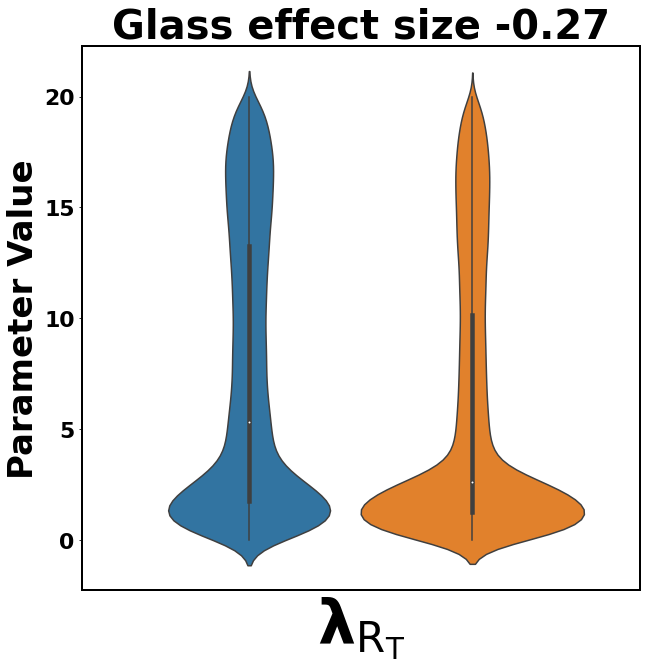

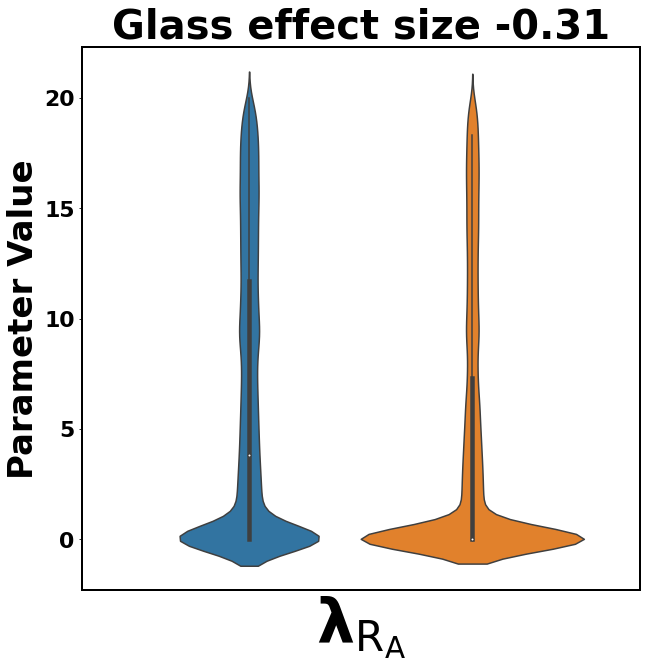

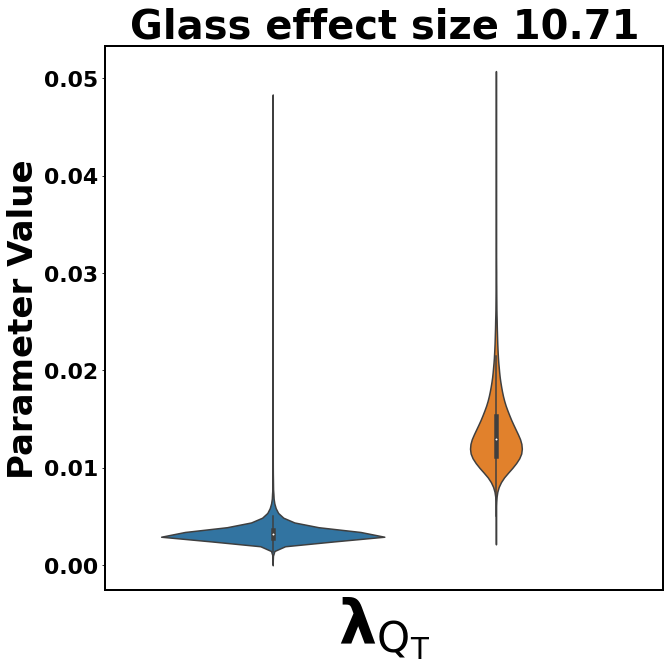

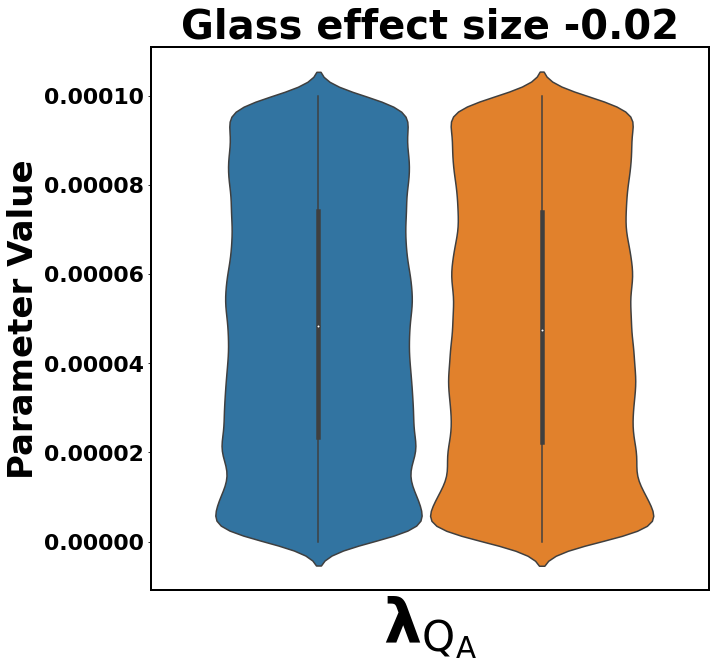

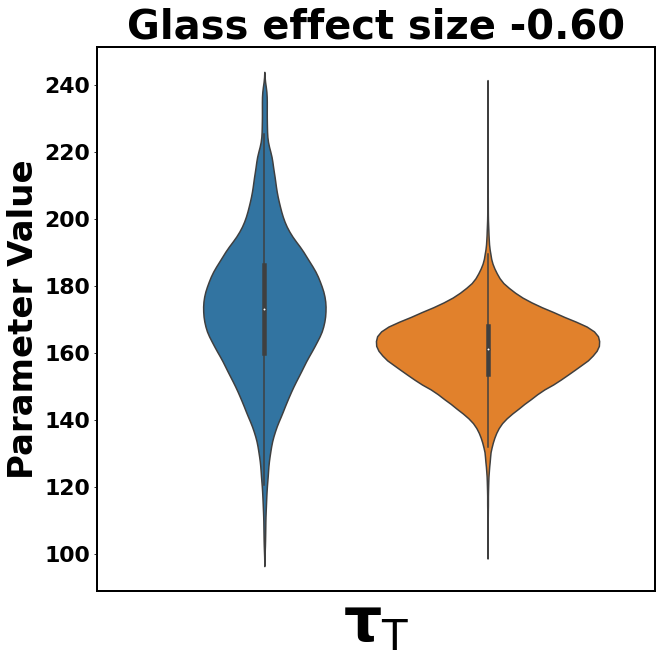

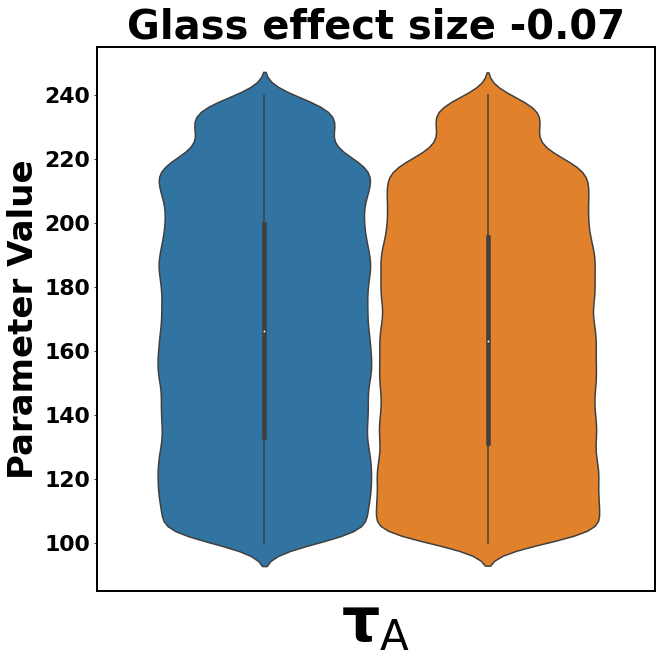

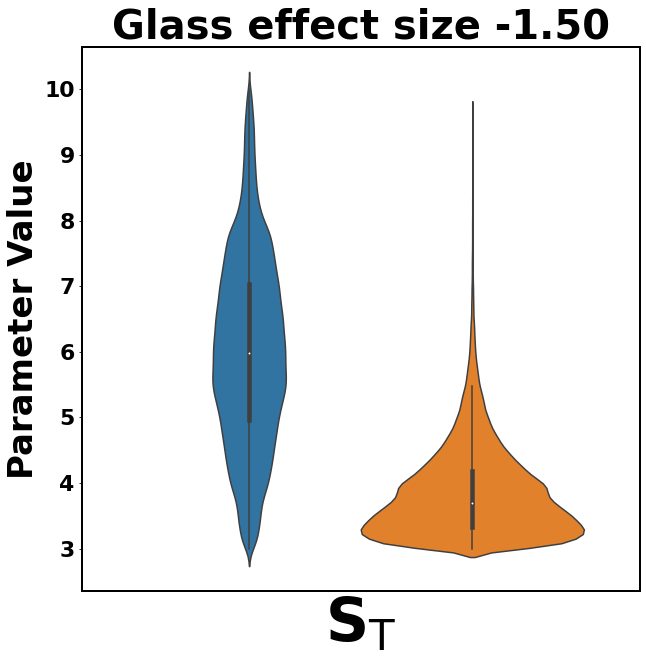

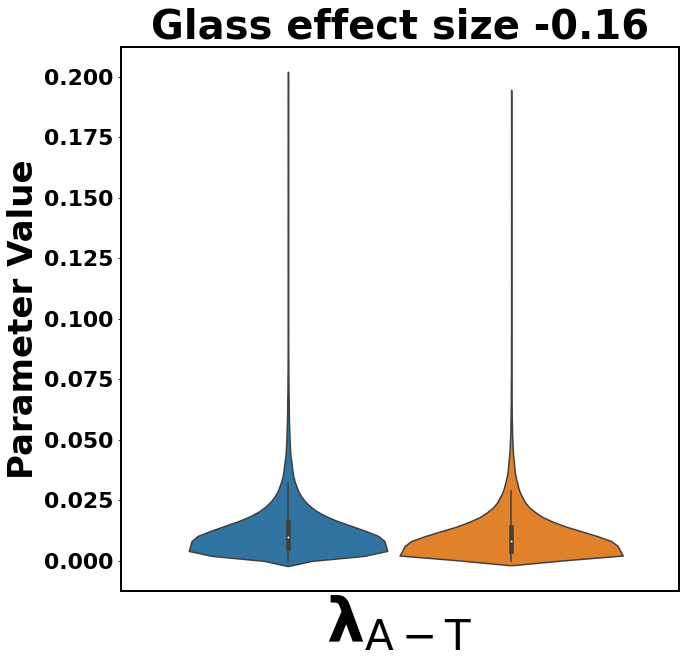

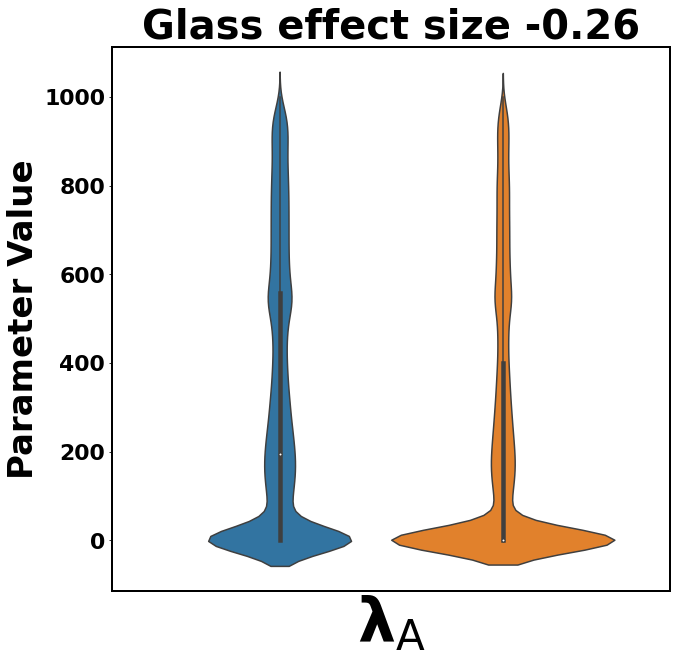

In [69]:
# Mann-Whitney U test
from numpy.random import seed
from numpy.random import randn
from scipy.stats import mannwhitneyu
plt.rcParams['text.usetex'] = False

plt.rcParams['font.weight'] = 'bold'          # axes and labels
plt.rcParams['axes.labelweight'] = 'bold'     # axis labels
plt.rcParams['axes.titleweight'] = 'bold'  

px3 = pd.melt(px2, id_vars=['Group'])
display(px3)

print(labels)

for i, label in enumerate(labels2):
    #plt.figure()
    px4 = px3[px3['variable']==label]
    
    # Calculate Non-parametric diff
    CD_data = px4[px4['Group']=='CD']['value']
    HC_data = px4[px4['Group']=='HC']['value']
    stat, p = mannwhitneyu(CD_data, HC_data)
    
    # Calculate glass's effects size
    mean1 = np.mean(CD_data)
    mean2 =  np.mean(HC_data)
    std_hc = np.std(px4[px4['Group']=='HC']['value'])
    glass_D = (mean1-mean2) / std_hc
    
    # Get the mode of CD
#     CD_mode = np.median(CD_data)
#     display(CD_mode)
#     perm_pval = permutation_test(HC_data, CD_data, 100)
    # Calculate the KDE
#     pdb.set_trace()
    kde = stats.gaussian_kde(CD_data)
    # Define a range of values over which to evaluate the KDE
    x = np.linspace(CD_data.min(), CD_data.max(), 1000)
    # Evaluate the KDE over the range of values
    y = kde.evaluate(x)
    
    # Create figure with 2 subplots side-by-side
#     fig, axs = plt.subplots(1, 2, figsize=(18, 8), sharey=False)
# #     fig.suptitle(f'{label}\nWhitney p-val {p:.4g} | Glass D = {glass_D:.2f}', fontsize=12)

#     # First subplot - default y-axis
#     sns.violinplot(px4, x="variable", y="value", hue="Group",
#                    hue_order=['HC', 'CD'], ax=axs[0])
# #     axs[0].axhline(y=CD_mode, color='r', linestyle='-')
#     axs[0].set_title(f'Whitney p-val {p:.4g} \nGlass effect size {glass_D:.2f}\n', fontsize=20)
#     axs[0].set_ylabel('Parameter Value')
#     axs[0].set_xlabel('')
#     axs[0].set_xticklabels([label_dict[label]])
#     sns.move_legend(axs[0], "upper left", bbox_to_anchor=(1, 1))

    # Second subplot - bounded y-axis
#     sns.violinplot(px4, x="variable", y="value", hue="Group",
#                    hue_order=['HC', 'CD'], ax=axs[1])
# #     axs[1].axhline(y=CD_mode, color='r', linestyle='-')
#     axs[1].set_ylim([prior_min[i], prior_mmax[i]])
#     axs[1].set_title('Bounded y-axis')
#     axs[1].set_ylabel('Parameter Value')
#     axs[1].set_xlabel('Parameter')
#     sns.move_legend(axs[1], "upper left", bbox_to_anchor=(1, 1))

#     plt.tight_layout()
#     plt.show()

    # Find the x value where the KDE is at its maximum
#     CD_mode = x[np.argmax(y)]
    
    plt.figure( figsize=(10, 10))
    ax = sns.violinplot(px4, x="variable", y="value", hue="Group",figsize=(12,12), hue_order=['HC','CD'])
    ax.legend().set_visible(False)
#     sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
#     plt.axhline(y = CD_mode, color = 'r', linestyle = '-') 
    plt.ylabel('Parameter Value', fontsize=34)
    plt.xticks([]) 
#     plt.xlabel(f'{label_dict[label]}', fontsize=60)
    plt.xlabel(f'{label}', fontsize=60)
    
#     #Calculate boostrap
#     plt.title(f'Whitney p-val {p:.4g} \nGlass effect size {glass_D:.2f}')
    plt.title(f'Glass effect size {glass_D:.2f}', fontsize=40)

    
# plt.xticks(range(0,9), labels, rotation='vertical')
# plt.ylabel('Parameter Value')
# plt.xlabel('Parameter')

In [70]:
# print(labels)
# print(prior_min)
# print(prior_mmax)

# prior_min = [1e-08, 1e-08, 1e-08, 1e-08, 100, 100, 3, 0, 0]
# prior_mmax = [   3, 1e-04,  0.05, 1e-04, 220, 220, 8, 0.1, 0.25]

In [71]:
results = []
# Iterate over each parameter
for param in px3['variable'].unique():
    # Subset data by parameter
    subset = px3[px3['variable'] == param]
    
    # Separate values by group
    cd_values = subset[subset['Group'] == 'CD']['value']
    hc_values = subset[subset['Group'] == 'HC']['value']
    
    # Calculate medians
    cd_median = cd_values.median()
    hc_median = hc_values.median()
    
    # Calculate Glass effect size (mean difference divided by standard deviation of HC group)
    mean_diff = cd_values.mean() - hc_values.mean()
    hc_std = hc_values.std()
    glass_effect_size = mean_diff / hc_std if hc_std != 0 else np.nan
    
    # Perform Mann-Whitney U test
    try:
        u_stat, p_value = mannwhitneyu(cd_values, hc_values, alternative="two-sided")
    except ValueError:
        p_value = np.nan  # If Mann-Whitney fails due to insufficient data
    
    # Append results
    results.append({
        "variable": param,
        "Group": "CD vs HC",
        "CD Median": cd_median,
        "HC Median": hc_median,
        "Glass Effect Size": glass_effect_size,
        "Whitney P-Value": p_value
    })

# Create a new DataFrame from the results
summary_df = pd.DataFrame(results)

display(summary_df)

,variable,Group,CD Median,HC Median,Glass Effect Size,Whitney P-Value
0,$\mathbf{\lambda_{\mathrm{R_T}}}$,CD vs HC,2.6120446,5.3040063,-0.2658335,0.0000000
1,$\mathbf{\lambda_{\mathrm{R_A}}}$,CD vs HC,0.0017786,3.8134390,-0.3080230,0.0000000
2,$\mathbf{\lambda_{\mathrm{Q_T}}}$,CD vs HC,0.0129346,0.0031230,10.7089820,0.0000000
3,$\mathbf{\lambda_{\mathrm{Q_A}}}$,CD vs HC,0.0000475,0.0000484,-0.0187125,0.0000002
4,$\mathbf{\tau_{\mathrm{T}}}$,CD vs HC,161.1661682,173.0166702,-0.5955209,0.0000000
5,$\mathbf{\tau_{\mathrm{A}}}$,CD vs HC,163.1761322,166.1032715,-0.0677475,0.0000000
6,$\mathbf{S_{\mathrm{T}}}$,CD vs HC,3.6910527,5.9757977,-1.4985451,0.0000000
7,$\mathbf{\lambda_{\mathrm{A-T}}}$,CD vs HC,0.0082717,0.0098878,-0.1629938,0.0000000
8,$\mathbf{\lambda_{\mathrm{A}}}$,CD vs HC,0.3019045,195.3052521,-0.2608539,0.0000000



===== $\mathbf{\lambda_{\mathrm{R_T}}}$ =====
CD: mode = 1.2412, -3σ = -16.4601, +3σ = 18.9425
HC: mode = 1.3213, -3σ = -17.4226, +3σ = 20.0651

===== $\mathbf{\lambda_{\mathrm{R_A}}}$ =====
CD: mode = 0.0200, -3σ = -17.8588, +3σ = 17.8989
HC: mode = 0.0601, -3σ = -19.4109, +3σ = 19.5310

===== $\mathbf{\lambda_{\mathrm{Q_T}}}$ =====
CD: mode = 0.0119, -3σ = -0.0003, +3σ = 0.0242
HC: mode = 0.0030, -3σ = 0.0000, +3σ = 0.0059

===== $\mathbf{\lambda_{\mathrm{Q_A}}}$ =====
CD: mode = 0.0000, -3σ = -0.0001, +3σ = 0.0001
HC: mode = 0.0000, -3σ = -0.0001, +3σ = 0.0001

===== $\mathbf{\tau_{\mathrm{T}}}$ =====
CD: mode = 163.2331, -3σ = 129.6289, +3σ = 196.8374
HC: mode = 173.3514, -3σ = 110.1285, +3σ = 236.5742

===== $\mathbf{\tau_{\mathrm{A}}}$ =====
CD: mode = 109.5307, -3σ = -4.9141, +3σ = 223.9755
HC: mode = 156.0581, -3σ = 39.2159, +3σ = 272.9004

===== $\mathbf{S_{\mathrm{T}}}$ =====
CD: mode = 3.2680, -3σ = 1.1743, +3σ = 5.3617
HC: mode = 5.5997, -3σ = 1.2598, +3σ = 9.9396

===== $

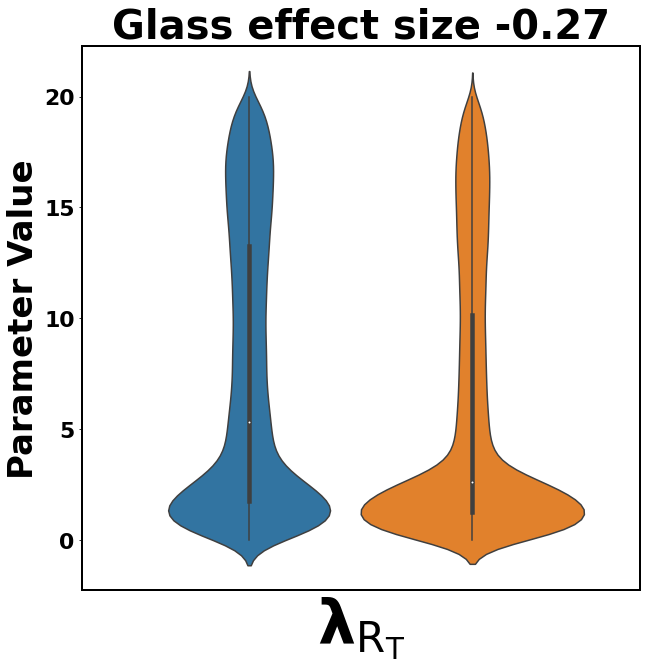

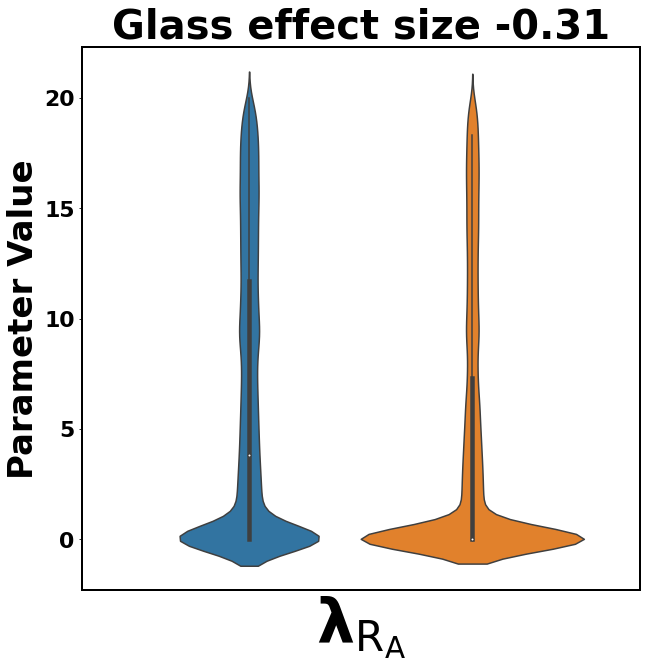

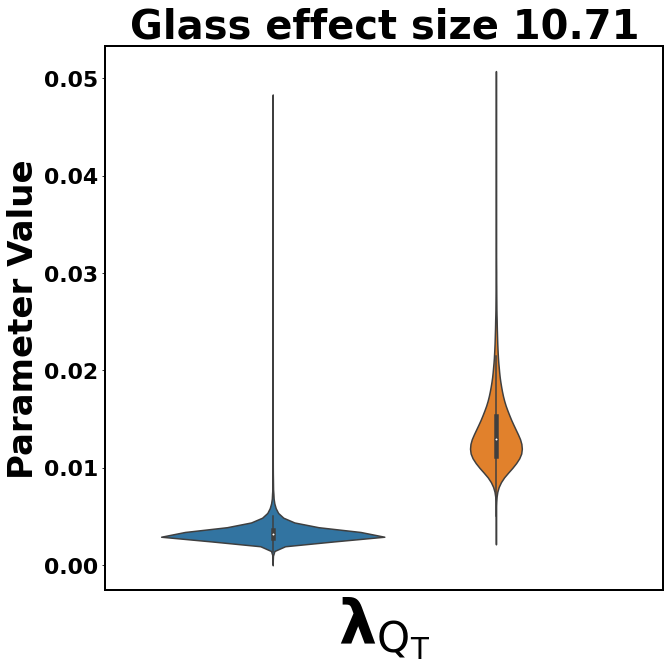

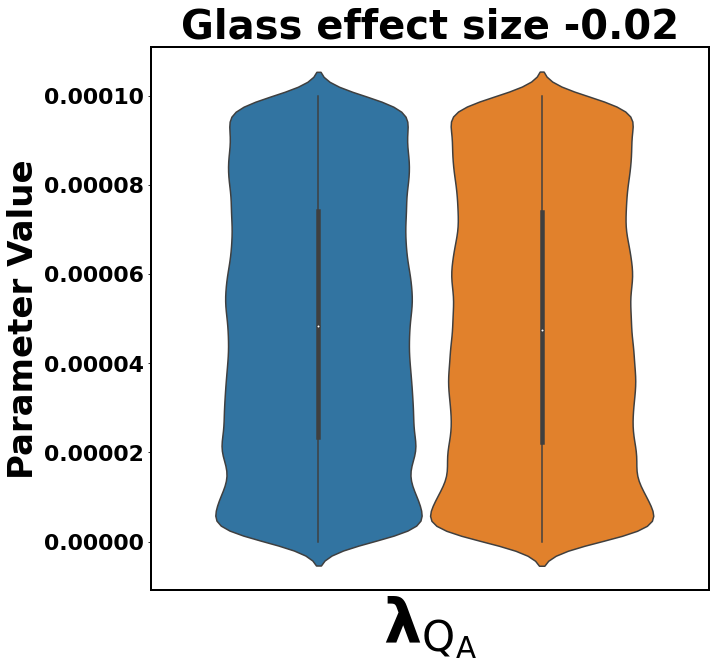

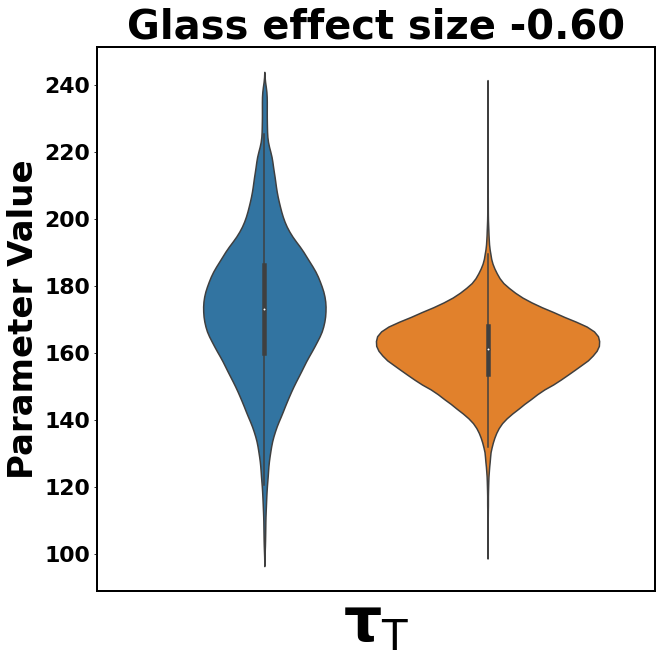

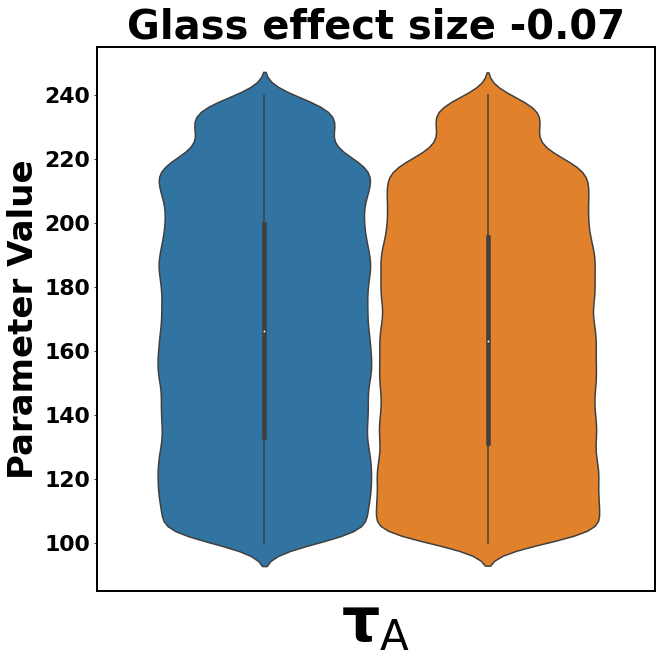

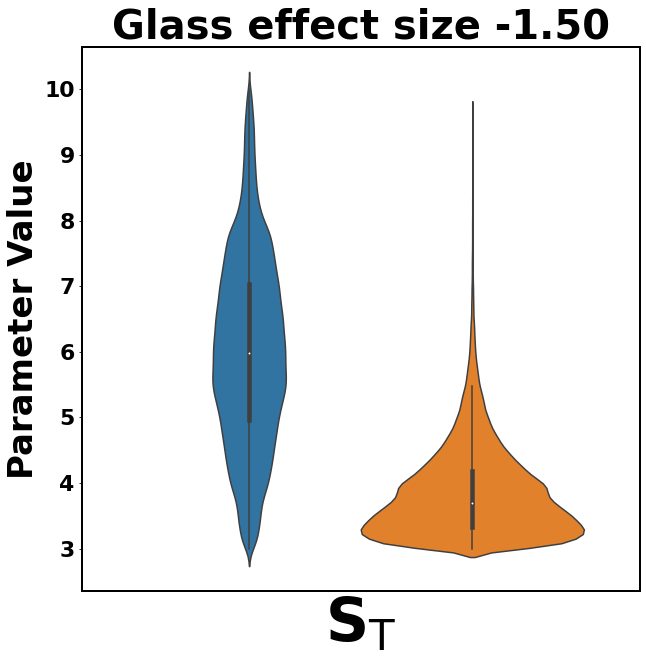

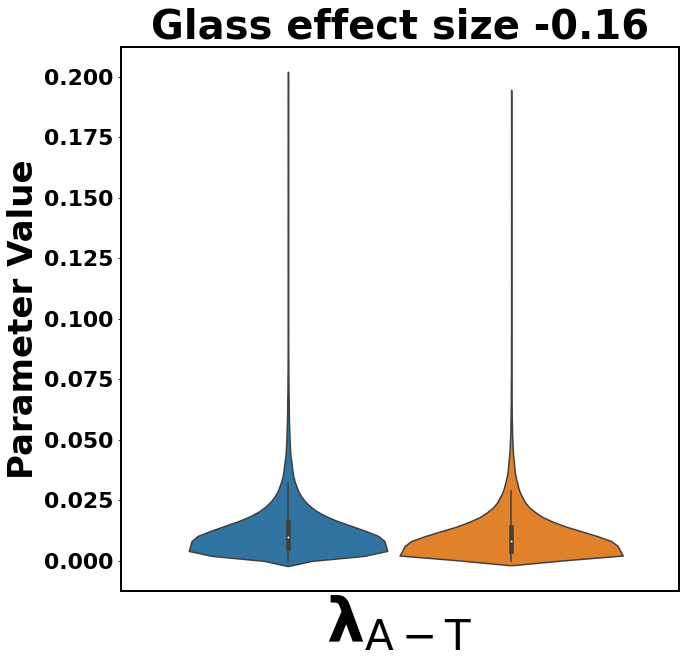

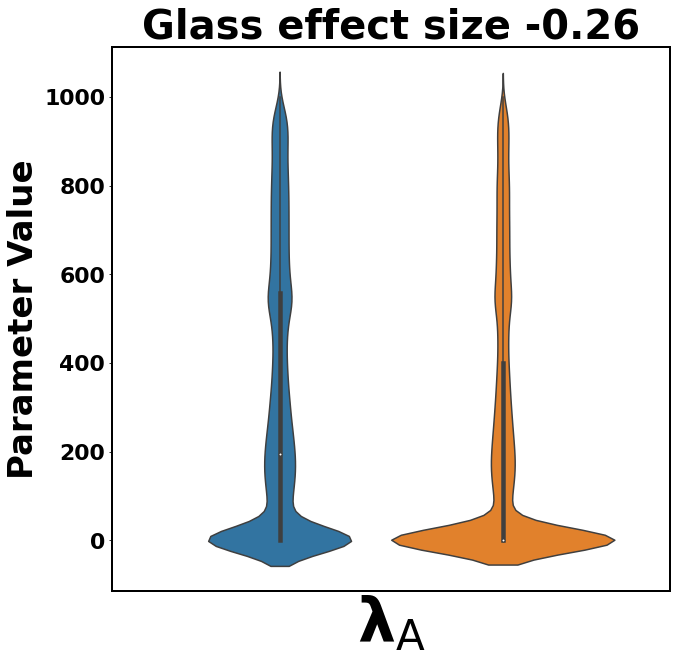

In [74]:
from scipy import stats

for i, label in enumerate(labels2):
    px4 = px3[px3['variable'] == label]
    
    # Split data
    CD_data = px4[px4['Group'] == 'CD']['value'].dropna()
    HC_data = px4[px4['Group'] == 'HC']['value'].dropna()
    
    # Mann-Whitney U test
    stat, p = mannwhitneyu(CD_data, HC_data)
    
    # Glass's effect size (CD vs HC, using HC std)
    mean1 = np.mean(CD_data)
    mean2 = np.mean(HC_data)
    std_hc = np.std(HC_data)
    glass_D = (mean1 - mean2) / std_hc if std_hc != 0 else np.nan

    # ---- CD: KDE mode and ±3σ ----
    kde_cd = stats.gaussian_kde(CD_data)
    x_cd = np.linspace(CD_data.min(), CD_data.max(), 1000)
    y_cd = kde_cd(x_cd)
    CD_mode = x_cd[np.argmax(y_cd)]

    std_cd = np.std(CD_data)
    CD_minus_3std = CD_mode - 3 * std_cd
    CD_plus_3std  = CD_mode + 3 * std_cd

    # ---- HC: KDE mode and ±3σ ----
    kde_hc = stats.gaussian_kde(HC_data)
    x_hc = np.linspace(HC_data.min(), HC_data.max(), 1000)
    y_hc = kde_hc(x_hc)
    HC_mode = x_hc[np.argmax(y_hc)]

    std_hc_group = np.std(HC_data)
    HC_minus_3std = HC_mode - 3 * std_hc_group
    HC_plus_3std  = HC_mode + 3 * std_hc_group

    # ---- Print the results for this variable ----
    print(f"\n===== {label} =====")
    print(f"CD: mode = {CD_mode:.4f}, -3σ = {CD_minus_3std:.4f}, +3σ = {CD_plus_3std:.4f}")
    print(f"HC: mode = {HC_mode:.4f}, -3σ = {HC_minus_3std:.4f}, +3σ = {HC_plus_3std:.4f}")
    
    # ---- Plot (your existing violin plot code) ----
    plt.figure(figsize=(10, 10))
    ax = sns.violinplot(
        px4,
        x="variable",
        y="value",
        hue="Group",
        figsize=(12, 12),
        hue_order=['HC', 'CD']
    )
    ax.legend().set_visible(False)
    plt.ylabel('Parameter Value', fontsize=34)
    plt.xticks([])
    plt.xlabel(f'{label}', fontsize=60)
    plt.title(f'Glass effect size {glass_D:.2f}', fontsize=40)

# Instead of Amortized, lets try Multi-round SNPE

# Multi-round on CD

In [72]:
from sklearn.neighbors import KernelDensity
from scipy.optimize import minimize

def find_multivariate_mode(data_tensor, bandwidth=0.1, kernel='gaussian'):
    # Convert PyTorch tensor to NumPy array for compatibility with KDE
    data_np = data_tensor.numpy()
    
    # Fit the KDE model to the data
    kde = KernelDensity(kernel=kernel, bandwidth=bandwidth)  # Adjust bandwidth if needed
    kde.fit(data_np)

    # Define the PDF function to evaluate the density at any given point
    def pdf(x):
        log_density = kde.score_samples(x.reshape(1, -1))  # Log density for a single point
        return np.exp(log_density)  # Convert log density to regular density

    # Define the negative PDF function for minimization (since we want to maximize PDF)
    def neg_pdf(x):
        return -pdf(x)

    # Use the mean of the data as the initial guess for optimization
    initial_guess = np.mean(data_np, axis=0)

    # Minimize the negative PDF to find the mode
    result = minimize(neg_pdf, initial_guess, method='L-BFGS-B')
    mode = result.x  # This is the mode in NumPy array format

    # Convert mode back to PyTorch tensor
    mode_tensor = torch.tensor(mode, dtype=data_tensor.dtype)
    
    return mode_tensor

In [73]:
from sbi.inference import SNPE, simulate_for_sbi
# Load posterior
# path_to_files = './sbi_resources/'
obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta.size()[0]}_local_nsf_{training_batch_size}_{learning_rate}.pkl')
# obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta.size()[0]}_okay.pkl')
print(obj)
posterior_CD_amort = obj[0]

# Load inference
# inference_path = f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_inference_{all_theta_size}_{training_batch_size}_{learning_rate}.pkl'
# obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_inference_{all_theta.size()[0]}_okay.pkl')
obj = pd.read_pickle(inference_path)
print(obj)
inference = obj[0]

NameError: name 'path_to_files' is not defined

In [ ]:
# If you get errors about Infs or NaNs: https://github.com/sbi-dev/sbi/issues/669
num_rounds = 3
# num_samples = 10000
num_sims = 100
posteriors_CD = []
x_o = torch.from_numpy(cereb_mean_synth)
# x_o = all_x_ds[indices[0:1],:]
proposal = posterior_CD_amort.set_default_x(x_o)

for ii in range(num_rounds):
    if ii == 0:
        num_sims = 50
    else:
        num_sims = 50   
    this_theta, this_x = simulate_for_sbi(FACTS, proposal, num_simulations=num_sims)
    this_x = this_x.view(num_sims, 140).float()
    density_estimator_multi = inference.append_simulations(
        this_theta, this_x, proposal=proposal
    ).train(show_train_summary=True, training_batch_size=32, 
            discard_prior_samples=False, use_combined_loss=True)
    posterior_multi_CD = inference.build_posterior(density_estimator_multi)
    posteriors_CD.append(posterior_multi_CD)
    proposal = posterior_CD_amort.set_default_x(x_o)

In [ ]:
# Save posteriors
with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posteriors_multiround_AUKF_{all_theta.size()[0]}_CD.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([posteriors_CD], f)
    
# # Save the inference
with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_multiround_inference_AUKF_{all_theta.size()[0]}_CD.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([inference], f)

In [ ]:
# Load posterior
print(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_posteriors_multiround_AUKF_{all_theta.size()[0]}_CD.pkl')
obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_posteriors_multiround_AUKF_{all_theta.size()[0]}_CD.pkl')
print(obj)
posterior_CD_SNPE_loaded = obj[-1][-1]
# print(posterior_CD_SNPE_loaded[-1])

# Load inference
obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_multiround_inference_AUKF_{all_theta.size()[0]}_CD.pkl')
print(obj)
inference_loaded = obj[-1]

In [ ]:
samples_cereb_multi = posteriors_CD[-1].sample((1000,), x=cereb_mean_synth)

In [ ]:
# samples_cereb_multi = posterior.sample((sample_size,), x=smoothed_cereb)

# samples_cereb_multi = posterior_multi_CD.sample((100,), x=cereb_mean_synth)
# samples_cereb_multi = posterior_CD_SNPE_loaded.sample((500,), x=cereb_mean_synth)

# posterior_modes_CD = stats.mode(samples_cereb_multi,0)
# posterior_modes_CD = torch.from_numpy(posterior_modes_CD[0][0])

posterior_modes_CD = get_modes(samples_cereb_multi)
# posterior_modes_CD = np.median(samples_cereb_multi, axis=0)
# posterior_modes_CD = np.average(samples_cereb_multi, axis=0)
posterior_modes_CD = torch.from_numpy(posterior_modes_CD)

# Try to find the multivariate optima
# posterior_modes_CD = find_multivariate_mode(samples_cereb_multi, bandwidth=1e5, kernel='epanechnikov')

print(f'poster modes {posterior_modes_CD}')

# posterior_modes_CD_manual_test = all_theta[0,:]
# posterior_modes_CD_manual_test = posterior_modes_CD.detach().clone()
# posterior_modes_CD_manual_test[0] = all_theta[indices[0],0]
# posterior_modes_CD_manual_test[1] = all_theta[indices[0],1]
# posterior_modes_CD_manual_test[2] = all_theta[indices[0],2]
# posterior_modes_CD_manual_test[3] = all_theta[indices[0],3]
# posterior_modes_CD_manual_test[4] = all_theta[indices[0],4]
# posterior_modes_CD_manual_test[5] = all_theta[indices[0],5]
# posterior_modes_CD_manual_test[8] = all_theta[indices[0],8]
# posterior_modes_CD_manual_test[9] = all_theta[indices[0],9]
# # posterior_modes_CD_manual_test[10] = all_theta[indices[0],10]
# posterior_modes_CD_manual_test[13] = all_theta[indices[0],13]
# posterior_modes_CD_manual_test[14] = all_theta[indices[0],14]

# posterior_modes_CD_manual_test = torch.tensor([0.0064778,
#             0.0133751,
#             2.1837397 ,
#             0.0412514 , 
#             0.0000042, 
#             0.0000009 ,
#             170.7348785 ,
#             53.7720184,
#             150,
#             1,
#             8.1499996,
#             1.01,
#             1.01,
#             1.06,
#             100])


# print(f'posterior_modes_C_manual_test {posterior_modes_C_manual_test}')
# posterior_modes_C2 = posterior_modes_CD.clone()
# posterior_modes_C2[3] = posterior_modes_CD_manual_test[3]

best_theta = all_theta[indices[0:1],:]
# Sort by sum
CD_simulations_multi = []
for ii in range(2):
    #pdb.set_trace()
    simulated_formant_CD = FACTS(posterior_modes_CD)
    CD_simulations_multi.append(simulated_formant_CD)
    simulated_formant_manual_test = FACTS(best_theta)
#     simulated_again_best_theta = FACTS(all_theta[indices[0]])
    
    x_time = np.linspace(0,500, num=100)

    
    plt.figure(figsize=(14,10))
    plt.plot(x_time, simulated_formant_CD[40:140], 'orange', label='estimated from posteriors')
    plt.plot(x_time, cereb_mean_synth[40:140], 'k',label='Mean of observed trials')
    plt.plot(x_time, simulated_formant_manual_test[40:140], label='Best theta', color='purple')
    plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='k', alpha=.1)
    plt.plot(x_time, all_x_ds[indices[0:1],40:].T, label='Closest training data', color='red')
#     plt.plot(x_time, simulated_again_best_theta[40:140], label='Simulated again from best theta', color='green')
    
    plt.legend()

    plt.xlabel('Time (ms)')
    plt.ylabel('Formant response (Hz)')
    plt.title('CD Empirical')
    
# print(f'Closest training data posteriors {all_theta[indices[0:1],:]}')
# print(f'% difference in parameter tensors {(posterior_modes_C - best_theta)/best_theta}')


In [ ]:
CD_simulations_np = np.array(CD_simulations_multi)
CD_simulations_np = np.stack(CD_simulations_np)
CD_simulations_np.shape

mean_CD_simulations = np.mean(CD_simulations_np[:,40:140], axis=0)
Sem_CD_simulations = np.std(CD_simulations_np[:,40:140], axis=0) #/ HC_simulations_np.shape[0]


plt.figure(figsize=(14,10))
plt.plot(x_time, cereb_mean_synth[40:140], 'k',label='Mean of observed trials')
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='k', alpha=.1)

plt.plot(x_time, mean_CD_simulations, label='Mean estimated from posteriors', color='orange')
plt.fill_between(x_time, (mean_CD_simulations-Sem_CD_simulations), (mean_CD_simulations+Sem_CD_simulations), color='orange', alpha=.1)


plt.legend()

plt.xlabel('Time (ms)')
plt.ylabel('Formant response (Hz)')
plt.title('CD Empirical')

In [ ]:
# best_theta = all_theta[indices[0:1],:]
# # print(f'Closest training data posteriors {best_theta}')
# # print(f'Posterior parameter value {posterior_modes_CD}')
# # print(f'% difference in parameter tensors {(posterior_modes_CD - best_theta)/best_theta}')

# np.set_printoptions(precision=4)
# pd.set_option('display.float_format', '{:.7f}'.format)

# difference_parameter_tensors = (posterior_modes_CD - best_theta[0]).numpy()
# percent_diff = ( difference_parameter_tensors/best_theta*100).numpy().flatten()

# # difference_parameter_tensors2 = (posterior_modes_CD_manual_test - best_theta[0]).numpy()
# # percent_diff2 = ( difference_parameter_tensors2/best_theta*100).numpy().flatten()

# # print(f'difference_parameter_tensors {difference_parameter_tensors.tolist()} {len(difference_parameter_tensors.tolist())}')
# # print(f'percent_diff {percent_diff} {len(percent_diff)}')
# # print(f'posterior_modes_CD_manual_test {posterior_modes_CD_manual_test} {posterior_modes_CD_manual_test.numpy().tolist()}')
# # print((posterior_modes_CD - best_theta[0]).numpy().tolist())
# this_df = pd.DataFrame({'Parameter label': labels,
#                         'prior_min': prior_min,
#                         'best training theta': best_theta[0].tolist(),
#                        'posterior_modes_CD': posterior_modes_CD.numpy().tolist(),
#                         'manual_test':posterior_modes_CD_manual_test.numpy().flatten().tolist(),
#                         'prior_max': prior_mmax,
#                        'posterior_modes_CD - best_theta': difference_parameter_tensors.tolist(),
# #                         'posterior_modes_CD_manual_test - best_theta / best_theta': percent_diff2,
#                        'Percent diff': percent_diff,
#                        })

# display(this_df)

In [ ]:
# for ii, diff in enumerate(percent_diff):
#     print(difference_parameter_tensors[ii])
#     print(diff)

In [ ]:
print(posterior_modes_CD)
print(best_theta[0])
print((posterior_modes_CD - best_theta[0])/best_theta*100)
print( ( (posterior_modes_CD - best_theta[0])/best_theta*100).numpy().flatten().tolist())
print( len( ( (posterior_modes_CD - best_theta[0])/best_theta*100).numpy().flatten().tolist())) 

# Plot posteriors vs closest training sample

In [ ]:
# Mann-Whitney U test
from numpy.random import seed
from numpy.random import randn
from scipy.stats import mannwhitneyu

px3 = pd.melt(px2, id_vars=['Group'])
display(px3)

for label in labels:
    #plt.figure()
    px4 = px3[px3['variable']==label]
    
    # Calculate Non-parametric diff
    CD_data = px4[px4['Group']=='CD']['value']
    
    # Calculate the KDE
    kde = stats.gaussian_kde(CD_data)
    # Define a range of values over which to evaluate the KDE
    x = np.linspace(CD_data.min(), CD_data.max(), 1000)
    # Evaluate the KDE over the range of values
    y = kde.evaluate(x)

    # Find the x value where the KDE is at its maximum
    CD_mode = x[np.argmax(y)]
    
    plt.figure()
    ax = sns.violinplot(px4, x="variable", y="value", hue="Group",figsize=(20,20), hue_order=['CD'])
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    plt.axhline(y = CD_mode, color = 'r', linestyle = '-') 
    plt.ylabel('Parameter Value')
    plt.xlabel('Parameter')
    
    #Calculate boostrap
    plt.title(f'CD Posterior Dist vs Best training parameter')
    
    
# plt.xticks(range(0,9), labels, rotation='vertical')
# plt.ylabel('Parameter Value')
# plt.xlabel('Parameter')

# Multi-round on HC

In [ ]:
from sbi.inference import SNPE, simulate_for_sbi
# Load posterior
# path_to_files = './sbi_resources/'
obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta.size()[0]}_local_nsf_{training_batch_size}_{learning_rate}.pkl')
# obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_posterior_{all_theta.size()[0]}_okay.pkl')
print(obj)
posterior_amort = obj[0]

# Load inference
# inference_path = f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_inference_{all_theta_size}_{training_batch_size}_{learning_rate}.pkl'
# obj = pd.read_pickle(f'{path_to_files}ModelC_auditory_soma_noise_TSE_ASE_Delay_inference_{all_theta.size()[0]}_okay.pkl')
obj = pd.read_pickle(inference_path)
print(obj)
inference = obj[0]


In [ ]:
num_rounds = 4
num_sims = 100
posteriors_HC = []
x_o = torch.from_numpy(healthy_mean_synth)
proposal = posterior_amort.set_default_x(x_o)

for _ in range(num_rounds):
    if ii == 0:
        num_sims = 100
    else:
        num_sims = 50  
    this_theta, this_x = simulate_for_sbi(FACTS, proposal, num_simulations=num_sims)
    this_x = this_x.view(num_sims, 140).float()
    density_estimator_multi_HC = inference.append_simulations(
    this_theta, this_x, proposal=proposal
    ).train(show_train_summary=True, training_batch_size=32, 
         discard_prior_samples=False)
    posterior_multi_HC = inference.build_posterior(density_estimator_multi_HC)
    posteriors_HC.append(posterior_multi_HC)
    proposal = posterior_multi_HC.set_default_x(x_o)

In [ ]:
posterior_multi_HC = posteriors_HC[-3]

In [ ]:
# Save posteriors
with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posteriors_multiround_AUKF_HC_{all_theta.size()[0]}_{num_rounds}_{training_batch_size}_{learning_rate}.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([posteriors_HC], f)
    

# # Save the inference
with open(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_multiround_inference_AUKF_HC_{all_theta.size()[0]}_{num_rounds}_{training_batch_size}_{learning_rate}.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([inference], f)

In [ ]:
# # Load posterior
# obj = pd.read_pickle(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_posteriors_multiround_AUKF_HC_5.pkl')
# print(obj)
# posterior_HC_amort = obj[0]

# # Load inference
# obj = pd.read_pickle(f'./sbi_resources/ModelC_auditory_soma_noise_TSE_ASE_Delay_multiround_inference_AUKF_HC_5.pkl')
# print(obj)
# inference = obj[0]

In [ ]:
samples_multi_HC = posterior_multi_HC.sample((10000,), x=healthy_mean_synth)

# posterior_modes_HC = stats.mode(samples_multi_HC,0)
# posterior_modes_HC = torch.from_numpy(posterior_modes_HC[0][0])

posterior_modes_HC = get_modes(samples_multi_HC)
# posterior_modes_HC = np.average(samples_multi_HC, axis=0)
# posterior_modes_HC = np.median(samples_multi_HC, axis=0)
posterior_modes_HC = torch.from_numpy(posterior_modes_HC)

print(f'poster modes {posterior_modes_HC}')
# print(f'original theta {0.005, 0.005, 0.01, 0.1, 0.0000001, 0.0000001, 100, 50, 3}')
# pdb.set_trace()
# posterior_modes_HC = find_multivariate_mode(samples_multi_HC, bandwidth=1e-26)



for ii in range(1):
    simulated_formant_H = FACTS(posterior_modes_HC)

    # Plot data
    x_time = np.linspace(0,500, num=100)
    plt.figure(figsize=(14,10))
    plt.plot(x_time, simulated_formant_H[40:140], label='estimated from posteriors')

    plt.plot(x_time, healthy_mean_synth[40:140], 'k',label='Mean of observed trials')
    plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='k', alpha=.1)
#     plt.plot(x_time, all_x_ds[indicesHC[0:1],40:].T, color='red', label='Closest training data')
    plt.legend()

    plt.xlabel('Time (ms)')
    plt.ylabel('Formant response (Hz)')
    plt.title('Healthy Empirical')

# print(f'difference of parameter values = {posterior_modes_HC - posterior_modes_HC_manual_test}')

In [ ]:
x_time = np.linspace(0,500, num=100)

ft_size = 28
font = {'family' : 'normal',
        'weight' : 'normal',
        }

plt.rc('font', **font)
plt.rc('axes', linewidth=2)






plt.figure(figsize=(14,10))
ax = plt.gca()
ax.tick_params(axis='both', which='major', labelsize=ft_size*.8)

plt.plot(x_time, healthy_mean_synth[40:140], 'blue',label='Empirical: Healthy Controls')
plt.plot(x_time, simulated_formant_H[40:140], 'blue', linestyle='--' ,label='SBI posteriors')
plt.fill_between(x_time, (healthy_mean_synth[40:140]-healthy_ci_ds), (healthy_mean_synth[40:140]+healthy_ci_ds), color='blue', alpha=.1)


plt.plot(x_time, cereb_mean_synth[40:140], 'orange',label='Empricial: Cerebellar')
plt.plot(x_time, simulated_formant_CD[40:140], 'orange', linestyle='--' ,label='SBI posteriors')
plt.fill_between(x_time, (cereb_mean_synth[40:140]-cereb_ci_ds), (cereb_mean_synth[40:140]+cereb_ci_ds), color='orange', alpha=.1)

plt.xlabel('Time (ms)',  fontsize=ft_size, fontweight='normal')
plt.ylabel('Formant response (Hz)', fontsize=ft_size, fontweight='normal')

plt.legend(prop={'size': ft_size*.75})
# plt.title('Simulation Based Inference Posteriors Describe\n Differences in HC vs CD Behavior')

# Plot smoothed
# smoothed_cereb = smooth_np_convolve(cereb_mean_synth, 9)
# smoothed_healthy = smooth_np_convolve(healthy_mean_synth, 9)
plt.figure(figsize=(12,8))
plt.plot(x_time, smoothed_healthy[40:140], 'blue',label='Empirical: Healthy Controls')
plt.plot(x_time, simulated_formant_H[40:140], 'blue', linestyle='--' ,label='SBI posteriors')
plt.fill_between(x_time, (smoothed_healthy[40:140]-healthy_ci_ds), (smoothed_healthy[40:140]+healthy_ci_ds), color='blue', alpha=.1)


plt.plot(x_time, smoothed_cereb[40:140], 'orange',label='Empirical: Cerebellar')
plt.plot(x_time, simulated_formant_CD[40:140], 'orange', linestyle='--' ,label='SBI posteriors')
plt.fill_between(x_time, (smoothed_cereb[40:140]-cereb_ci_ds), (smoothed_cereb[40:140]+cereb_ci_ds), color='orange', alpha=.1)

plt.xlabel('Time (ms)')
plt.ylabel('F1 Response (Hz)')

plt.legend(fontsize='small')
plt.title('Simulation Based Inference Posteriors Describe\n Differences in HC vs CD Behavior')

In [ ]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# Append Healthy data
px_healthy = pd.DataFrame(samples_multi_HC).astype("float")
px_healthy.set_axis(labels, axis="columns", inplace=True)
px_healthy["Group"] = "HC"

# Append CD
px = pd.DataFrame(samples_cereb_multi).astype("float")
px.set_axis(labels, axis="columns", inplace=True)
px["Group"] = "CD"

# px2 = px_testFACTS
px2 = pd.concat([px,px_healthy], ignore_index=True)

# g = sns.PairGrid(px2, diag_sharey=False, corner=True, hue="Group", hue_order=['HC','CD'])

# g.map_lower(sns.kdeplot)
# g.map_diag(sns.kdeplot)
# g.add_legend()

In [ ]:
from scipy.stats import mannwhitneyu
px3 = pd.melt(px2, id_vars=['Group'])
display(px3)

for label in labels:
    #plt.figure()
    px4 = px3[px3['variable']==label]
    
    # Calculate Non-parametric diff
    CD_data = px4[px4['Group']=='CD']['value']
    HC_data = px4[px4['Group']=='HC']['value']
    stat, p = mannwhitneyu(CD_data, HC_data)
    #ks_stat, p_ks = stats.ks_2samp(CD_data, HC_data)
    #p_perm = permutation_test(CD_data, HC_data)
    
    # Calculate glass's effects size
    mean1 = np.mean(CD_data)
    mean2 =  np.mean(HC_data)
    std_hc = np.std(px4[px4['Group']=='HC']['value'])
    glass_D = (mean1-mean2) / std_hc
    
    # Get the mode of CD
#     CD_mode = np.median(CD_data)
#     display(CD_mode)
#     perm_pval = permutation_test(HC_data, CD_data, 100)
    # Calculate the KDE
    kde = stats.gaussian_kde(CD_data)
    # Define a range of values over which to evaluate the KDE
    x = np.linspace(CD_data.min(), CD_data.max(), 1000)
    # Evaluate the KDE over the range of values
    y = kde.evaluate(x)

    # Find the x value where the KDE is at its maximum
    CD_mode = x[np.argmax(y)]
    
    plt.figure()
    sns.set(font_scale=1.5)
    sns.set_style("white")
    ax = sns.violinplot(px4, x="variable", y="value", hue="Group",figsize=(20,20), hue_order=['HC','CD'],fontsize=18)
    
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    plt.axhline(y = CD_mode, color = 'r', linestyle = '-') 
    plt.ylabel('Parameter Value')
    plt.xlabel('Parameter')
    
    #Calculate boostrap
    plt.title(f'{label}\n Glass effect size {glass_D:.2f}')
    #plt.title(f'Whitney p-val {p:.4g} \nGlass effect size {glass_D:.2f}\n')
    #plt.title(f'Permutation p-val {p_perm:.4g} \nGlass effect size {glass_D:.2f}\n')
    #plt.title(f'KS p-val {p_ks:.4g} \nGlass effect size {glass_D:.2f}\n')
    

In [ ]:
def permutation_test(x, y, n_permutations=1000):
    # Concatenate the two groups
    combined = np.concatenate([x, y])

    # Calculate observed test statistic (e.g., difference in means)
    #observed_statistic = np.mean(x) - np.mean(y)
    #observed_statistic = np.median(x) - np.median(y)
    #observed_statistic = stats.mode(x)[0][0] - stats.mode(y)[0][0]
    observed_statistic = stats.ks_2samp(x , y)[0]
    #observed_statistic = get_modes(x.to_numpy().reshape(-1,1)) - get_modes(y.to_numpy().reshape(-1,1))
    
    # Initialize an array to store permutation test statistics
    permutation_stats = np.zeros(n_permutations)

    # Perform permutations
    for i in range(n_permutations):
        # Permute the combined data
        permuted_data = np.random.permutation(combined)

        # Split the permuted data into two groups
        permuted_x = permuted_data[:len(x)]
        permuted_y = permuted_data[len(x):]

        # Calculate the test statistic for this permutation
        #permutation_stats[i] = np.mean(permuted_x) - np.mean(permuted_y)
        #permutation_stats[i] = np.median(permuted_x) - np.median(permuted_y)
        #permutation_stats[i] = stats.mode(permuted_x)[0][0] - stats.mode(permuted_y)[0][0]
        permutation_stats[i] = stats.ks_2samp(permuted_x, permuted_y)[0]
        #permutation_stats[i] = get_modes(permuted_x.reshape(-1,1)) - get_modes(permuted_y.reshape(-1,1))

    # Calculate p-value
    p_value = np.mean(np.abs(permutation_stats) >= np.abs(observed_statistic))

    return p_value